<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_10_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

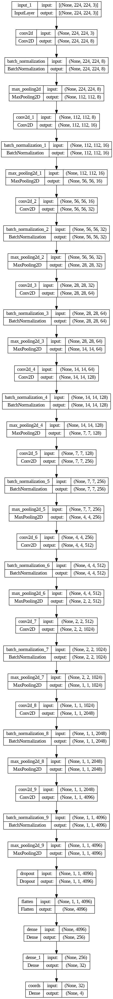

In [18]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True, show_layer_names=True, rankdir='TB', expand_nested=True)

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [24]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 49.9280 - IoU: 0.0094
Epoch 1: val_IoU improved from -inf to 0.00000, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 2s 197ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


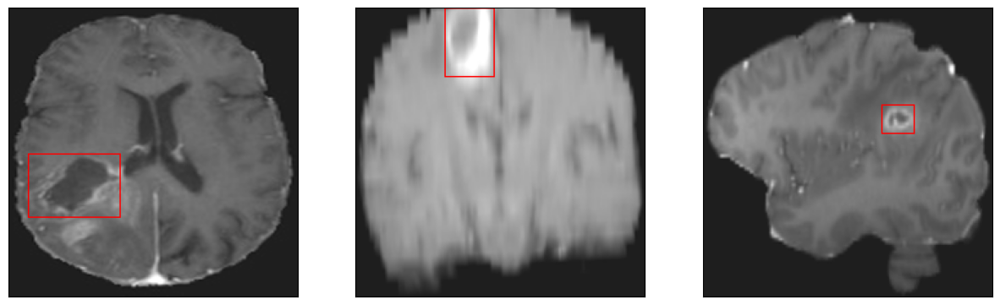

26/26 [==============================] - 43s 810ms/step - loss: 49.9280 - IoU: 0.0094 - val_loss: 632.3722 - val_IoU: 0.0000e+00
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 27.4707 - IoU: 0.0669
Epoch 2: val_IoU improved from 0.00000 to 0.02599, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


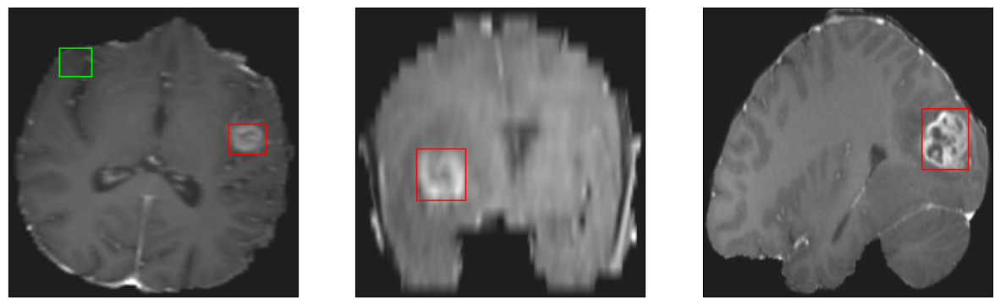

26/26 [==============================] - 23s 890ms/step - loss: 27.4707 - IoU: 0.0669 - val_loss: 120.6248 - val_IoU: 0.0260
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 26.5315 - IoU: 0.0709
Epoch 3: val_IoU did not improve from 0.02599
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


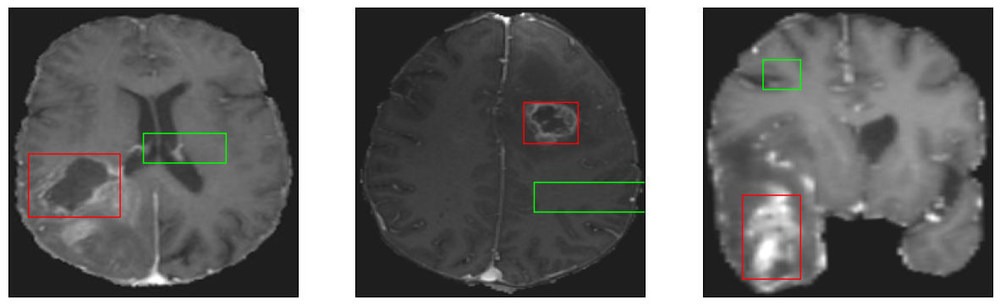

26/26 [==============================] - 8s 312ms/step - loss: 26.5315 - IoU: 0.0709 - val_loss: 71.7316 - val_IoU: 0.0121
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 25.8825 - IoU: 0.0764
Epoch 4: val_IoU improved from 0.02599 to 0.04205, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


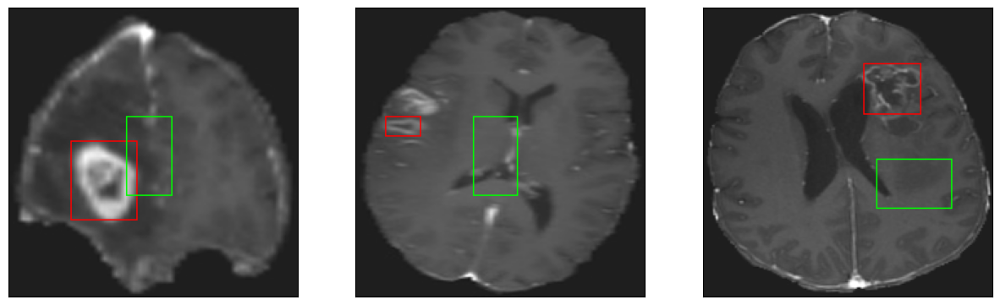

26/26 [==============================] - 20s 794ms/step - loss: 25.8825 - IoU: 0.0764 - val_loss: 46.5333 - val_IoU: 0.0420
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 26.2970 - IoU: 0.0772
Epoch 5: val_IoU improved from 0.04205 to 0.06165, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


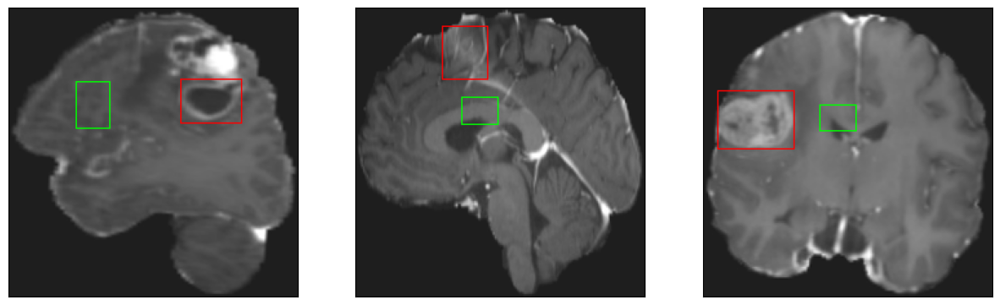

26/26 [==============================] - 16s 611ms/step - loss: 26.2970 - IoU: 0.0772 - val_loss: 29.1176 - val_IoU: 0.0617
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 25.2050 - IoU: 0.0856
Epoch 6: val_IoU improved from 0.06165 to 0.08126, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


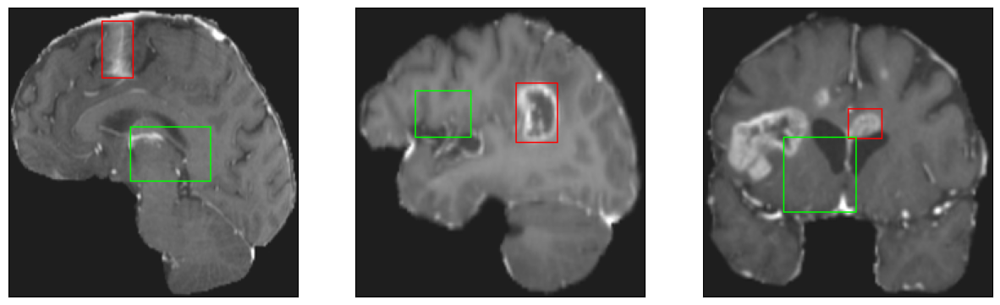

26/26 [==============================] - 15s 610ms/step - loss: 25.2050 - IoU: 0.0856 - val_loss: 24.5594 - val_IoU: 0.0813
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 24.3970 - IoU: 0.0994
Epoch 7: val_IoU did not improve from 0.08126
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


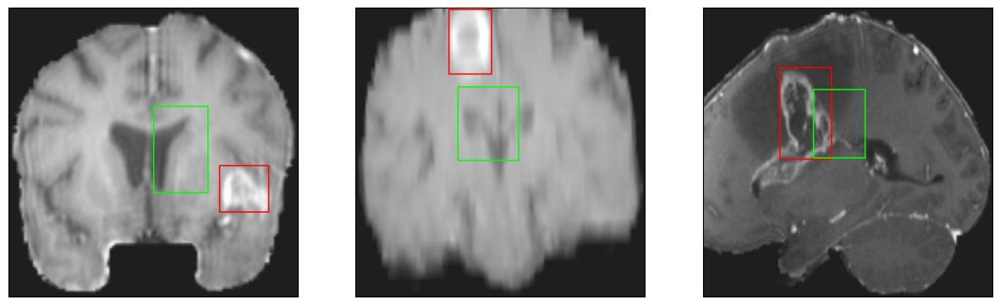

26/26 [==============================] - 7s 276ms/step - loss: 24.3970 - IoU: 0.0994 - val_loss: 25.9517 - val_IoU: 0.0729
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 21.8109 - IoU: 0.1366
Epoch 8: val_IoU did not improve from 0.08126
8/8 [==============================] - 0s 49ms/step
4
8/8 [==============================] - 0s 49ms/step
4
8/8 [==============================] - 0s 45ms/step
4


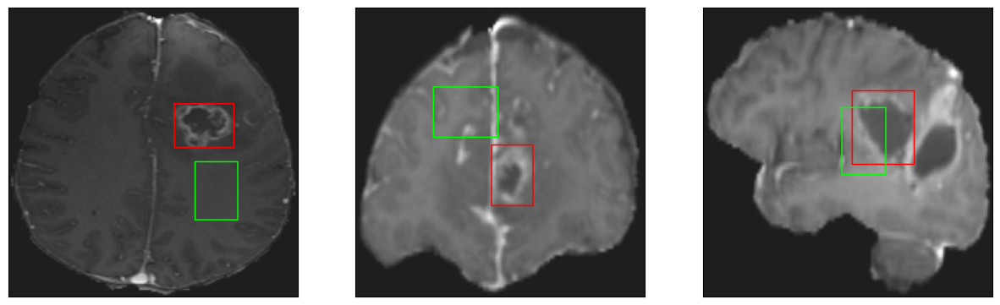

26/26 [==============================] - 8s 317ms/step - loss: 21.8109 - IoU: 0.1366 - val_loss: 26.1301 - val_IoU: 0.0644
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 20.2653 - IoU: 0.1620
Epoch 9: val_IoU improved from 0.08126 to 0.12917, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


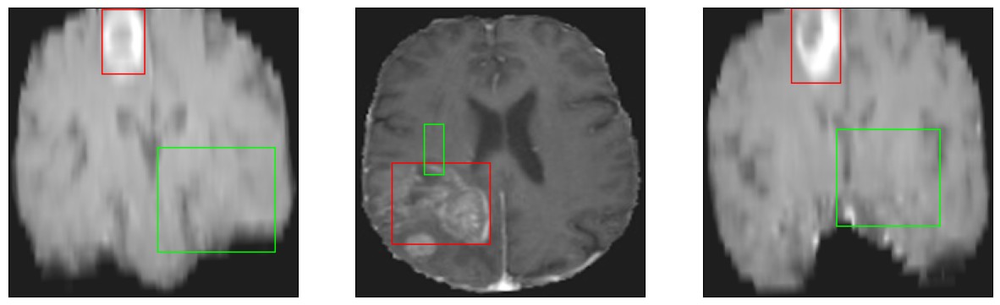

26/26 [==============================] - 25s 1s/step - loss: 20.2653 - IoU: 0.1620 - val_loss: 28.4206 - val_IoU: 0.1292
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 18.0444 - IoU: 0.2072
Epoch 10: val_IoU did not improve from 0.12917
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


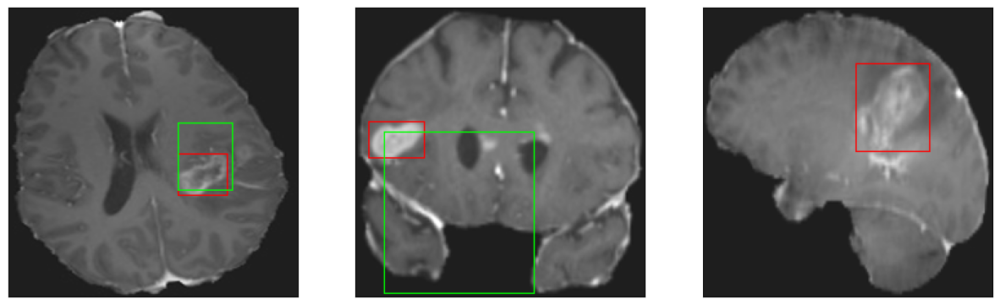

26/26 [==============================] - 7s 277ms/step - loss: 18.0444 - IoU: 0.2072 - val_loss: 87.4518 - val_IoU: 0.0394
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 16.9359 - IoU: 0.2412
Epoch 11: val_IoU improved from 0.12917 to 0.18512, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


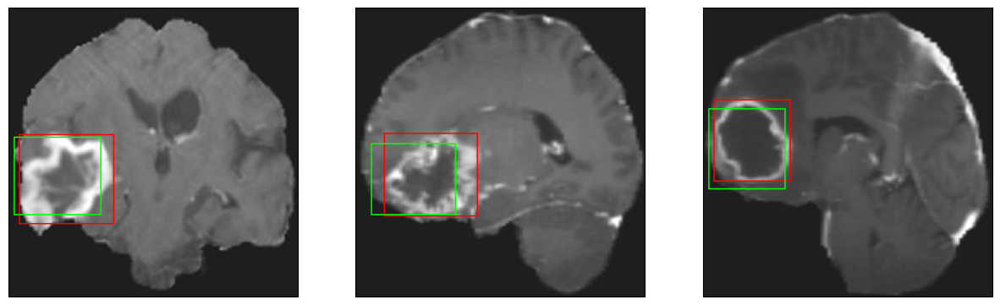

26/26 [==============================] - 32s 1s/step - loss: 16.9359 - IoU: 0.2412 - val_loss: 19.0453 - val_IoU: 0.1851
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 15.6661 - IoU: 0.2664
Epoch 12: val_IoU did not improve from 0.18512
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 47ms/step
4


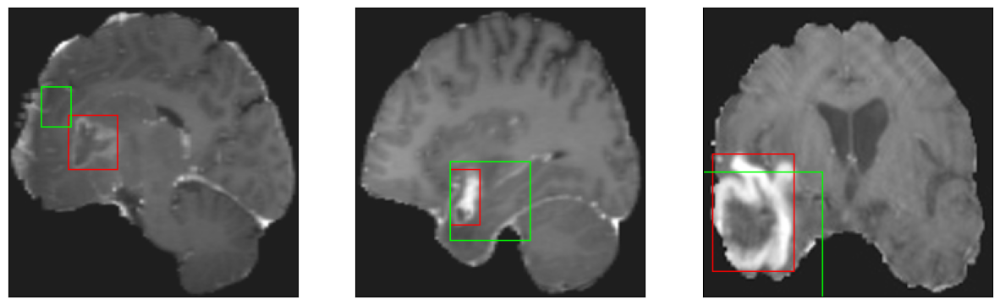

26/26 [==============================] - 8s 325ms/step - loss: 15.6661 - IoU: 0.2664 - val_loss: 37.2724 - val_IoU: 0.1334
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 15.4359 - IoU: 0.2570
Epoch 13: val_IoU did not improve from 0.18512
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


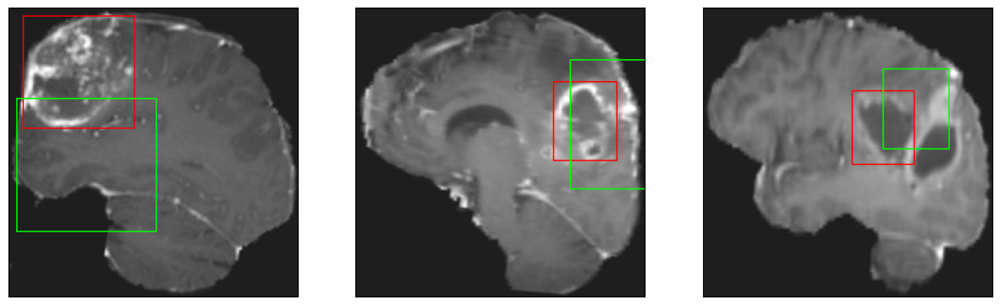

26/26 [==============================] - 7s 278ms/step - loss: 15.4359 - IoU: 0.2570 - val_loss: 36.0943 - val_IoU: 0.1588
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 14.7185 - IoU: 0.2837
Epoch 14: val_IoU improved from 0.18512 to 0.19264, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 49ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


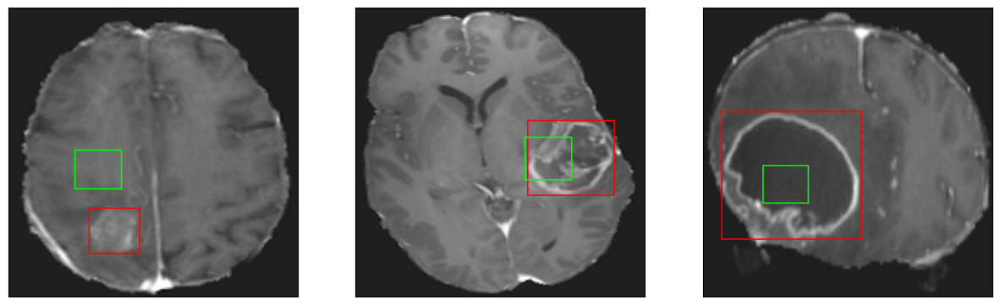

26/26 [==============================] - 25s 977ms/step - loss: 14.7185 - IoU: 0.2837 - val_loss: 17.9332 - val_IoU: 0.1926
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 14.7401 - IoU: 0.2799
Epoch 15: val_IoU did not improve from 0.19264
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 47ms/step
4


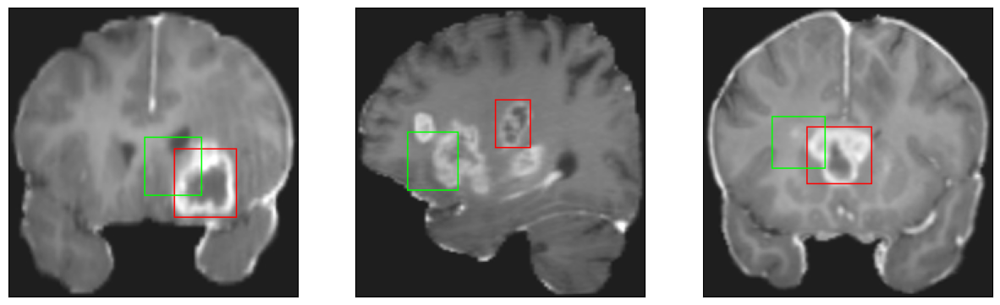

26/26 [==============================] - 8s 299ms/step - loss: 14.7401 - IoU: 0.2799 - val_loss: 22.1849 - val_IoU: 0.1452
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 13.8084 - IoU: 0.3060
Epoch 16: val_IoU improved from 0.19264 to 0.22808, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


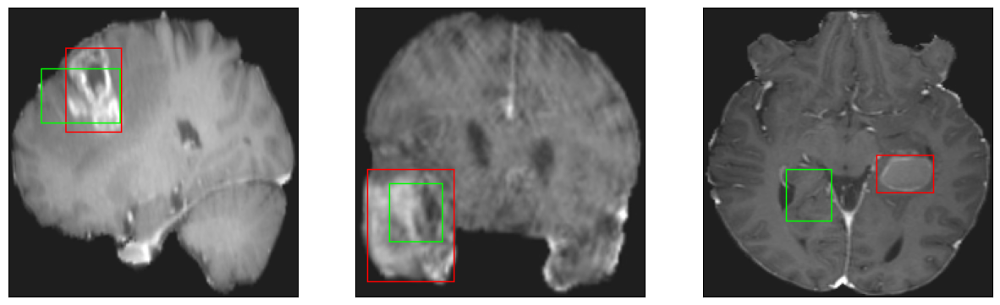

26/26 [==============================] - 20s 801ms/step - loss: 13.8084 - IoU: 0.3060 - val_loss: 17.8366 - val_IoU: 0.2281
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 13.8615 - IoU: 0.3019
Epoch 17: val_IoU improved from 0.22808 to 0.26051, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


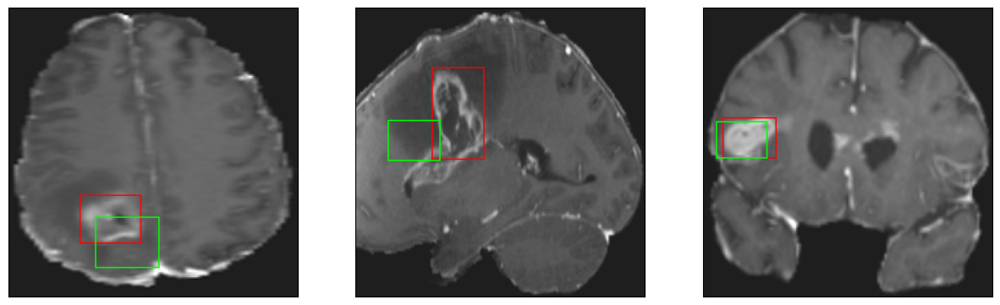

26/26 [==============================] - 15s 580ms/step - loss: 13.8615 - IoU: 0.3019 - val_loss: 16.2317 - val_IoU: 0.2605
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 13.1161 - IoU: 0.3292
Epoch 18: val_IoU did not improve from 0.26051
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4


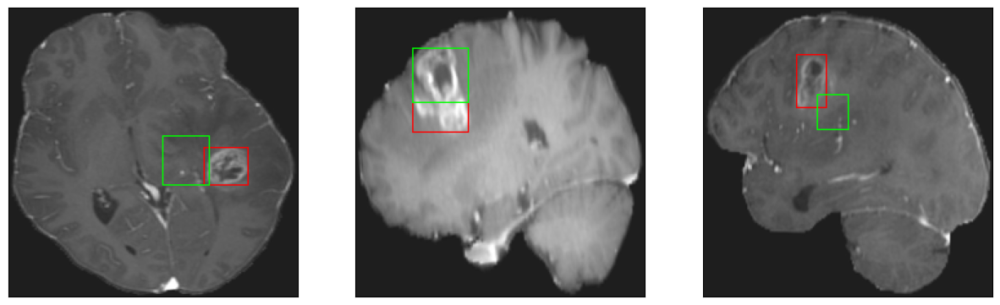

26/26 [==============================] - 8s 296ms/step - loss: 13.1161 - IoU: 0.3292 - val_loss: 16.9874 - val_IoU: 0.2193
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 12.5944 - IoU: 0.3271
Epoch 19: val_IoU improved from 0.26051 to 0.32416, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 45ms/step
4


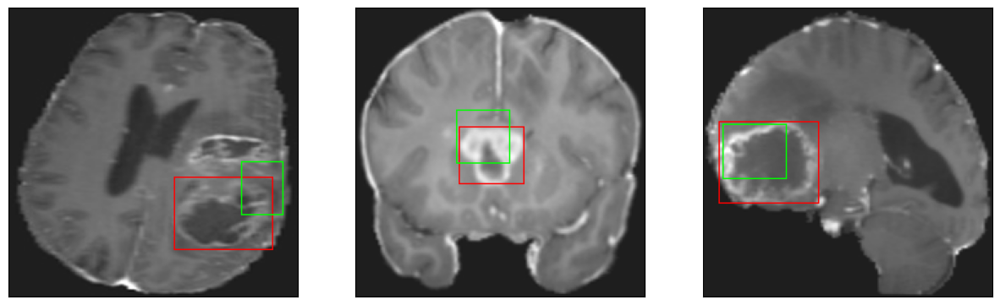

26/26 [==============================] - 15s 579ms/step - loss: 12.5944 - IoU: 0.3271 - val_loss: 14.7017 - val_IoU: 0.3242
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 12.2159 - IoU: 0.3387
Epoch 20: val_IoU did not improve from 0.32416
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 48ms/step
4


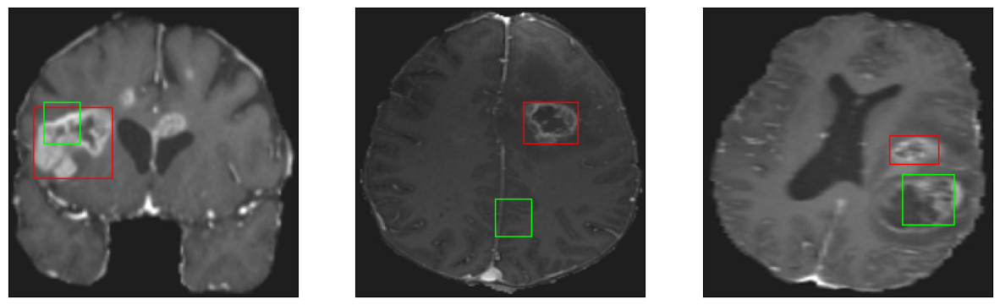

26/26 [==============================] - 8s 313ms/step - loss: 12.2159 - IoU: 0.3387 - val_loss: 16.6848 - val_IoU: 0.2271
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 11.4432 - IoU: 0.3623
Epoch 21: val_IoU did not improve from 0.32416
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


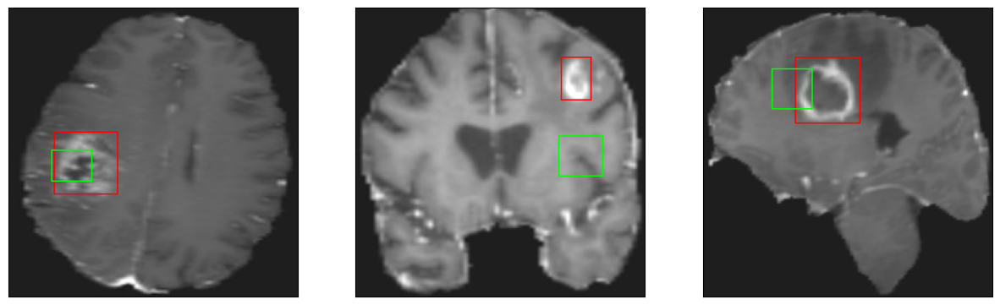

26/26 [==============================] - 8s 302ms/step - loss: 11.4432 - IoU: 0.3623 - val_loss: 18.2213 - val_IoU: 0.1817
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 11.1952 - IoU: 0.3757
Epoch 22: val_IoU did not improve from 0.32416
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


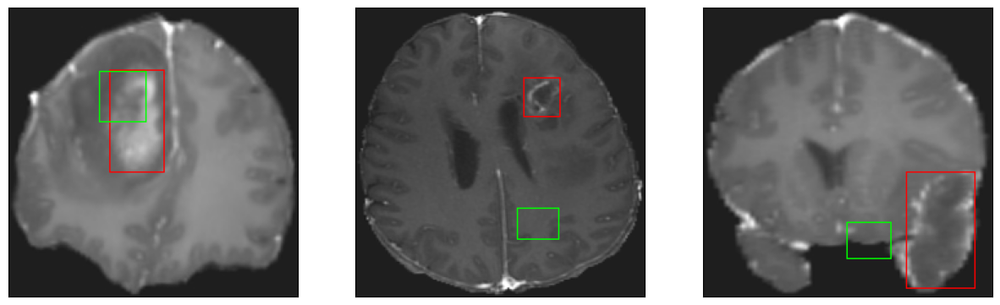

26/26 [==============================] - 8s 290ms/step - loss: 11.1952 - IoU: 0.3757 - val_loss: 14.8422 - val_IoU: 0.2826
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 10.9972 - IoU: 0.3856
Epoch 23: val_IoU improved from 0.32416 to 0.37644, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


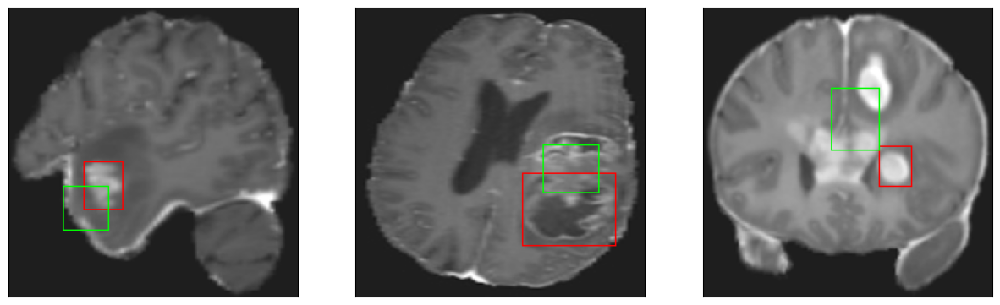

26/26 [==============================] - 21s 837ms/step - loss: 10.9972 - IoU: 0.3856 - val_loss: 11.9466 - val_IoU: 0.3764
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 11.1265 - IoU: 0.3758
Epoch 24: val_IoU did not improve from 0.37644
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4


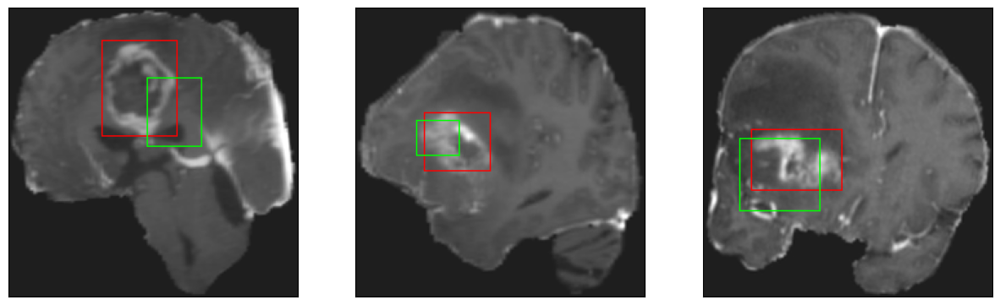

26/26 [==============================] - 8s 303ms/step - loss: 11.1265 - IoU: 0.3758 - val_loss: 12.1297 - val_IoU: 0.3761
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 10.8706 - IoU: 0.3772
Epoch 25: val_IoU did not improve from 0.37644
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


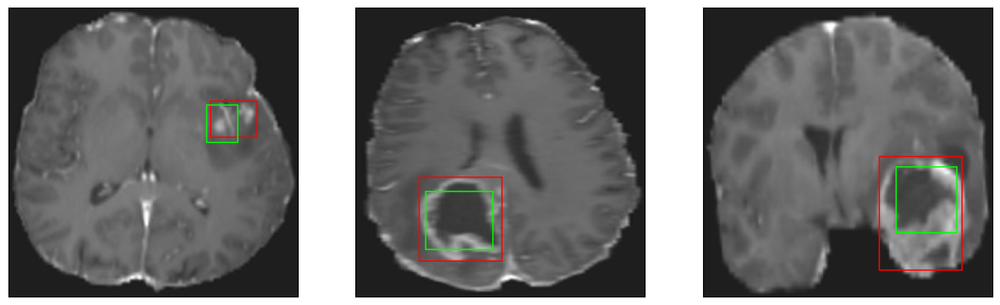

26/26 [==============================] - 7s 290ms/step - loss: 10.8706 - IoU: 0.3772 - val_loss: 13.7439 - val_IoU: 0.2964
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 10.8368 - IoU: 0.3798
Epoch 26: val_IoU did not improve from 0.37644
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


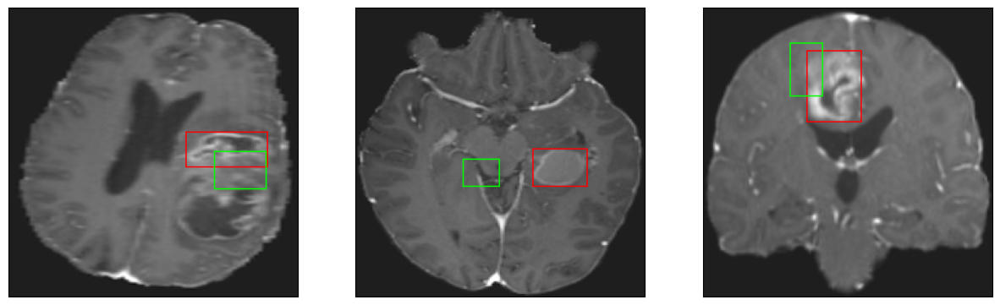

26/26 [==============================] - 8s 294ms/step - loss: 10.8368 - IoU: 0.3798 - val_loss: 13.7242 - val_IoU: 0.2964
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 10.5980 - IoU: 0.3811
Epoch 27: val_IoU did not improve from 0.37644
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


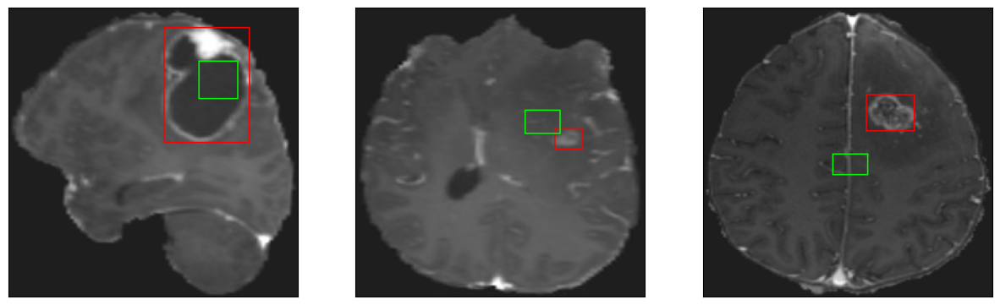

26/26 [==============================] - 8s 296ms/step - loss: 10.5980 - IoU: 0.3811 - val_loss: 16.1397 - val_IoU: 0.2356
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 10.1902 - IoU: 0.4043
Epoch 28: val_IoU did not improve from 0.37644
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


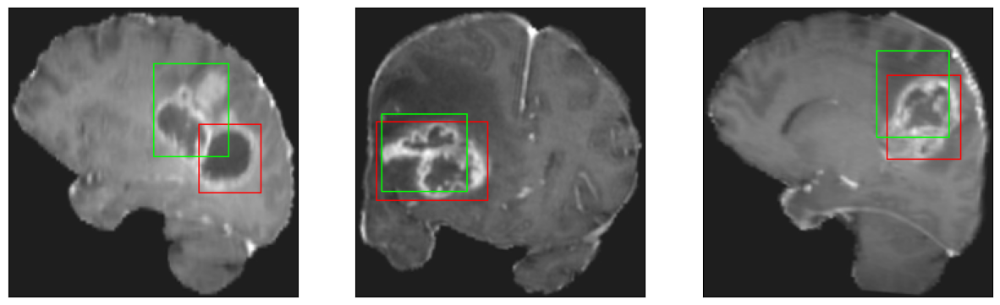

26/26 [==============================] - 8s 293ms/step - loss: 10.1902 - IoU: 0.4043 - val_loss: 12.1483 - val_IoU: 0.3489
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 10.3536 - IoU: 0.3856
Epoch 29: val_IoU did not improve from 0.37644
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


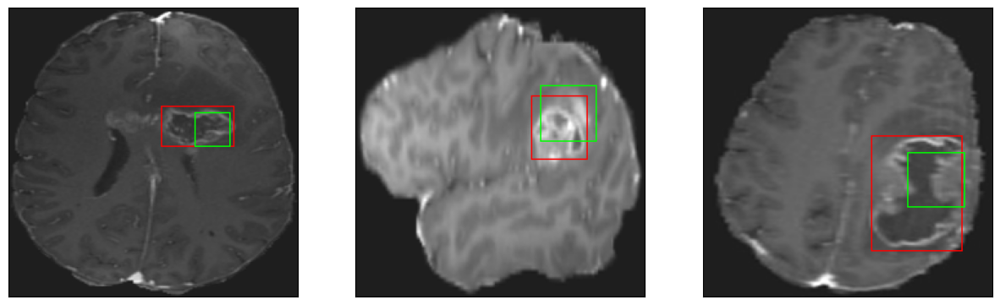

26/26 [==============================] - 7s 286ms/step - loss: 10.3536 - IoU: 0.3856 - val_loss: 11.9505 - val_IoU: 0.3312
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 10.2426 - IoU: 0.3962
Epoch 30: val_IoU improved from 0.37644 to 0.38130, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


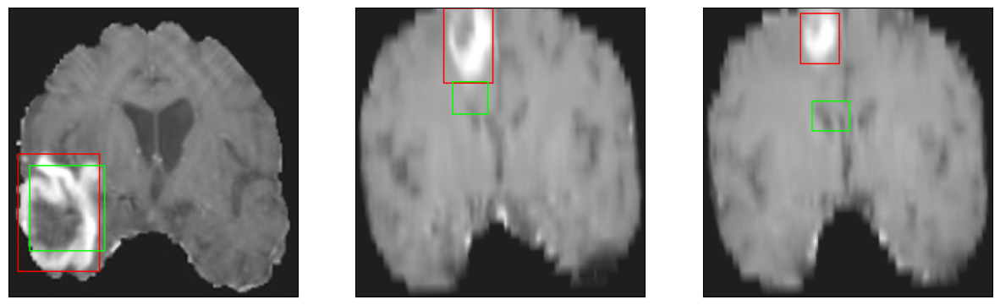

26/26 [==============================] - 25s 1s/step - loss: 10.2426 - IoU: 0.3962 - val_loss: 11.6368 - val_IoU: 0.3813
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 10.4112 - IoU: 0.3873
Epoch 31: val_IoU improved from 0.38130 to 0.38397, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


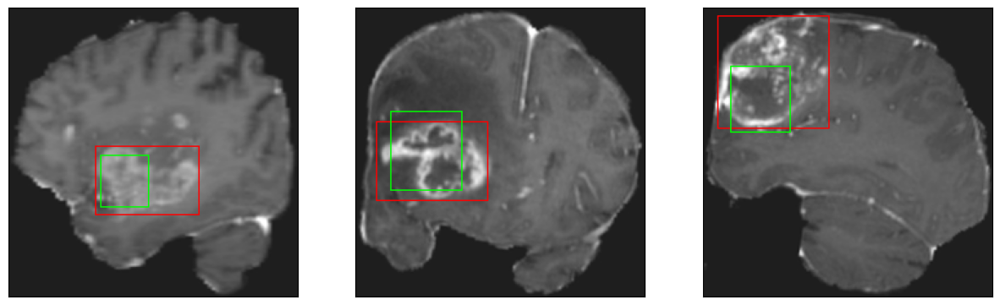

26/26 [==============================] - 14s 542ms/step - loss: 10.4112 - IoU: 0.3873 - val_loss: 11.4612 - val_IoU: 0.3840
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 10.2189 - IoU: 0.3965
Epoch 32: val_IoU did not improve from 0.38397
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 51ms/step
4


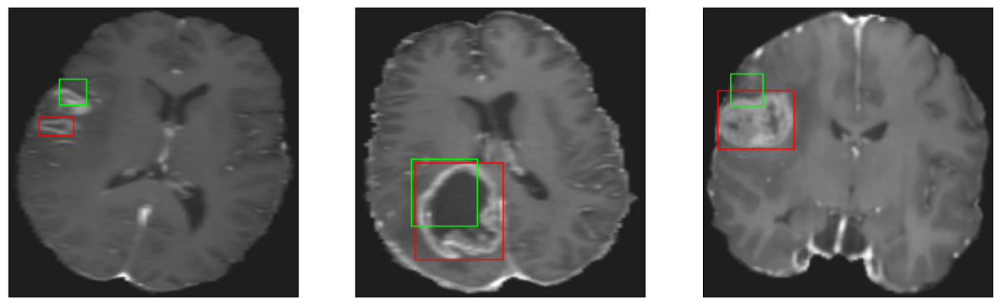

26/26 [==============================] - 9s 344ms/step - loss: 10.2189 - IoU: 0.3965 - val_loss: 13.8924 - val_IoU: 0.2713
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 10.0619 - IoU: 0.3969
Epoch 33: val_IoU improved from 0.38397 to 0.39467, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


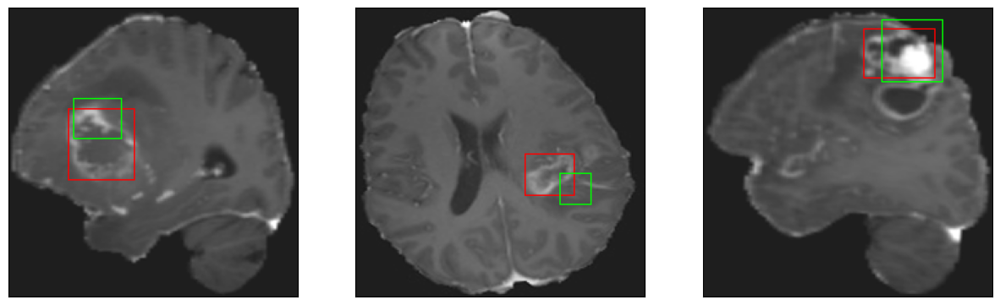

26/26 [==============================] - 20s 796ms/step - loss: 10.0619 - IoU: 0.3969 - val_loss: 10.4178 - val_IoU: 0.3947
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 9.3052 - IoU: 0.4321
Epoch 34: val_IoU improved from 0.39467 to 0.41781, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 46ms/step
4


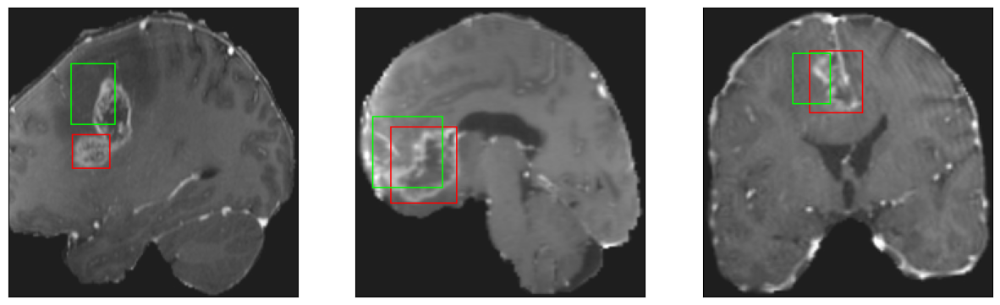

26/26 [==============================] - 22s 876ms/step - loss: 9.3052 - IoU: 0.4321 - val_loss: 10.2945 - val_IoU: 0.4178
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 9.8615 - IoU: 0.4106
Epoch 35: val_IoU did not improve from 0.41781
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


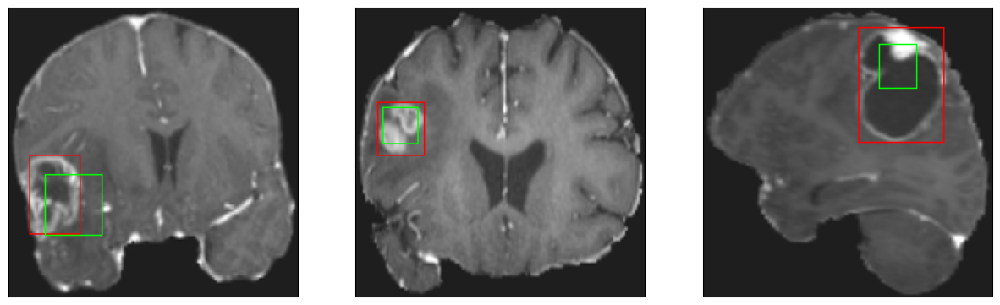

26/26 [==============================] - 8s 305ms/step - loss: 9.8615 - IoU: 0.4106 - val_loss: 11.7358 - val_IoU: 0.3434
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 9.0865 - IoU: 0.4445
Epoch 36: val_IoU did not improve from 0.41781
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


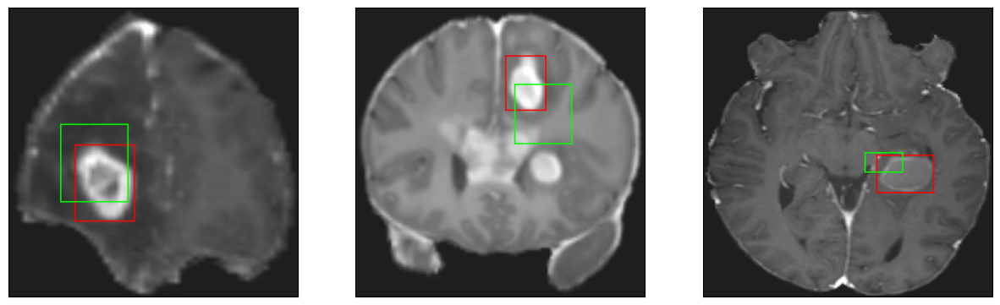

26/26 [==============================] - 8s 293ms/step - loss: 9.0865 - IoU: 0.4445 - val_loss: 10.8032 - val_IoU: 0.3920
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 9.2258 - IoU: 0.4373
Epoch 37: val_IoU improved from 0.41781 to 0.43346, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


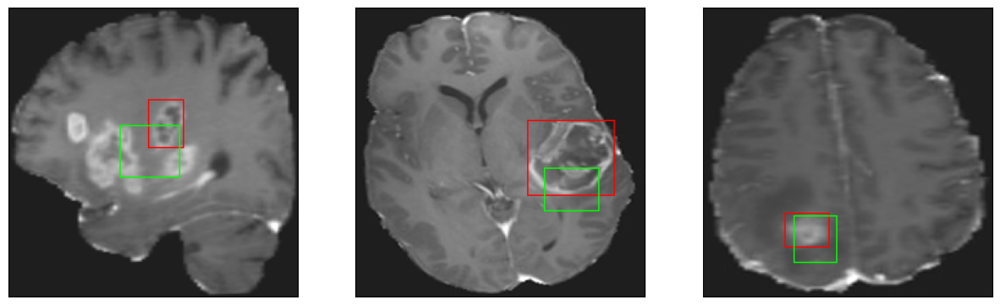

26/26 [==============================] - 34s 1s/step - loss: 9.2258 - IoU: 0.4373 - val_loss: 9.7179 - val_IoU: 0.4335
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 9.3905 - IoU: 0.4265
Epoch 38: val_IoU improved from 0.43346 to 0.43461, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


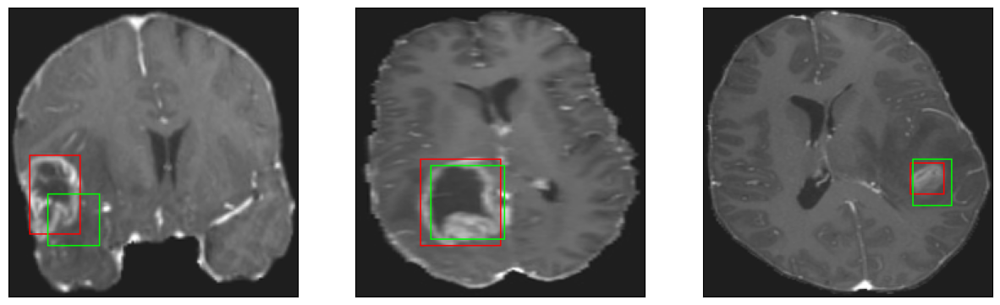

26/26 [==============================] - 25s 981ms/step - loss: 9.3905 - IoU: 0.4265 - val_loss: 10.1213 - val_IoU: 0.4346
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 9.0738 - IoU: 0.4333
Epoch 39: val_IoU did not improve from 0.43461
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


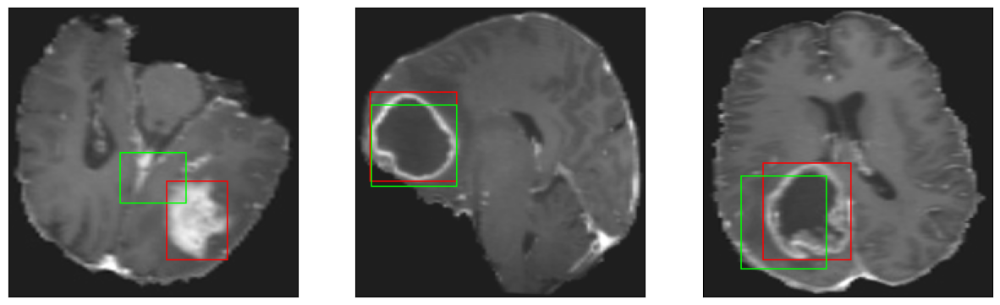

26/26 [==============================] - 8s 313ms/step - loss: 9.0738 - IoU: 0.4333 - val_loss: 11.7631 - val_IoU: 0.3438
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 8.9093 - IoU: 0.4338
Epoch 40: val_IoU did not improve from 0.43461
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


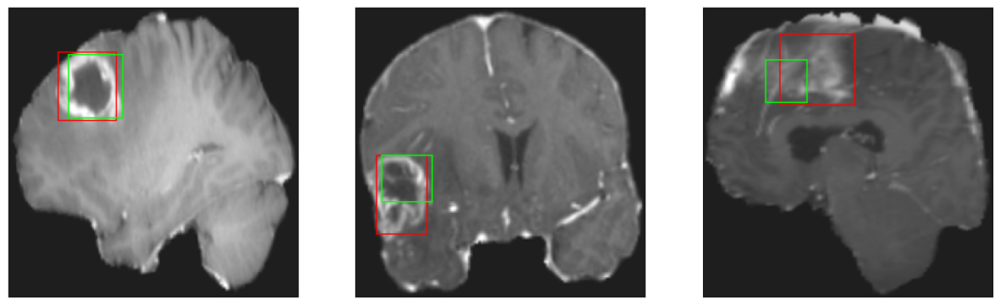

26/26 [==============================] - 8s 316ms/step - loss: 8.9093 - IoU: 0.4338 - val_loss: 10.1350 - val_IoU: 0.4189
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 8.5383 - IoU: 0.4550
Epoch 41: val_IoU did not improve from 0.43461
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


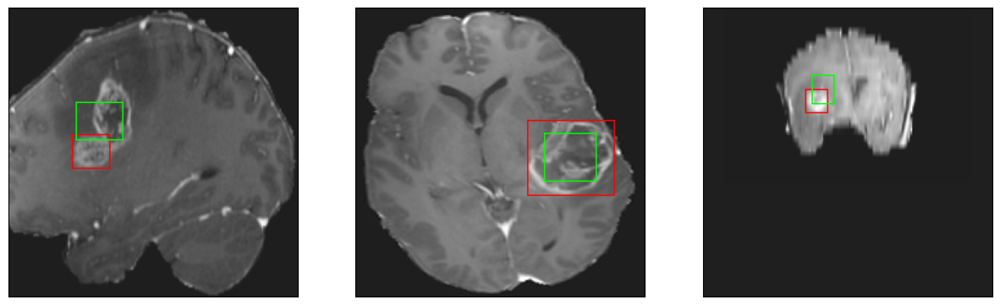

26/26 [==============================] - 7s 276ms/step - loss: 8.5383 - IoU: 0.4550 - val_loss: 10.5056 - val_IoU: 0.4177
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 8.4403 - IoU: 0.4548
Epoch 42: val_IoU improved from 0.43461 to 0.46393, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


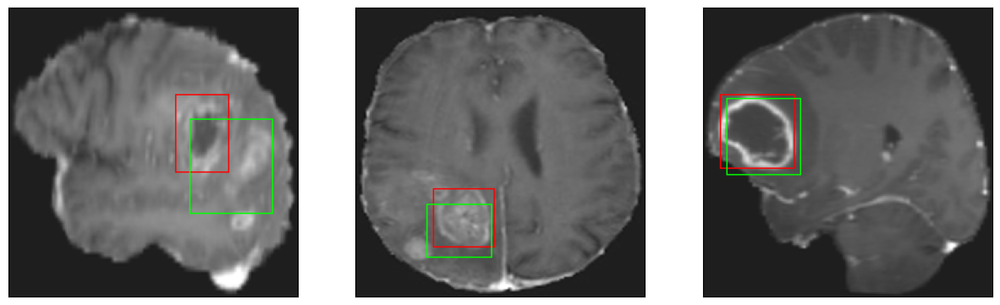

26/26 [==============================] - 25s 1s/step - loss: 8.4403 - IoU: 0.4548 - val_loss: 9.5875 - val_IoU: 0.4639
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 8.7972 - IoU: 0.4476
Epoch 43: val_IoU did not improve from 0.46393
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


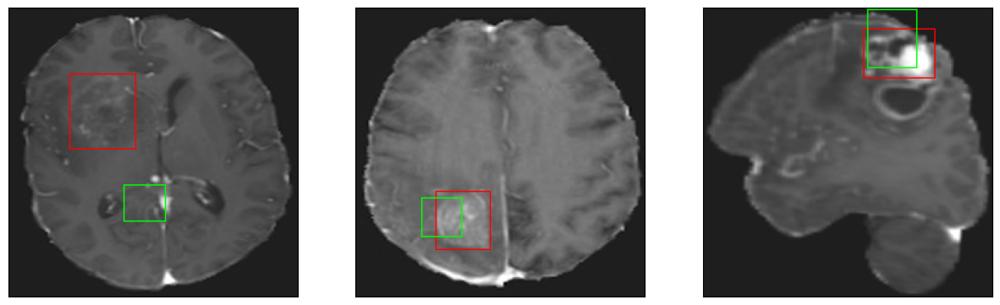

26/26 [==============================] - 8s 312ms/step - loss: 8.7972 - IoU: 0.4476 - val_loss: 10.6666 - val_IoU: 0.3776
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 8.9099 - IoU: 0.4397
Epoch 44: val_IoU did not improve from 0.46393
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


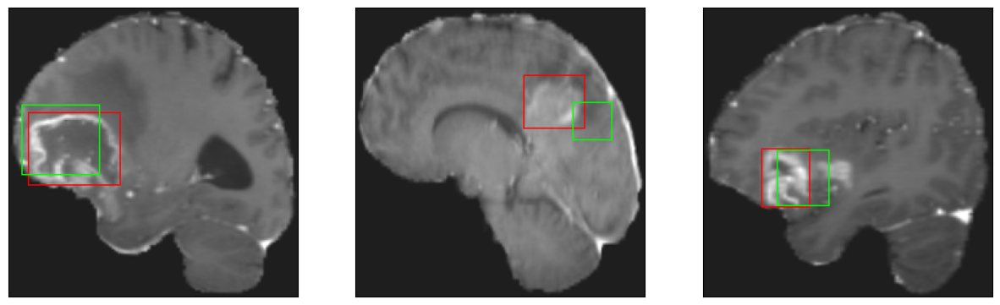

26/26 [==============================] - 8s 300ms/step - loss: 8.9099 - IoU: 0.4397 - val_loss: 10.6429 - val_IoU: 0.4051
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 8.7221 - IoU: 0.4470
Epoch 45: val_IoU did not improve from 0.46393
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


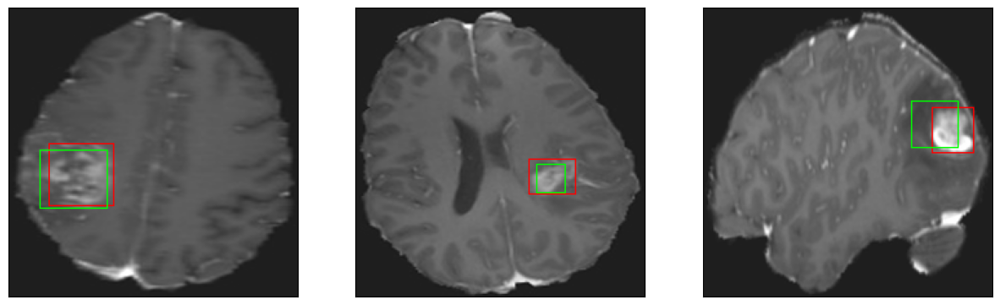

26/26 [==============================] - 8s 296ms/step - loss: 8.7221 - IoU: 0.4470 - val_loss: 10.4526 - val_IoU: 0.4040
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 8.6885 - IoU: 0.4540
Epoch 46: val_IoU did not improve from 0.46393
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4


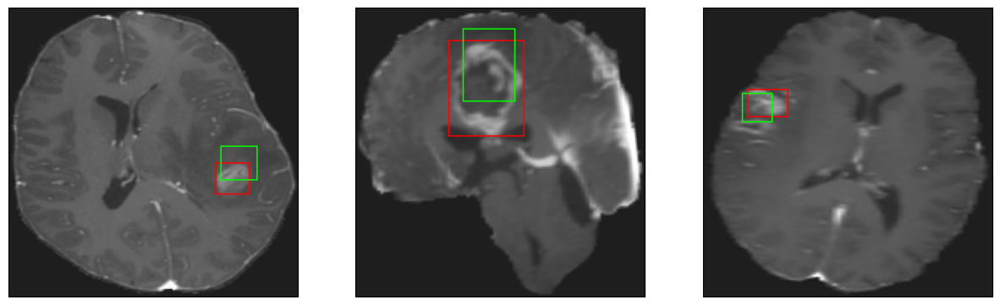

26/26 [==============================] - 8s 299ms/step - loss: 8.6885 - IoU: 0.4540 - val_loss: 10.8200 - val_IoU: 0.3804
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 8.7552 - IoU: 0.4389
Epoch 47: val_IoU did not improve from 0.46393
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


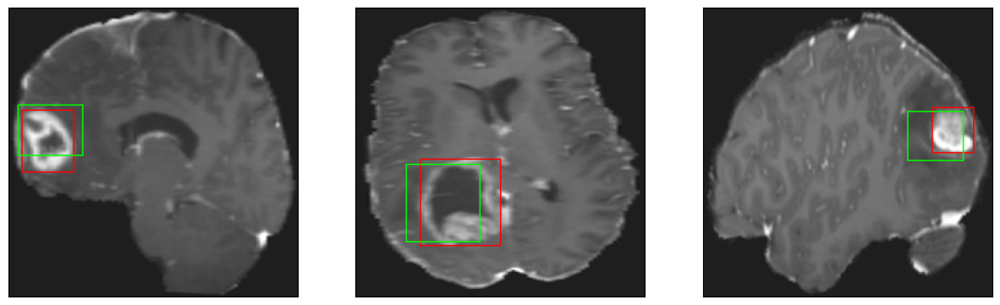

26/26 [==============================] - 8s 311ms/step - loss: 8.7552 - IoU: 0.4389 - val_loss: 10.0424 - val_IoU: 0.4043
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 8.6013 - IoU: 0.4495
Epoch 48: val_IoU did not improve from 0.46393
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 45ms/step
4


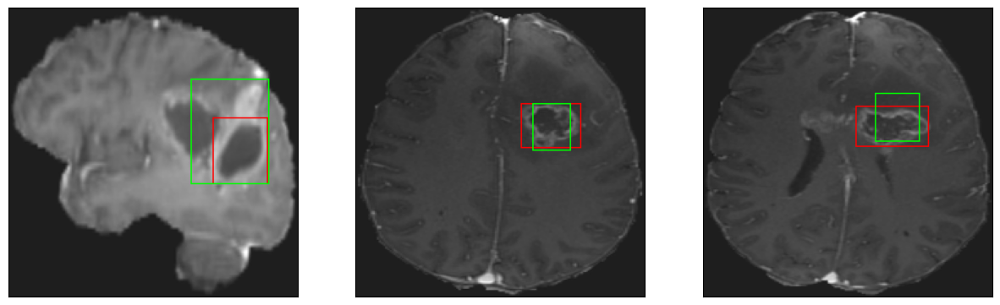

26/26 [==============================] - 8s 316ms/step - loss: 8.6013 - IoU: 0.4495 - val_loss: 10.4621 - val_IoU: 0.4027
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 8.1774 - IoU: 0.4697
Epoch 49: val_IoU did not improve from 0.46393
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


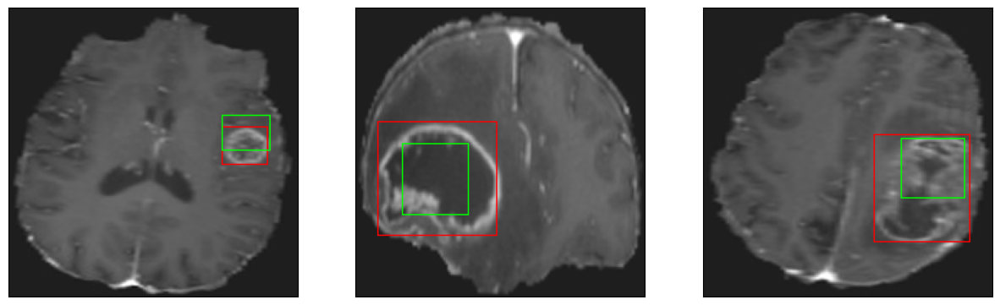

26/26 [==============================] - 8s 299ms/step - loss: 8.1774 - IoU: 0.4697 - val_loss: 10.8677 - val_IoU: 0.3842
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 8.6344 - IoU: 0.4547
Epoch 50: val_IoU improved from 0.46393 to 0.47428, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


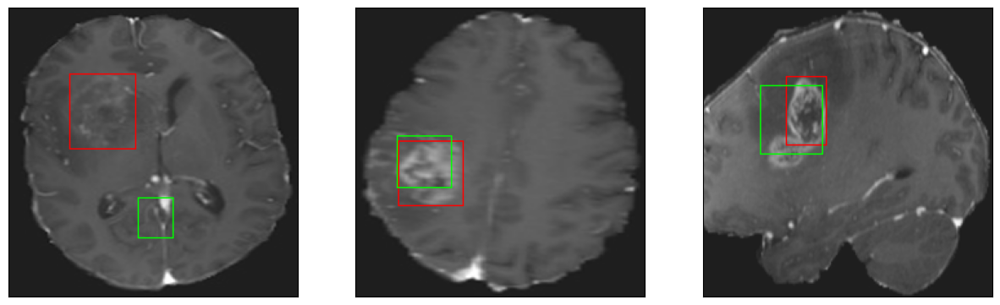

26/26 [==============================] - 29s 1s/step - loss: 8.6344 - IoU: 0.4547 - val_loss: 9.3350 - val_IoU: 0.4743
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 8.0765 - IoU: 0.4792
Epoch 51: val_IoU did not improve from 0.47428
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 47ms/step
4


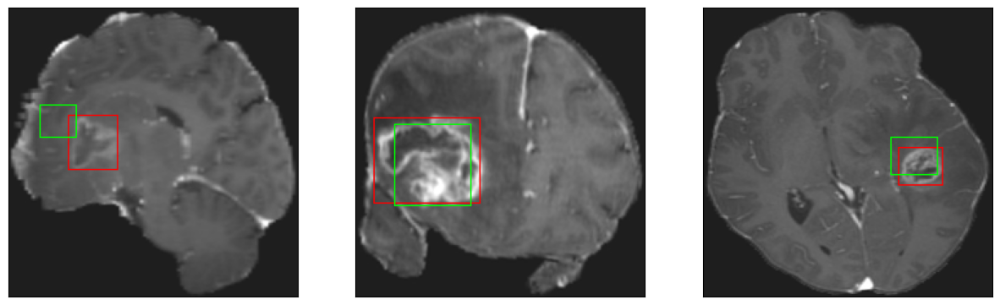

26/26 [==============================] - 9s 343ms/step - loss: 8.0765 - IoU: 0.4792 - val_loss: 9.7432 - val_IoU: 0.4456
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 7.9527 - IoU: 0.4881
Epoch 52: val_IoU did not improve from 0.47428
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


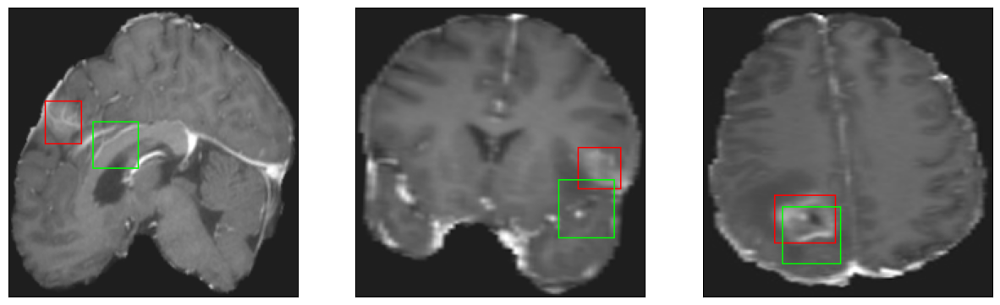

26/26 [==============================] - 7s 280ms/step - loss: 7.9527 - IoU: 0.4881 - val_loss: 9.6998 - val_IoU: 0.4685
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 8.2039 - IoU: 0.4655
Epoch 53: val_IoU improved from 0.47428 to 0.48566, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


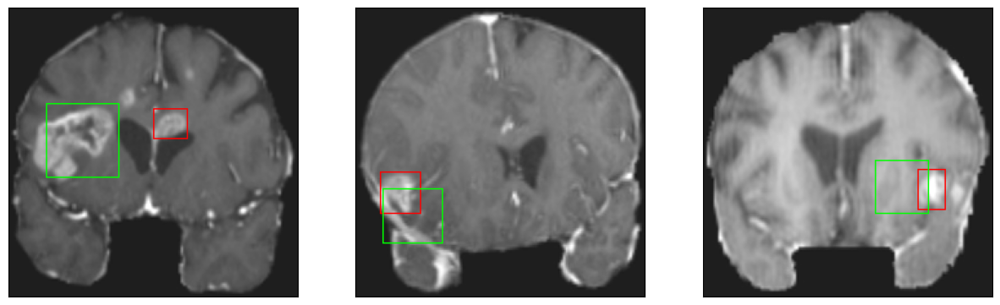

26/26 [==============================] - 32s 1s/step - loss: 8.2039 - IoU: 0.4655 - val_loss: 8.9954 - val_IoU: 0.4857
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 8.0416 - IoU: 0.4795
Epoch 54: val_IoU did not improve from 0.48566
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


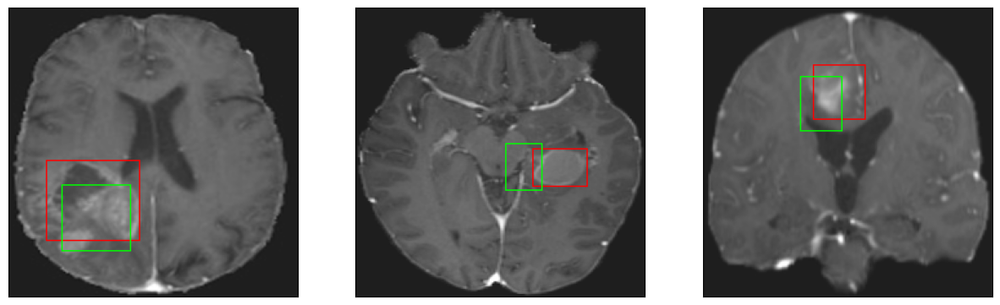

26/26 [==============================] - 8s 321ms/step - loss: 8.0416 - IoU: 0.4795 - val_loss: 10.8586 - val_IoU: 0.4138
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 8.3304 - IoU: 0.4669
Epoch 55: val_IoU did not improve from 0.48566
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


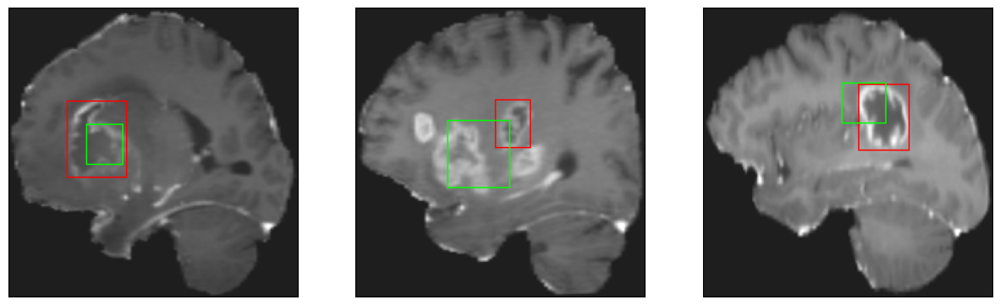

26/26 [==============================] - 8s 299ms/step - loss: 8.3304 - IoU: 0.4669 - val_loss: 11.4343 - val_IoU: 0.3770
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 8.3343 - IoU: 0.4619
Epoch 56: val_IoU did not improve from 0.48566
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


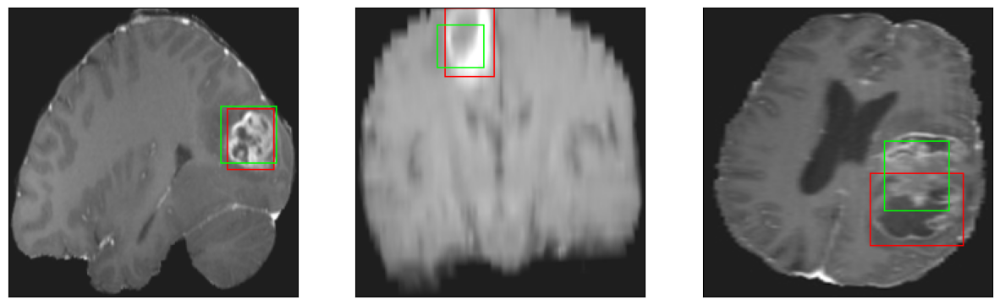

26/26 [==============================] - 8s 303ms/step - loss: 8.3343 - IoU: 0.4619 - val_loss: 9.5718 - val_IoU: 0.4607
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 7.9134 - IoU: 0.4785
Epoch 57: val_IoU did not improve from 0.48566
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


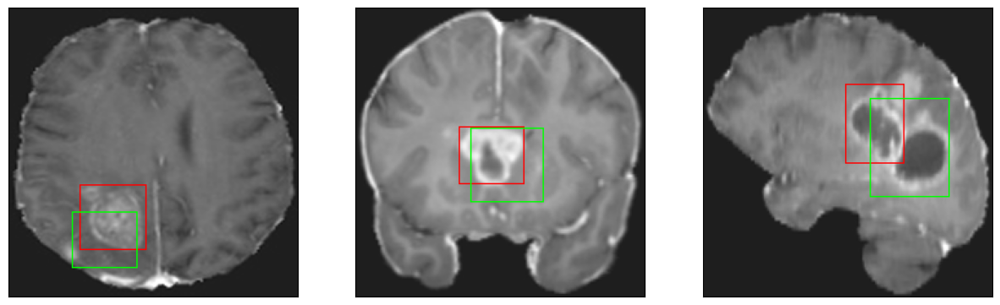

26/26 [==============================] - 8s 294ms/step - loss: 7.9134 - IoU: 0.4785 - val_loss: 9.0128 - val_IoU: 0.4713
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 7.9384 - IoU: 0.4769
Epoch 58: val_IoU did not improve from 0.48566
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


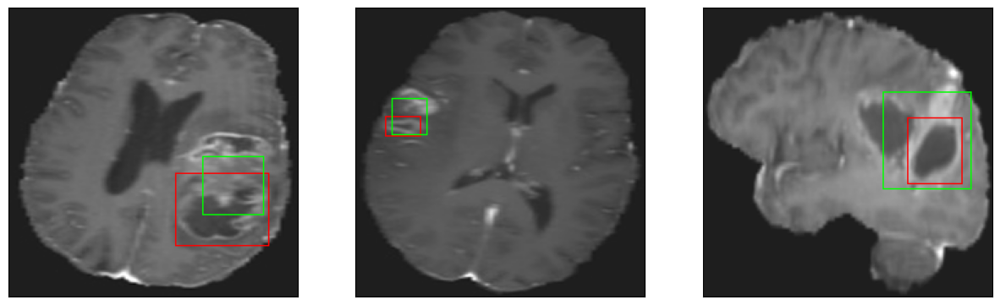

26/26 [==============================] - 8s 290ms/step - loss: 7.9384 - IoU: 0.4769 - val_loss: 9.1764 - val_IoU: 0.4799
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 7.8532 - IoU: 0.4858
Epoch 59: val_IoU did not improve from 0.48566
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


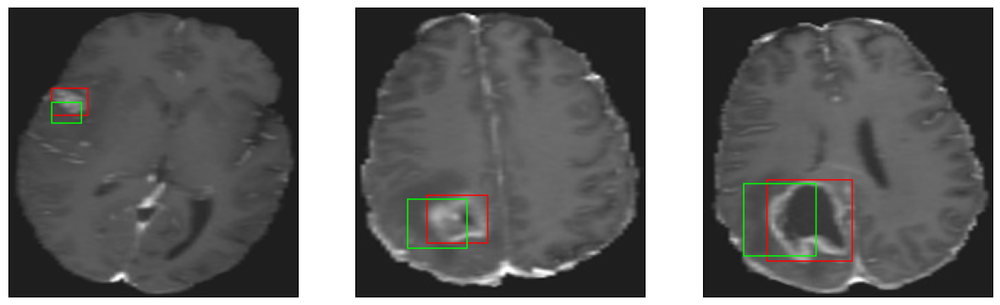

26/26 [==============================] - 8s 314ms/step - loss: 7.8532 - IoU: 0.4858 - val_loss: 9.6197 - val_IoU: 0.4433
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 7.9907 - IoU: 0.4726
Epoch 60: val_IoU did not improve from 0.48566
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


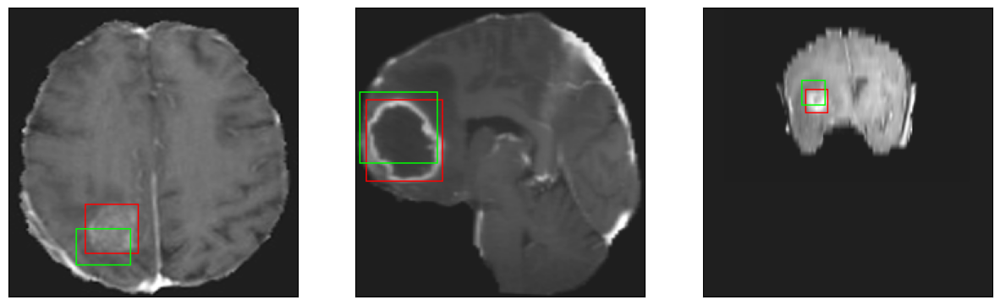

26/26 [==============================] - 8s 306ms/step - loss: 7.9907 - IoU: 0.4726 - val_loss: 9.6510 - val_IoU: 0.4512
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 7.6616 - IoU: 0.4865
Epoch 61: val_IoU improved from 0.48566 to 0.50427, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


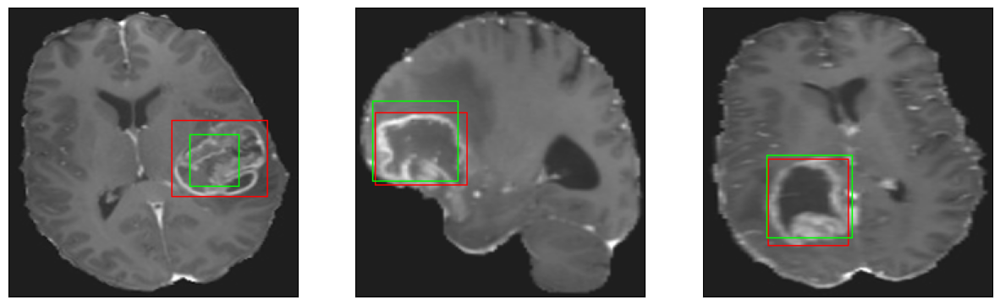

26/26 [==============================] - 26s 1s/step - loss: 7.6616 - IoU: 0.4865 - val_loss: 8.4169 - val_IoU: 0.5043
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 7.6025 - IoU: 0.4866
Epoch 62: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


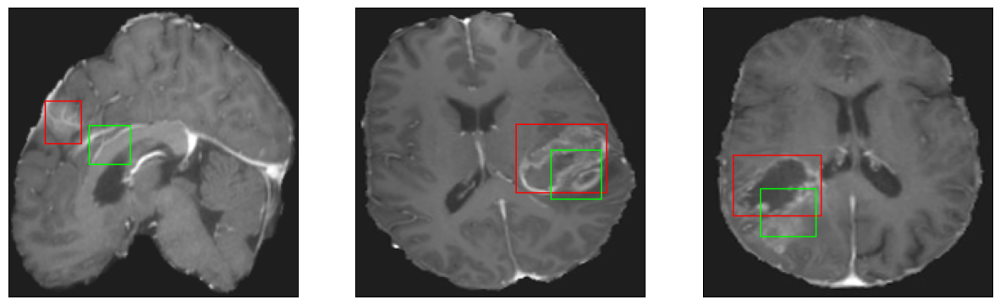

26/26 [==============================] - 8s 314ms/step - loss: 7.6025 - IoU: 0.4866 - val_loss: 9.2539 - val_IoU: 0.4648
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 8.2110 - IoU: 0.4650
Epoch 63: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


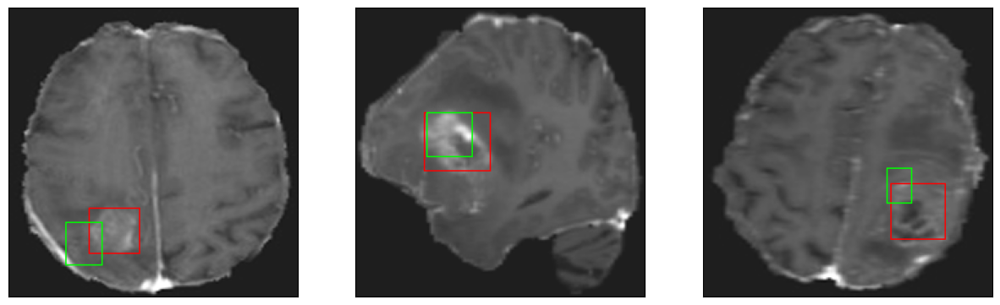

26/26 [==============================] - 7s 281ms/step - loss: 8.2110 - IoU: 0.4650 - val_loss: 9.1388 - val_IoU: 0.4863
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 7.6064 - IoU: 0.4916
Epoch 64: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


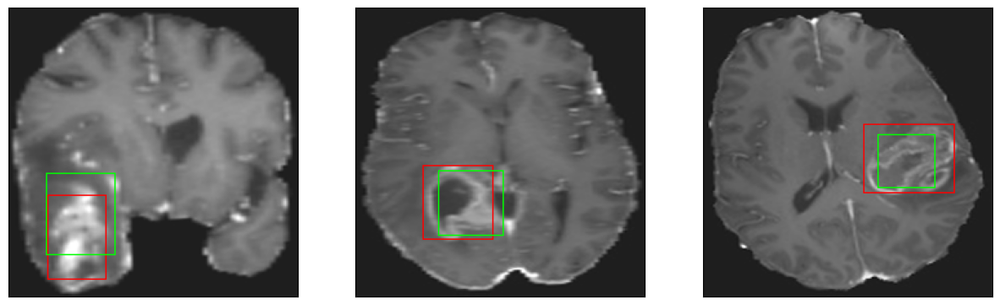

26/26 [==============================] - 8s 298ms/step - loss: 7.6064 - IoU: 0.4916 - val_loss: 8.8508 - val_IoU: 0.4935
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 7.2220 - IoU: 0.5125
Epoch 65: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


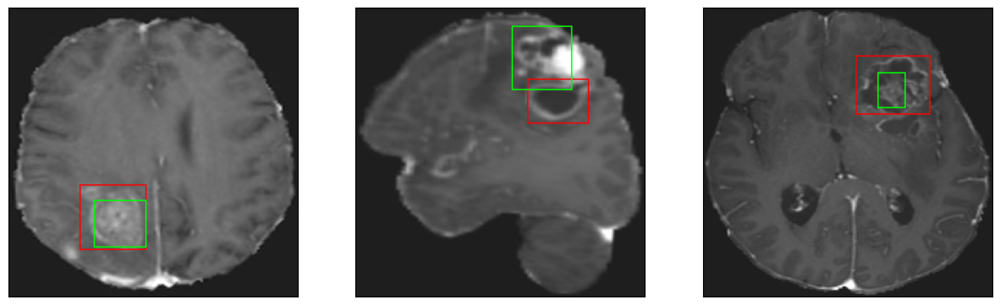

26/26 [==============================] - 8s 305ms/step - loss: 7.2220 - IoU: 0.5125 - val_loss: 9.0229 - val_IoU: 0.4661
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 7.5558 - IoU: 0.4986
Epoch 66: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


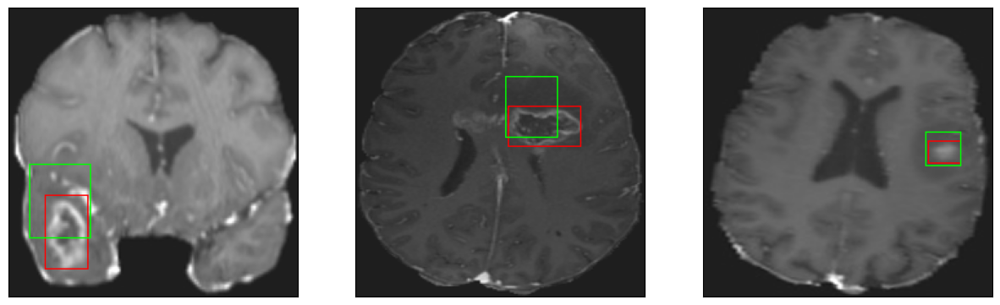

26/26 [==============================] - 8s 312ms/step - loss: 7.5558 - IoU: 0.4986 - val_loss: 9.8709 - val_IoU: 0.4521
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 7.7371 - IoU: 0.4915
Epoch 67: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4


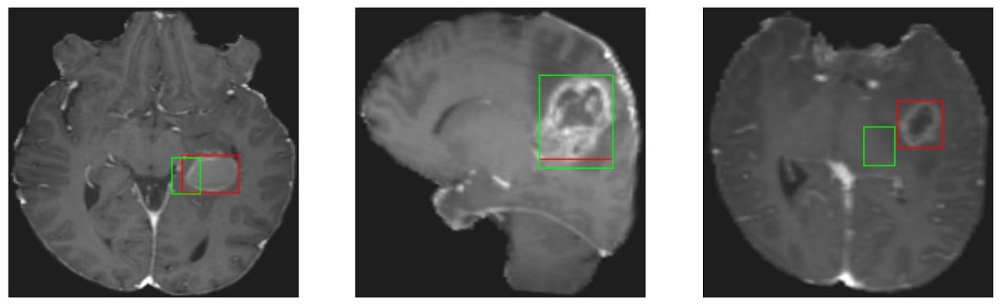

26/26 [==============================] - 8s 296ms/step - loss: 7.7371 - IoU: 0.4915 - val_loss: 8.9234 - val_IoU: 0.4771
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 7.5455 - IoU: 0.4992
Epoch 68: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


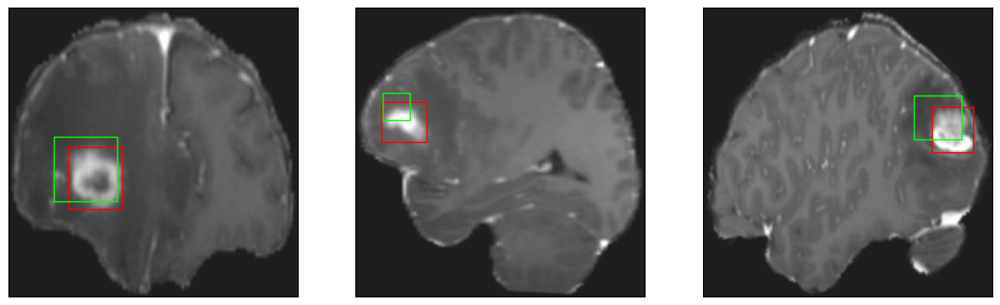

26/26 [==============================] - 8s 319ms/step - loss: 7.5455 - IoU: 0.4992 - val_loss: 9.8215 - val_IoU: 0.4247
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 7.1994 - IoU: 0.5125
Epoch 69: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


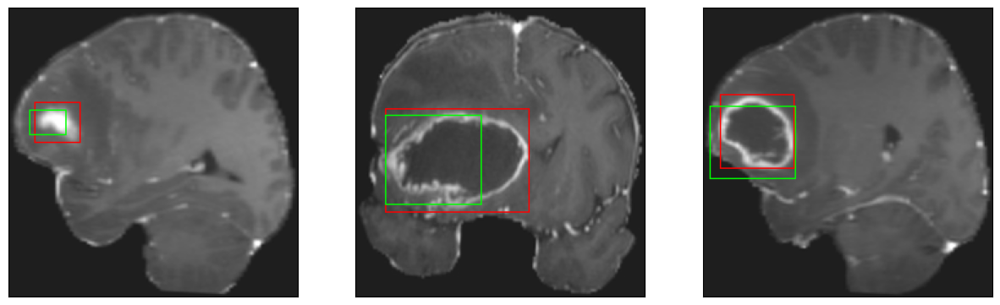

26/26 [==============================] - 8s 301ms/step - loss: 7.1994 - IoU: 0.5125 - val_loss: 9.3494 - val_IoU: 0.4803
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 7.4941 - IoU: 0.5000
Epoch 70: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


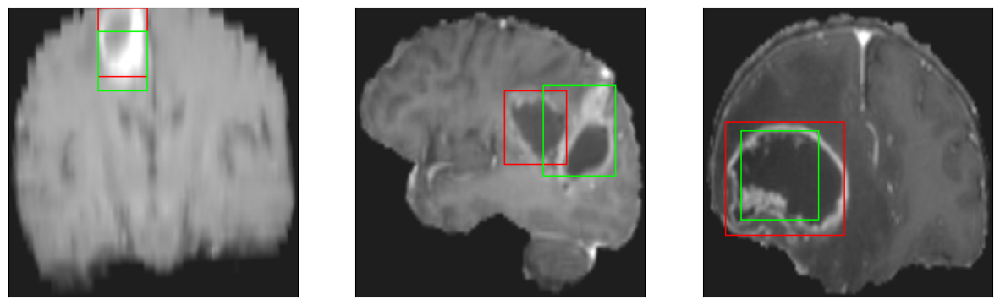

26/26 [==============================] - 8s 307ms/step - loss: 7.4941 - IoU: 0.5000 - val_loss: 9.9749 - val_IoU: 0.4378
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 7.2760 - IoU: 0.5053
Epoch 71: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


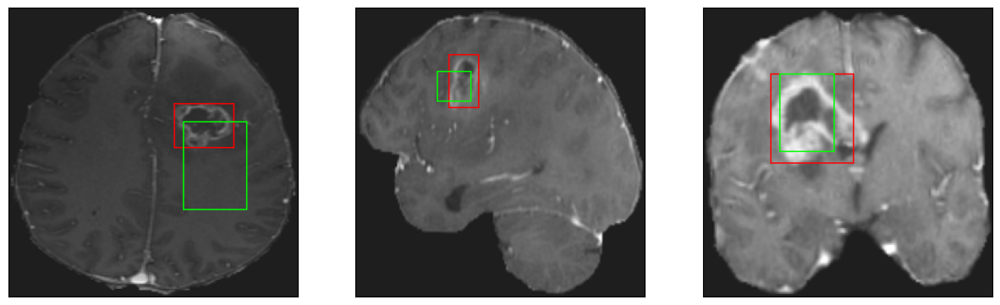

26/26 [==============================] - 7s 277ms/step - loss: 7.2760 - IoU: 0.5053 - val_loss: 9.6724 - val_IoU: 0.4365
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 7.4493 - IoU: 0.4958
Epoch 72: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4


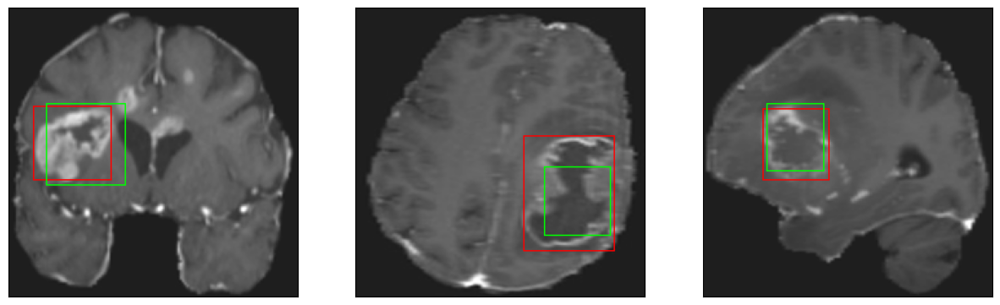

26/26 [==============================] - 8s 294ms/step - loss: 7.4493 - IoU: 0.4958 - val_loss: 8.3861 - val_IoU: 0.4995
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 7.4431 - IoU: 0.5015
Epoch 73: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


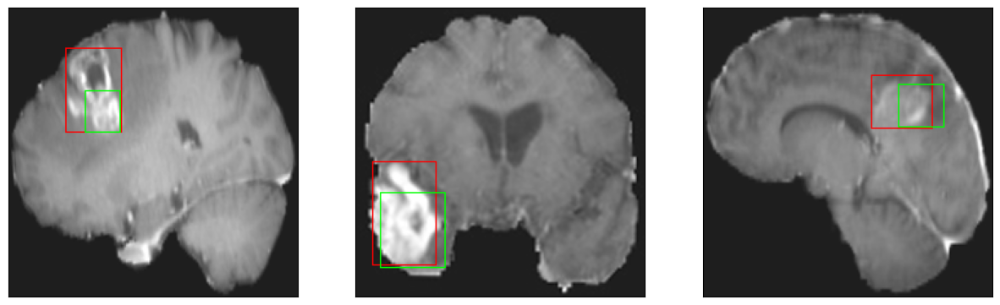

26/26 [==============================] - 7s 280ms/step - loss: 7.4431 - IoU: 0.5015 - val_loss: 10.4803 - val_IoU: 0.4101
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 6.9128 - IoU: 0.5273
Epoch 74: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


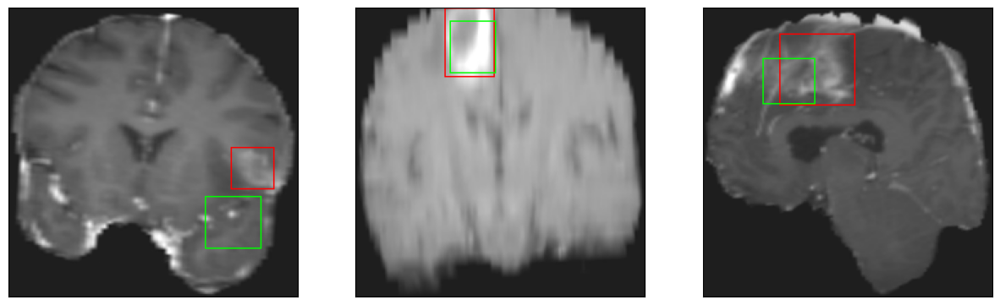

26/26 [==============================] - 7s 288ms/step - loss: 6.9128 - IoU: 0.5273 - val_loss: 8.9989 - val_IoU: 0.4934
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 7.3177 - IoU: 0.5092
Epoch 75: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


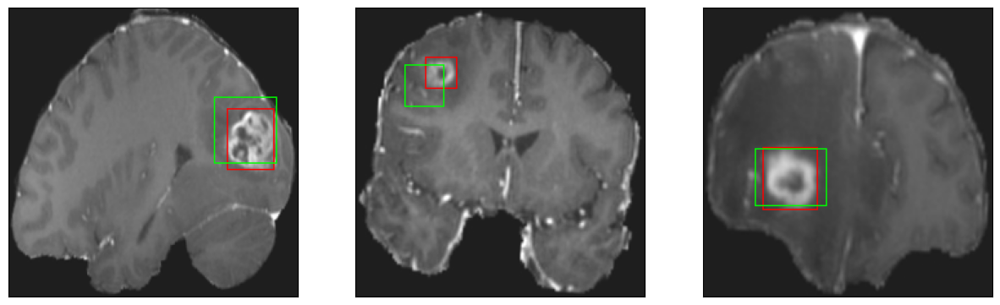

26/26 [==============================] - 8s 320ms/step - loss: 7.3177 - IoU: 0.5092 - val_loss: 8.9697 - val_IoU: 0.4853
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 7.4314 - IoU: 0.5005
Epoch 76: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


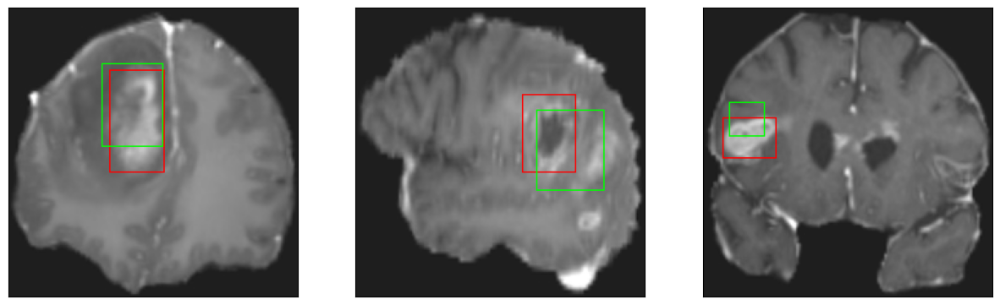

26/26 [==============================] - 8s 294ms/step - loss: 7.4314 - IoU: 0.5005 - val_loss: 8.9355 - val_IoU: 0.4846
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 7.2547 - IoU: 0.5046
Epoch 77: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


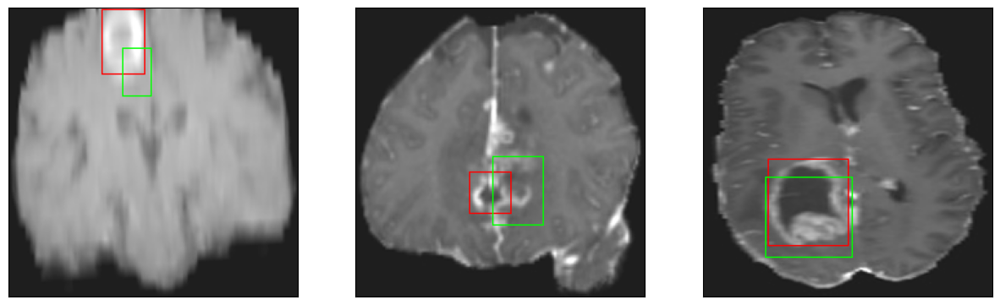

26/26 [==============================] - 8s 309ms/step - loss: 7.2547 - IoU: 0.5046 - val_loss: 9.1905 - val_IoU: 0.4831
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 6.7241 - IoU: 0.5318
Epoch 78: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


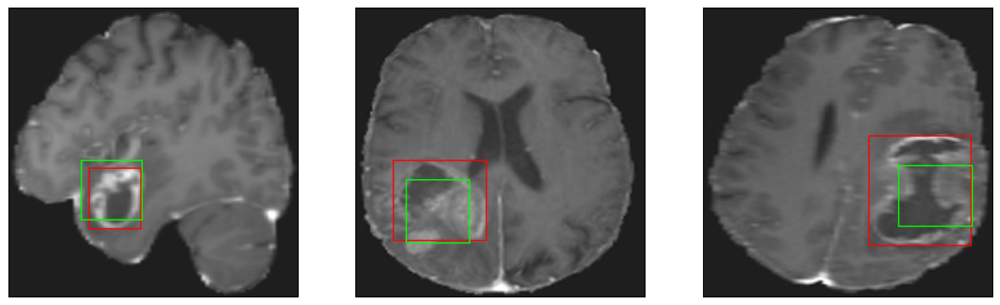

26/26 [==============================] - 8s 306ms/step - loss: 6.7241 - IoU: 0.5318 - val_loss: 9.0859 - val_IoU: 0.4959
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 7.1438 - IoU: 0.5042
Epoch 79: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


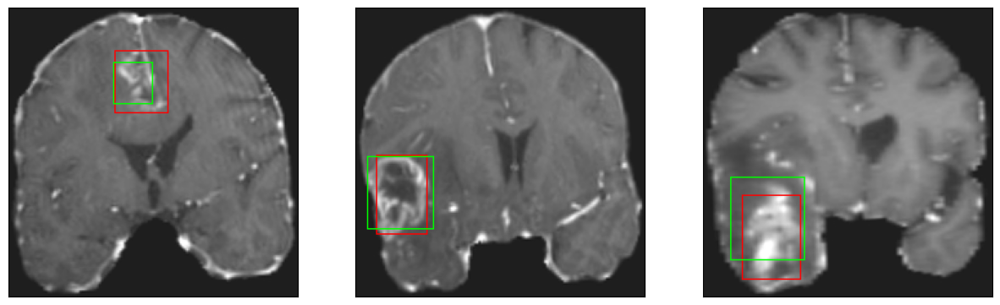

26/26 [==============================] - 7s 285ms/step - loss: 7.1438 - IoU: 0.5042 - val_loss: 9.4857 - val_IoU: 0.4769
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 6.8615 - IoU: 0.5241
Epoch 80: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


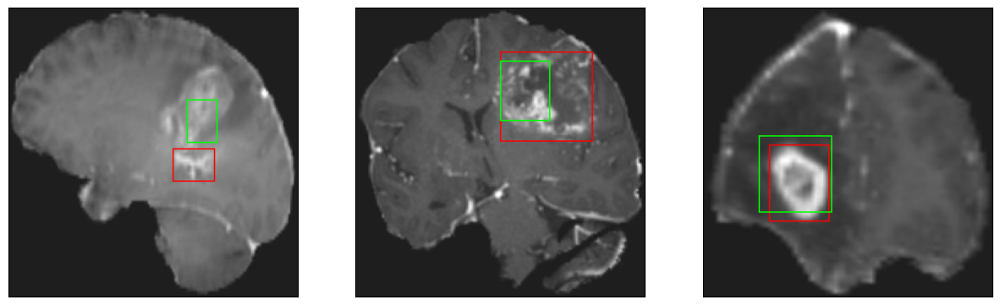

26/26 [==============================] - 8s 311ms/step - loss: 6.8615 - IoU: 0.5241 - val_loss: 8.7658 - val_IoU: 0.4997
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 6.7634 - IoU: 0.5264
Epoch 81: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


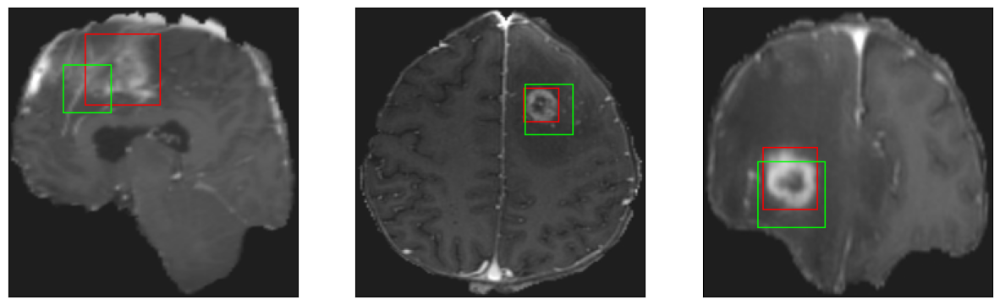

26/26 [==============================] - 7s 282ms/step - loss: 6.7634 - IoU: 0.5264 - val_loss: 8.7632 - val_IoU: 0.4746
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 6.8198 - IoU: 0.5193
Epoch 82: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 45ms/step
4


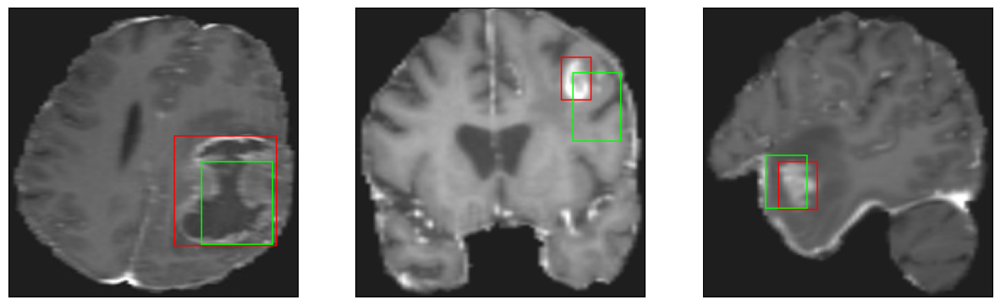

26/26 [==============================] - 8s 304ms/step - loss: 6.8198 - IoU: 0.5193 - val_loss: 9.5618 - val_IoU: 0.4729
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 7.1319 - IoU: 0.5135
Epoch 83: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


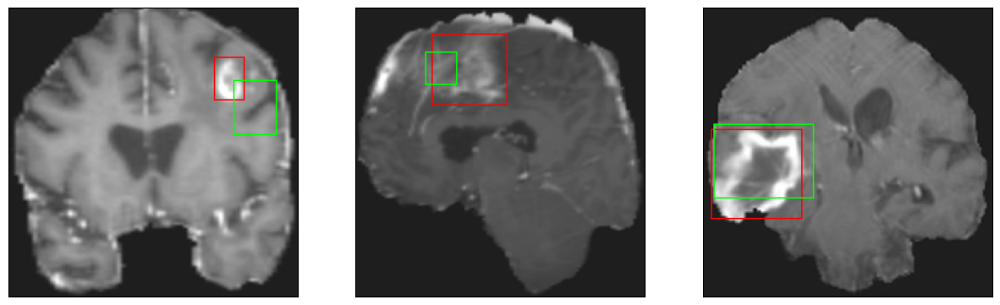

26/26 [==============================] - 7s 278ms/step - loss: 7.1319 - IoU: 0.5135 - val_loss: 9.4997 - val_IoU: 0.4538
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 7.0240 - IoU: 0.5078
Epoch 84: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


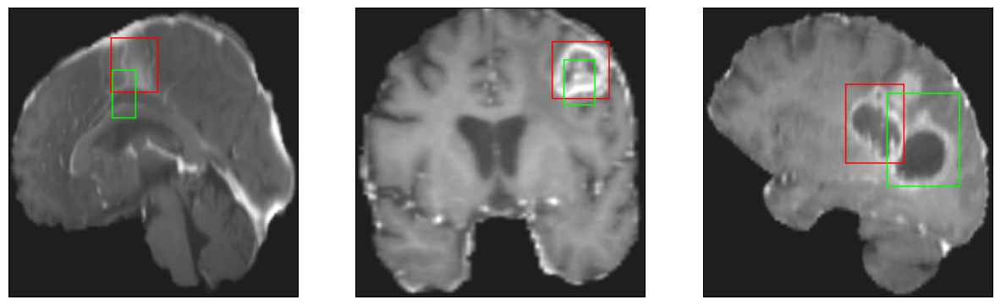

26/26 [==============================] - 8s 294ms/step - loss: 7.0240 - IoU: 0.5078 - val_loss: 11.2656 - val_IoU: 0.3754
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 6.8727 - IoU: 0.5231
Epoch 85: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


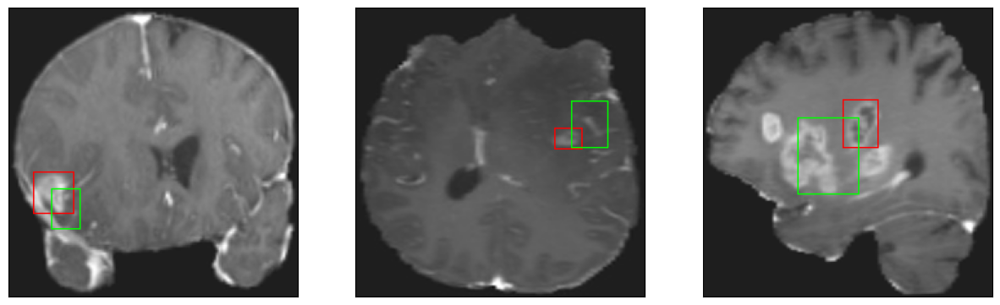

26/26 [==============================] - 8s 298ms/step - loss: 6.8727 - IoU: 0.5231 - val_loss: 8.8643 - val_IoU: 0.4863
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 6.8154 - IoU: 0.5241
Epoch 86: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


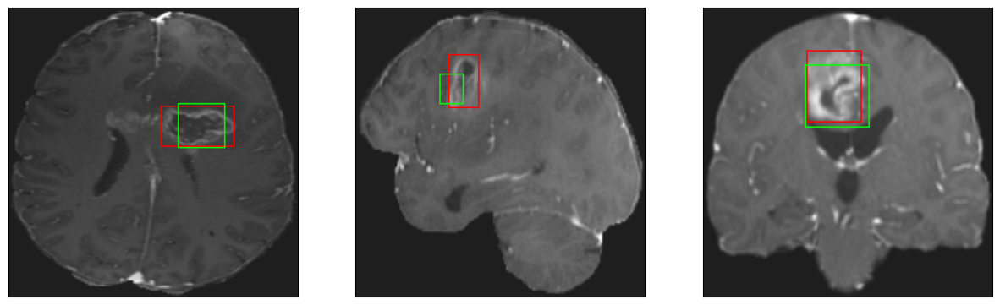

26/26 [==============================] - 8s 294ms/step - loss: 6.8154 - IoU: 0.5241 - val_loss: 8.7059 - val_IoU: 0.5025
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 6.8760 - IoU: 0.5244
Epoch 87: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


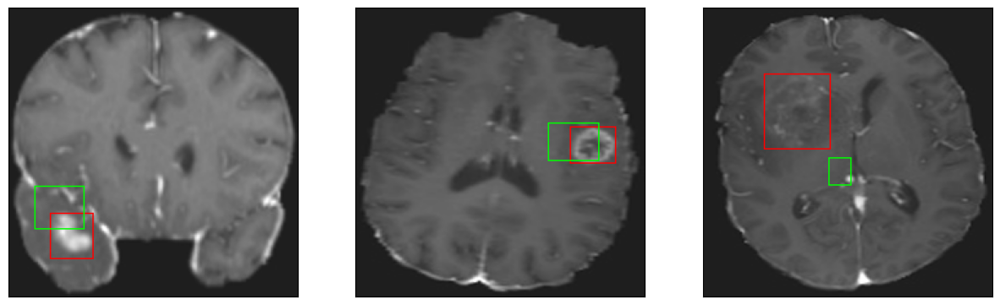

26/26 [==============================] - 8s 294ms/step - loss: 6.8760 - IoU: 0.5244 - val_loss: 8.8021 - val_IoU: 0.4906
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 7.0517 - IoU: 0.5075
Epoch 88: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


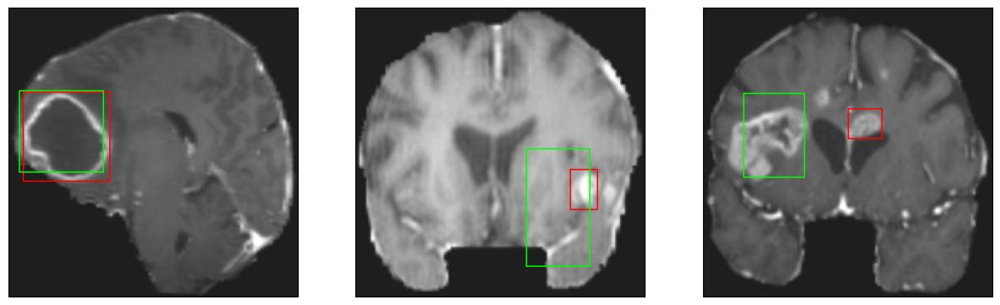

26/26 [==============================] - 8s 297ms/step - loss: 7.0517 - IoU: 0.5075 - val_loss: 10.7927 - val_IoU: 0.4465
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 6.8257 - IoU: 0.5216
Epoch 89: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


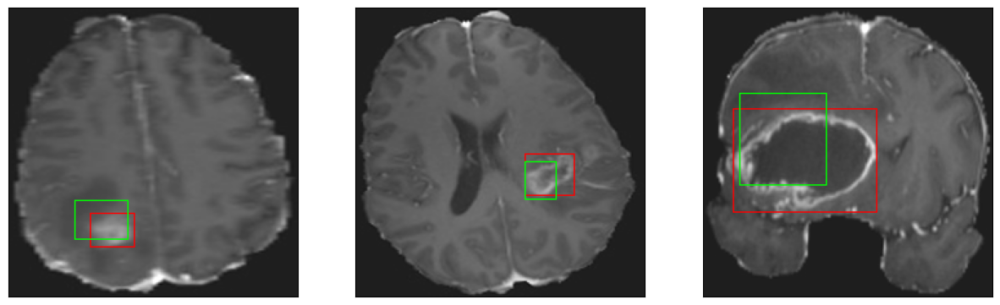

26/26 [==============================] - 8s 299ms/step - loss: 6.8257 - IoU: 0.5216 - val_loss: 9.1154 - val_IoU: 0.4591
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 6.7389 - IoU: 0.5219
Epoch 90: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


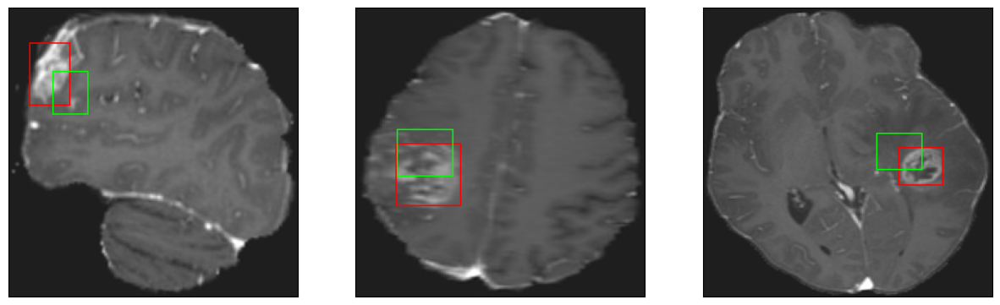

26/26 [==============================] - 8s 295ms/step - loss: 6.7389 - IoU: 0.5219 - val_loss: 9.3609 - val_IoU: 0.4536
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 6.6473 - IoU: 0.5380
Epoch 91: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


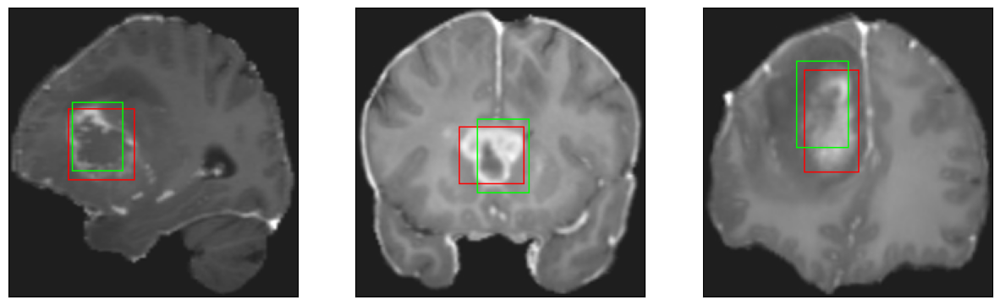

26/26 [==============================] - 8s 305ms/step - loss: 6.6473 - IoU: 0.5380 - val_loss: 8.7667 - val_IoU: 0.4858
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 6.4406 - IoU: 0.5417
Epoch 92: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


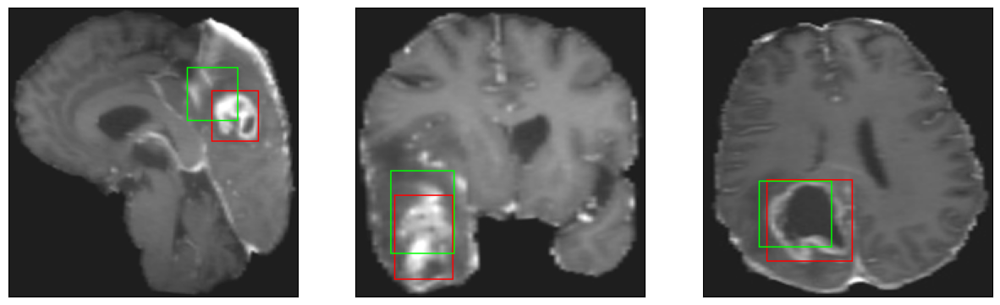

26/26 [==============================] - 8s 308ms/step - loss: 6.4406 - IoU: 0.5417 - val_loss: 8.9742 - val_IoU: 0.4648
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 6.6669 - IoU: 0.5231
Epoch 93: val_IoU did not improve from 0.50427
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


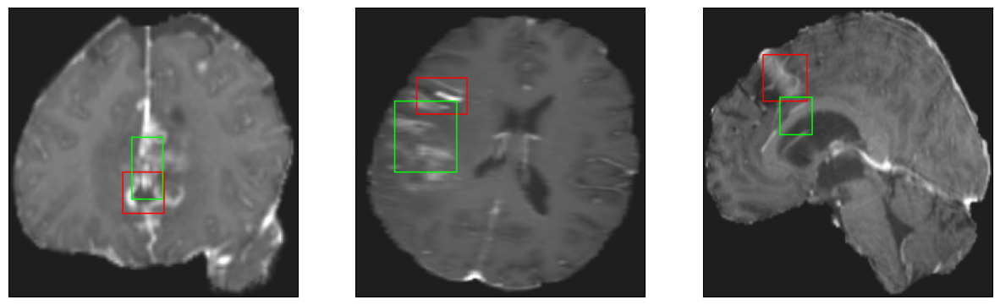

26/26 [==============================] - 8s 320ms/step - loss: 6.6669 - IoU: 0.5231 - val_loss: 9.4381 - val_IoU: 0.4383
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 6.5733 - IoU: 0.5275
Epoch 94: val_IoU improved from 0.50427 to 0.52317, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


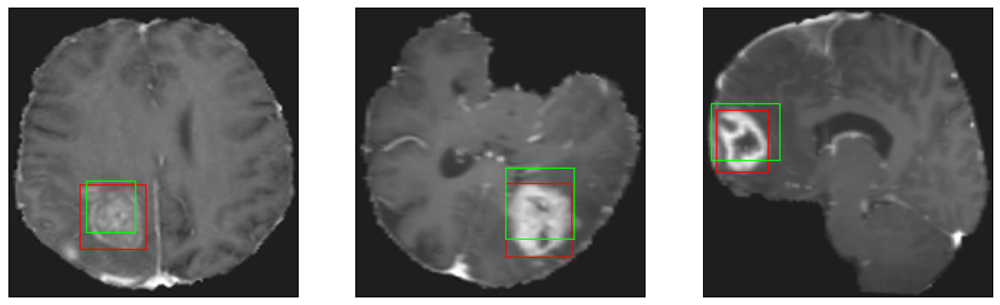

26/26 [==============================] - 23s 910ms/step - loss: 6.5733 - IoU: 0.5275 - val_loss: 8.0495 - val_IoU: 0.5232
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 6.7430 - IoU: 0.5157
Epoch 95: val_IoU did not improve from 0.52317
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 51ms/step
4
8/8 [==============================] - 0s 45ms/step
4


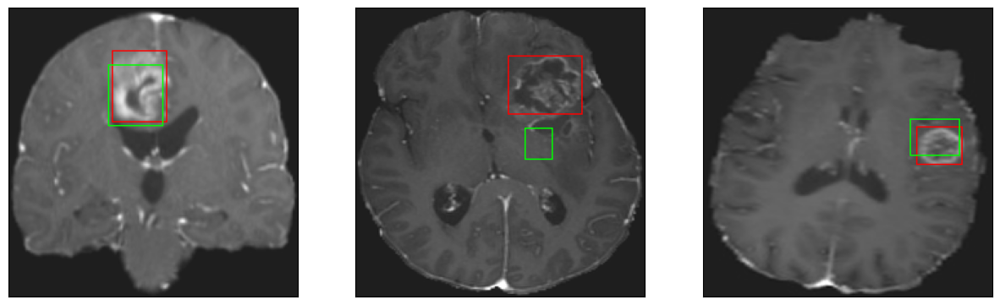

26/26 [==============================] - 8s 331ms/step - loss: 6.7430 - IoU: 0.5157 - val_loss: 8.5556 - val_IoU: 0.4815
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 6.6955 - IoU: 0.5170
Epoch 96: val_IoU did not improve from 0.52317
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


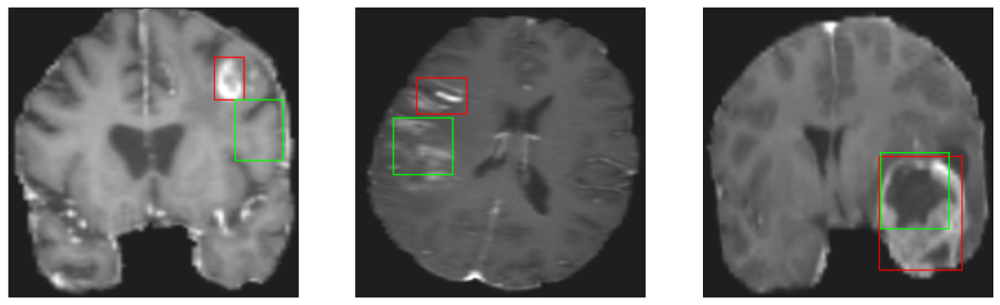

26/26 [==============================] - 9s 337ms/step - loss: 6.6955 - IoU: 0.5170 - val_loss: 8.8812 - val_IoU: 0.4845
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 6.9539 - IoU: 0.5203
Epoch 97: val_IoU did not improve from 0.52317
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


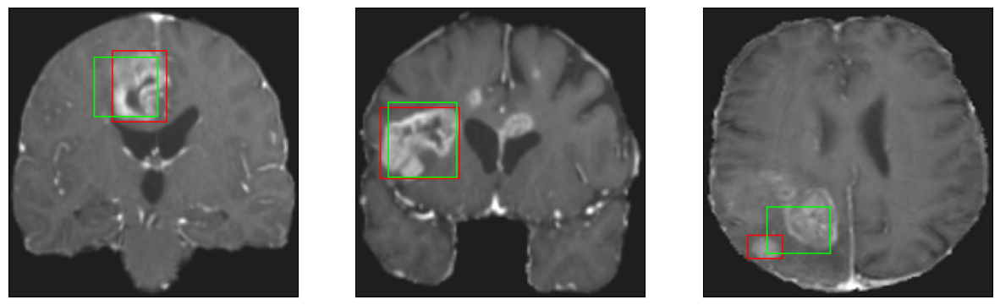

26/26 [==============================] - 8s 310ms/step - loss: 6.9539 - IoU: 0.5203 - val_loss: 8.7563 - val_IoU: 0.4826
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 6.3387 - IoU: 0.5388
Epoch 98: val_IoU improved from 0.52317 to 0.52486, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


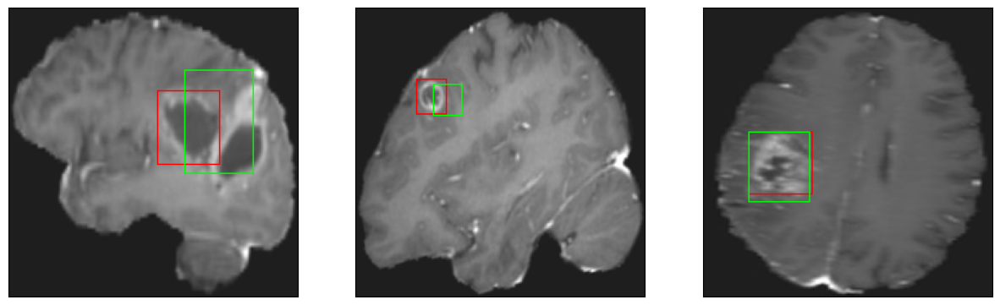

26/26 [==============================] - 28s 1s/step - loss: 6.3387 - IoU: 0.5388 - val_loss: 8.1525 - val_IoU: 0.5249
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 6.5862 - IoU: 0.5298
Epoch 99: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


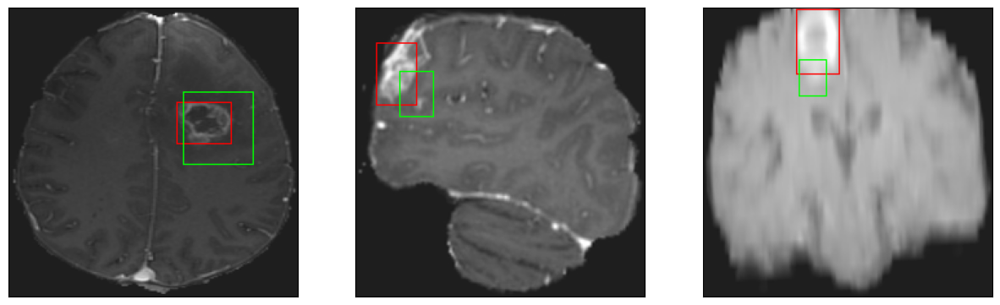

26/26 [==============================] - 8s 304ms/step - loss: 6.5862 - IoU: 0.5298 - val_loss: 8.6734 - val_IoU: 0.4779
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 6.5854 - IoU: 0.5295
Epoch 100: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


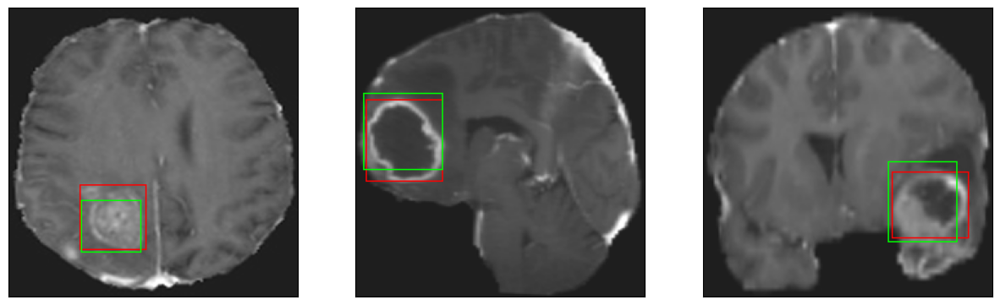

26/26 [==============================] - 9s 351ms/step - loss: 6.5854 - IoU: 0.5295 - val_loss: 9.0932 - val_IoU: 0.4834
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 6.6174 - IoU: 0.5318
Epoch 101: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


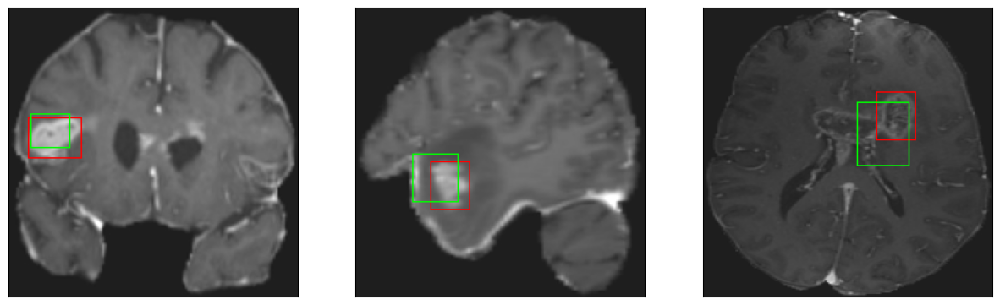

26/26 [==============================] - 7s 278ms/step - loss: 6.6174 - IoU: 0.5318 - val_loss: 8.6482 - val_IoU: 0.4906
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 6.2710 - IoU: 0.5532
Epoch 102: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


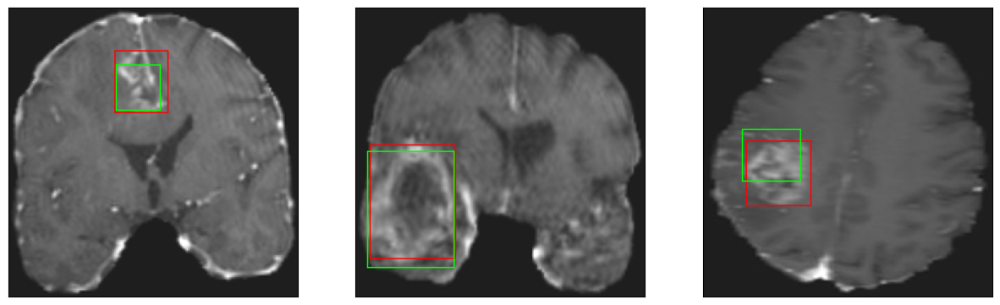

26/26 [==============================] - 7s 278ms/step - loss: 6.2710 - IoU: 0.5532 - val_loss: 8.7415 - val_IoU: 0.4881
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 6.3618 - IoU: 0.5381
Epoch 103: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


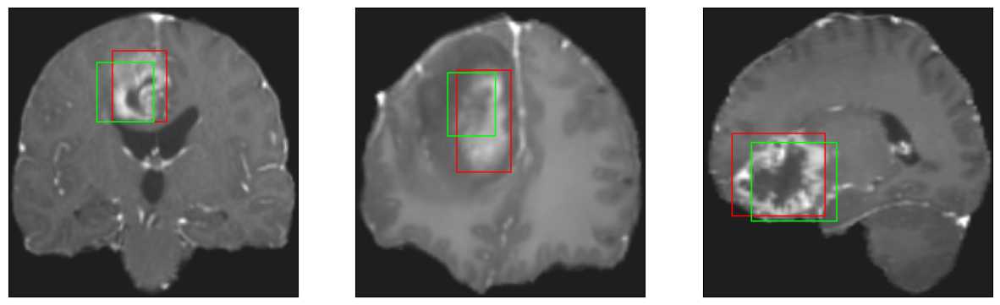

26/26 [==============================] - 8s 304ms/step - loss: 6.3618 - IoU: 0.5381 - val_loss: 10.8921 - val_IoU: 0.3978
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 6.4440 - IoU: 0.5393
Epoch 104: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


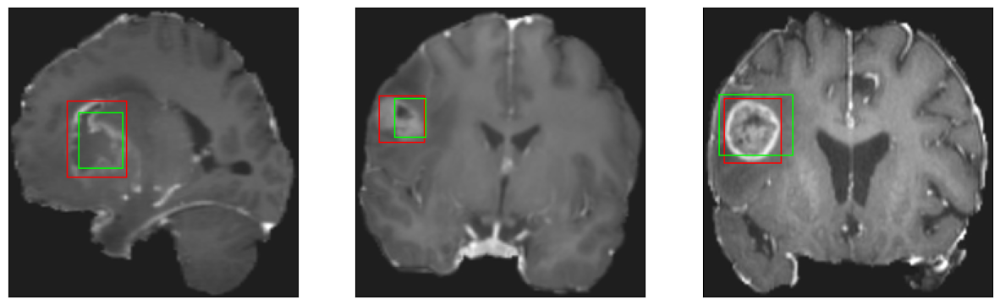

26/26 [==============================] - 7s 277ms/step - loss: 6.4440 - IoU: 0.5393 - val_loss: 8.7862 - val_IoU: 0.4940
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 6.3201 - IoU: 0.5499
Epoch 105: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


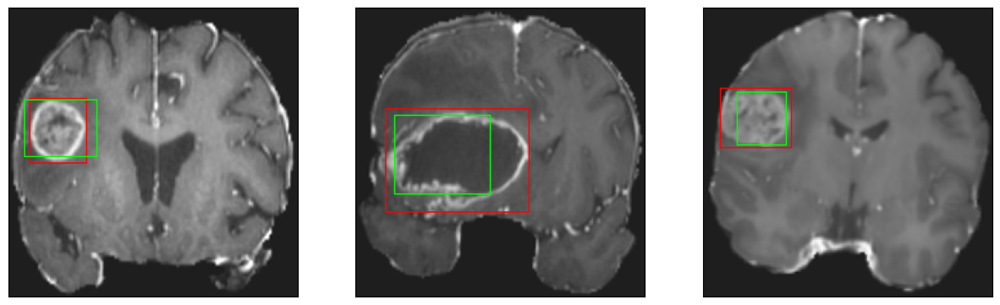

26/26 [==============================] - 8s 295ms/step - loss: 6.3201 - IoU: 0.5499 - val_loss: 9.3610 - val_IoU: 0.4588
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 6.3073 - IoU: 0.5404
Epoch 106: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


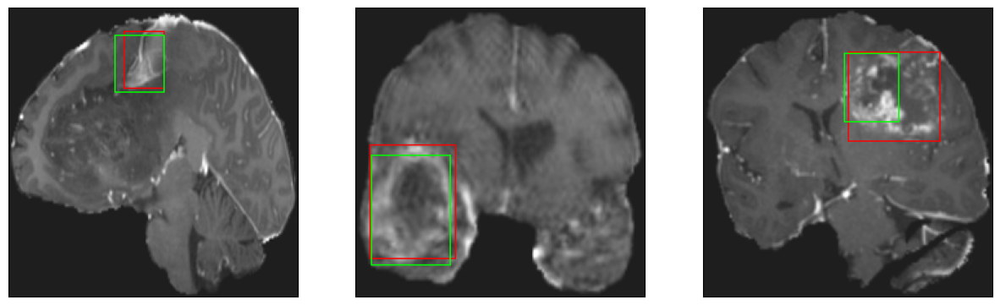

26/26 [==============================] - 7s 282ms/step - loss: 6.3073 - IoU: 0.5404 - val_loss: 8.4559 - val_IoU: 0.5035
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 6.4339 - IoU: 0.5427
Epoch 107: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


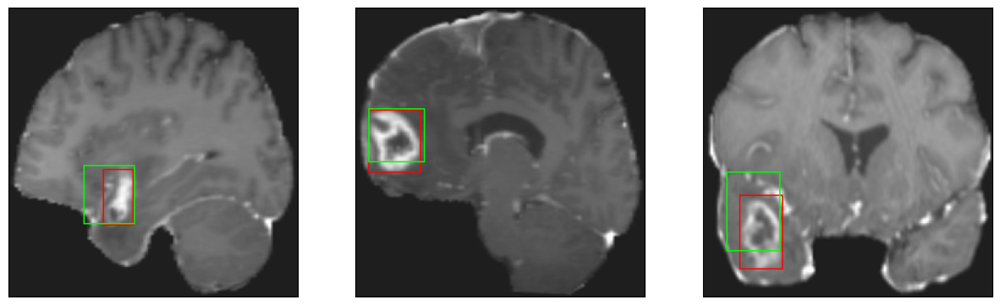

26/26 [==============================] - 8s 295ms/step - loss: 6.4339 - IoU: 0.5427 - val_loss: 9.7522 - val_IoU: 0.4709
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 6.3578 - IoU: 0.5514
Epoch 108: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


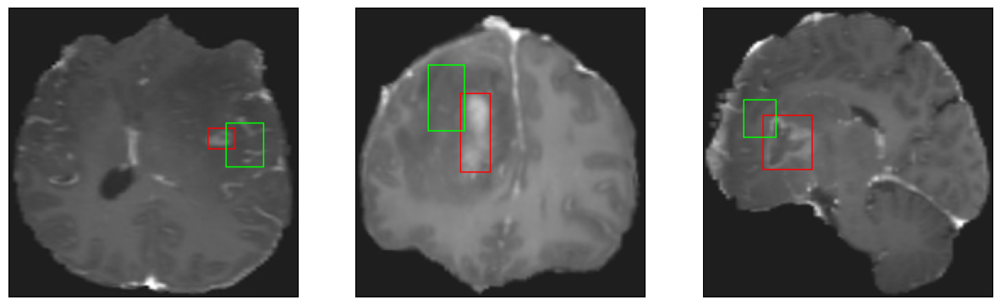

26/26 [==============================] - 7s 281ms/step - loss: 6.3578 - IoU: 0.5514 - val_loss: 8.9377 - val_IoU: 0.4968
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 6.2521 - IoU: 0.5482
Epoch 109: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


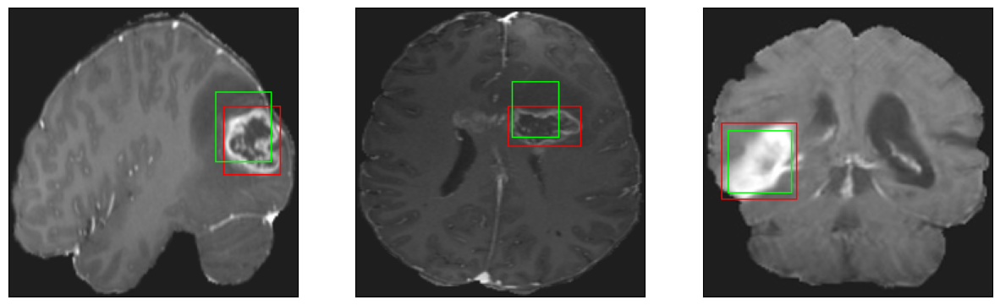

26/26 [==============================] - 8s 305ms/step - loss: 6.2521 - IoU: 0.5482 - val_loss: 9.2983 - val_IoU: 0.4486
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 6.3182 - IoU: 0.5468
Epoch 110: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


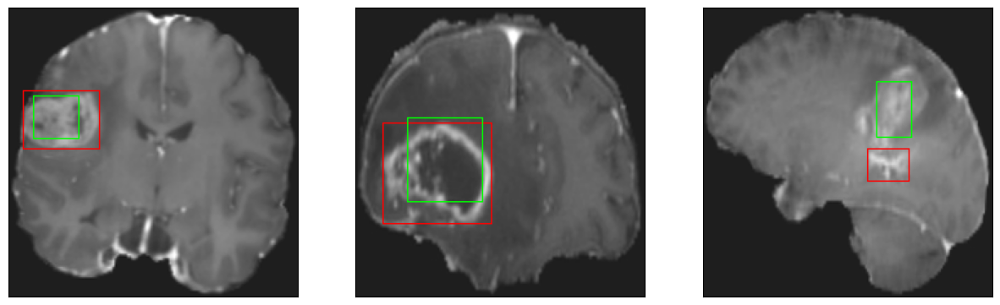

26/26 [==============================] - 8s 306ms/step - loss: 6.3182 - IoU: 0.5468 - val_loss: 9.1601 - val_IoU: 0.4814
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 6.5150 - IoU: 0.5304
Epoch 111: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


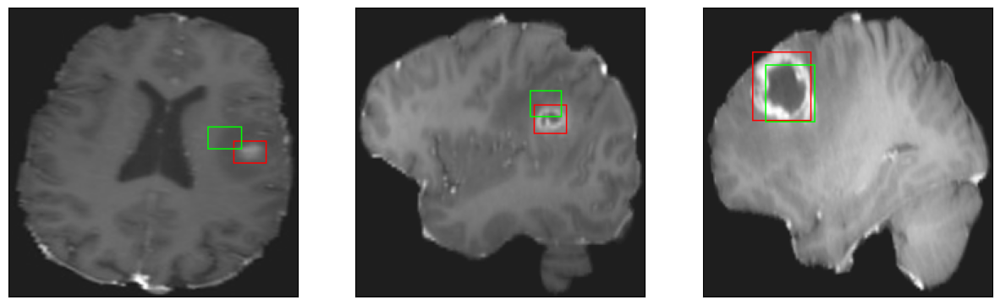

26/26 [==============================] - 8s 307ms/step - loss: 6.5150 - IoU: 0.5304 - val_loss: 8.6409 - val_IoU: 0.4922
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 6.1397 - IoU: 0.5510
Epoch 112: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


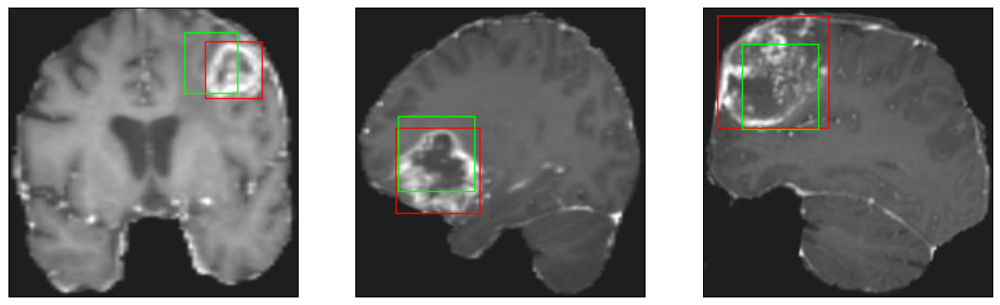

26/26 [==============================] - 8s 298ms/step - loss: 6.1397 - IoU: 0.5510 - val_loss: 8.5042 - val_IoU: 0.4940
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 6.2743 - IoU: 0.5365
Epoch 113: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


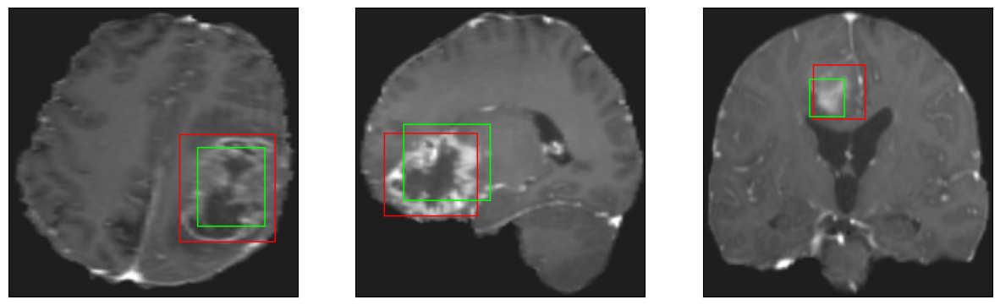

26/26 [==============================] - 8s 290ms/step - loss: 6.2743 - IoU: 0.5365 - val_loss: 8.4074 - val_IoU: 0.5108
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 6.2001 - IoU: 0.5535
Epoch 114: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


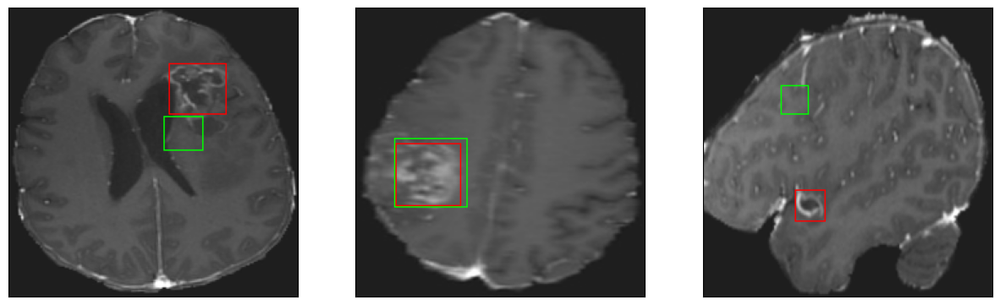

26/26 [==============================] - 8s 294ms/step - loss: 6.2001 - IoU: 0.5535 - val_loss: 8.2566 - val_IoU: 0.5011
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 5.9342 - IoU: 0.5637
Epoch 115: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


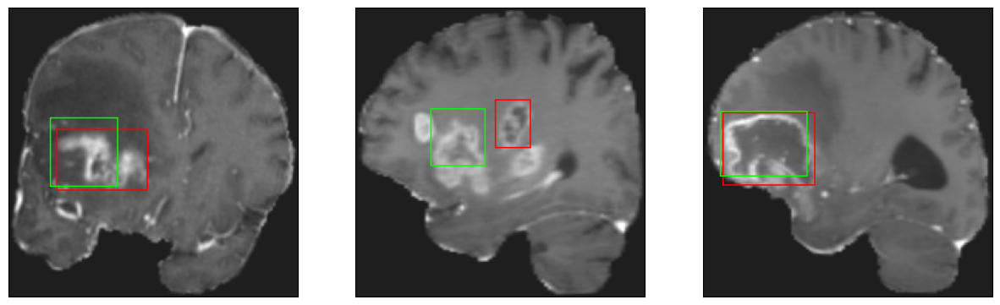

26/26 [==============================] - 8s 319ms/step - loss: 5.9342 - IoU: 0.5637 - val_loss: 9.0367 - val_IoU: 0.4841
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 5.9358 - IoU: 0.5666
Epoch 116: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


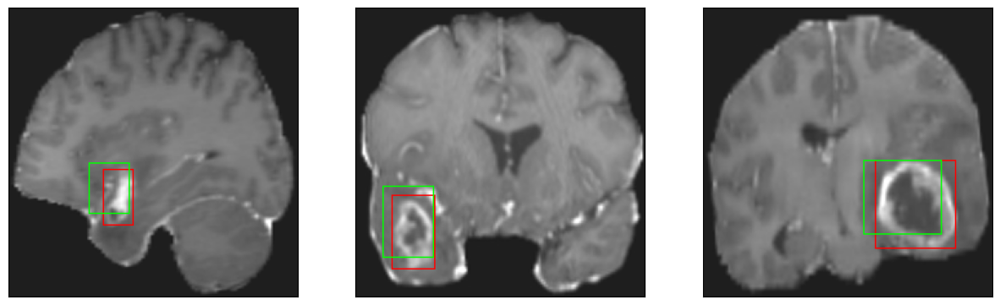

26/26 [==============================] - 8s 300ms/step - loss: 5.9358 - IoU: 0.5666 - val_loss: 8.9167 - val_IoU: 0.4555
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 6.0746 - IoU: 0.5545
Epoch 117: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


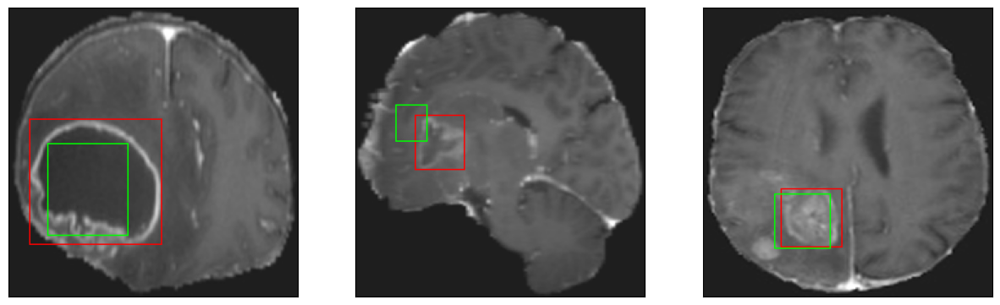

26/26 [==============================] - 8s 319ms/step - loss: 6.0746 - IoU: 0.5545 - val_loss: 8.5531 - val_IoU: 0.4972
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 6.0920 - IoU: 0.5438
Epoch 118: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


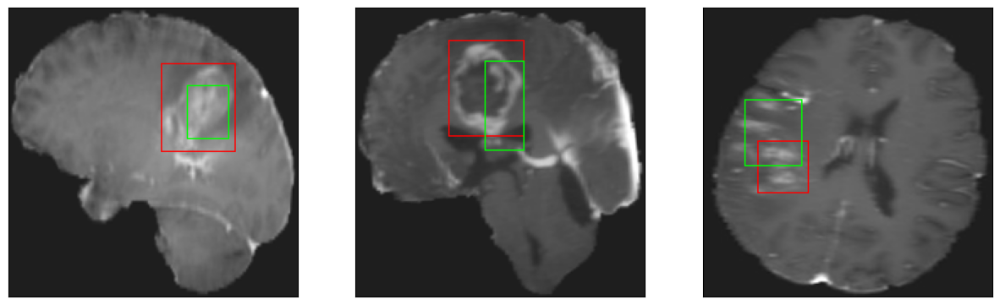

26/26 [==============================] - 7s 280ms/step - loss: 6.0920 - IoU: 0.5438 - val_loss: 8.7018 - val_IoU: 0.4793
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 5.8760 - IoU: 0.5678
Epoch 119: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


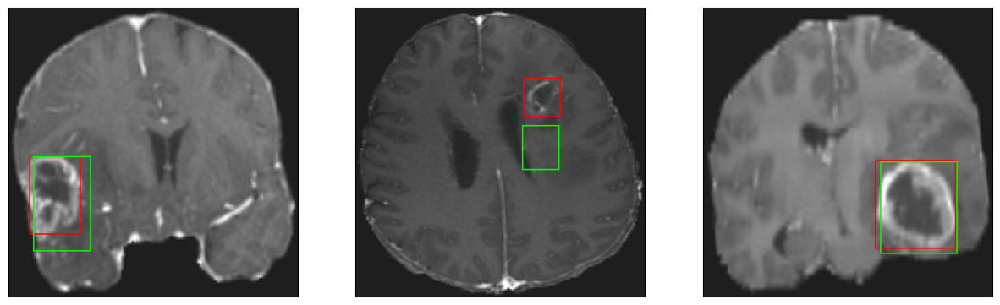

26/26 [==============================] - 8s 318ms/step - loss: 5.8760 - IoU: 0.5678 - val_loss: 8.8003 - val_IoU: 0.4862
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 6.1974 - IoU: 0.5429
Epoch 120: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


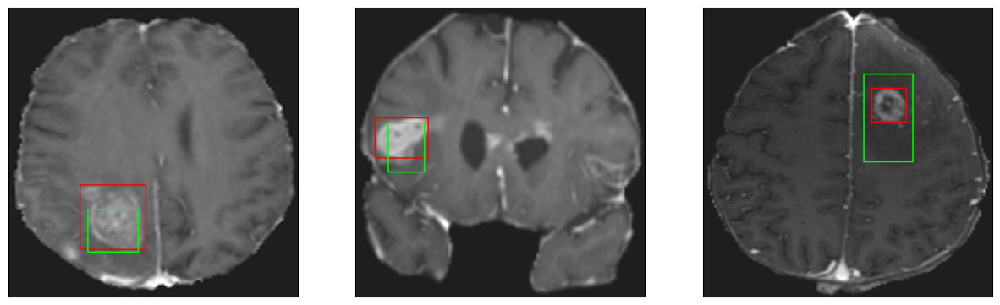

26/26 [==============================] - 8s 321ms/step - loss: 6.1974 - IoU: 0.5429 - val_loss: 10.5055 - val_IoU: 0.4118
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 5.8776 - IoU: 0.5670
Epoch 121: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


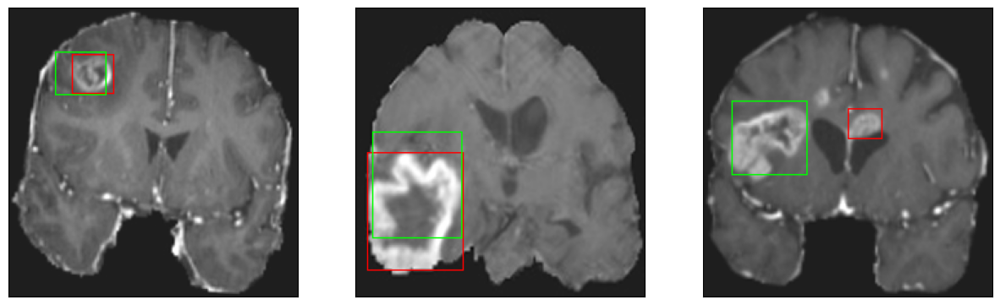

26/26 [==============================] - 7s 289ms/step - loss: 5.8776 - IoU: 0.5670 - val_loss: 8.7431 - val_IoU: 0.4872
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 5.5636 - IoU: 0.5786
Epoch 122: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


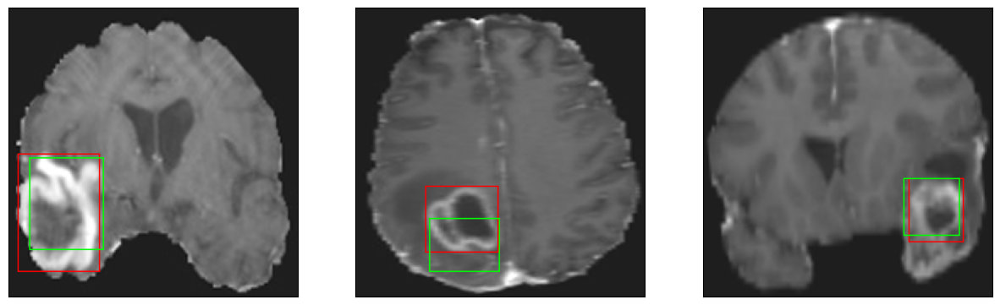

26/26 [==============================] - 8s 311ms/step - loss: 5.5636 - IoU: 0.5786 - val_loss: 8.8178 - val_IoU: 0.4954
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 6.0876 - IoU: 0.5574
Epoch 123: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


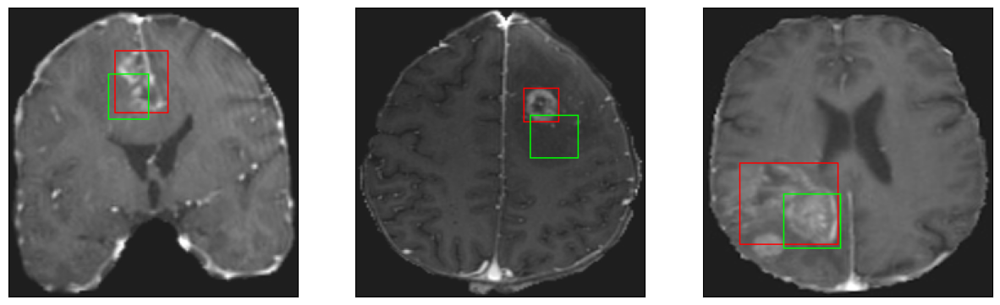

26/26 [==============================] - 7s 273ms/step - loss: 6.0876 - IoU: 0.5574 - val_loss: 8.3504 - val_IoU: 0.5153
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 5.9854 - IoU: 0.5598
Epoch 124: val_IoU did not improve from 0.52486
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


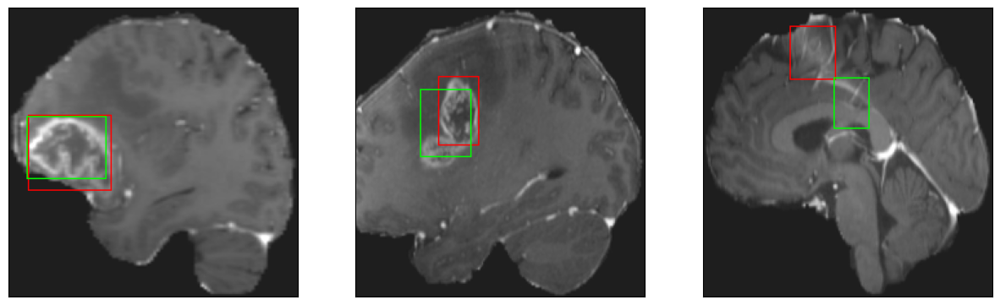

26/26 [==============================] - 8s 316ms/step - loss: 5.9854 - IoU: 0.5598 - val_loss: 8.4697 - val_IoU: 0.5109
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 5.7267 - IoU: 0.5709
Epoch 125: val_IoU improved from 0.52486 to 0.54205, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


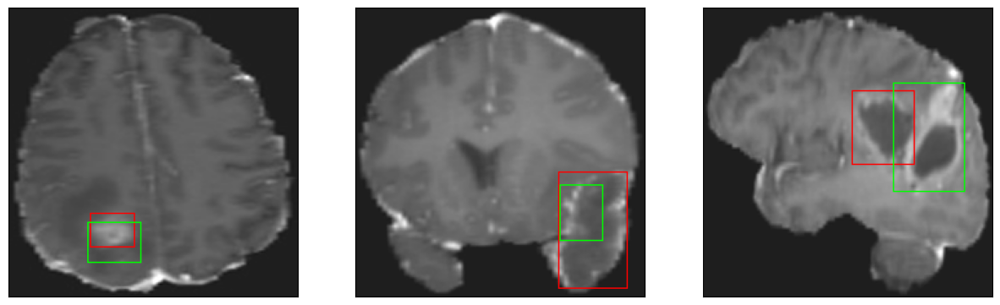

26/26 [==============================] - 33s 1s/step - loss: 5.7267 - IoU: 0.5709 - val_loss: 8.2155 - val_IoU: 0.5420
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 6.2547 - IoU: 0.5467
Epoch 126: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


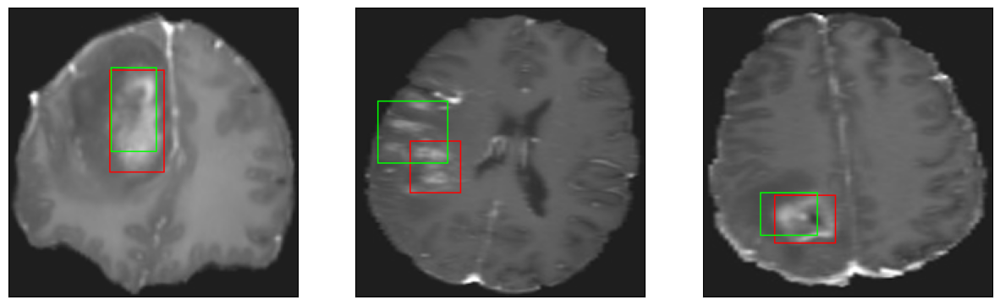

26/26 [==============================] - 8s 319ms/step - loss: 6.2547 - IoU: 0.5467 - val_loss: 9.6473 - val_IoU: 0.4482
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 6.2122 - IoU: 0.5431
Epoch 127: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 46ms/step
4


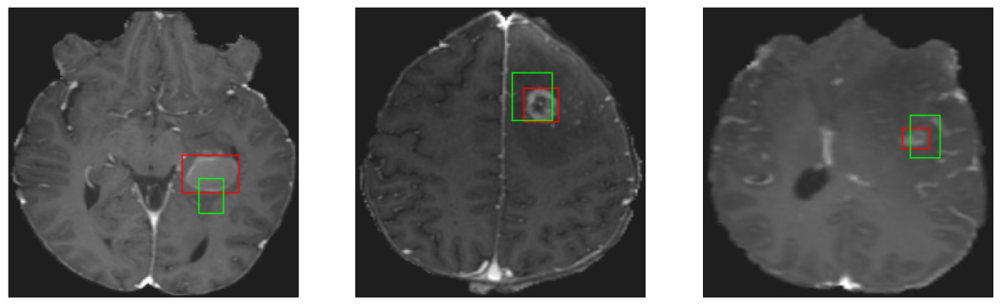

26/26 [==============================] - 8s 323ms/step - loss: 6.2122 - IoU: 0.5431 - val_loss: 9.5808 - val_IoU: 0.4505
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 6.1312 - IoU: 0.5519
Epoch 128: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


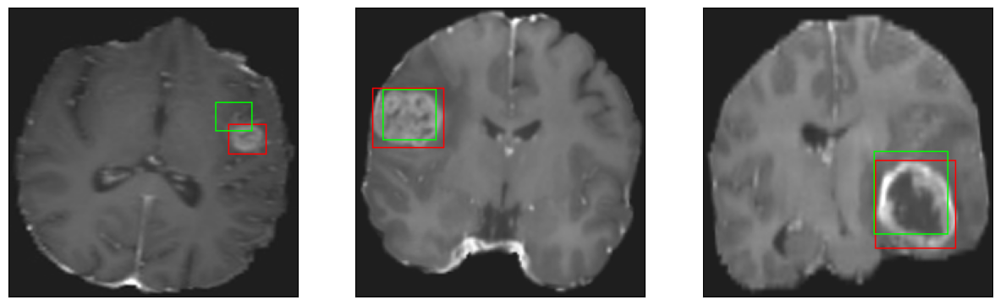

26/26 [==============================] - 7s 282ms/step - loss: 6.1312 - IoU: 0.5519 - val_loss: 8.2644 - val_IoU: 0.5105
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 5.9973 - IoU: 0.5560
Epoch 129: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


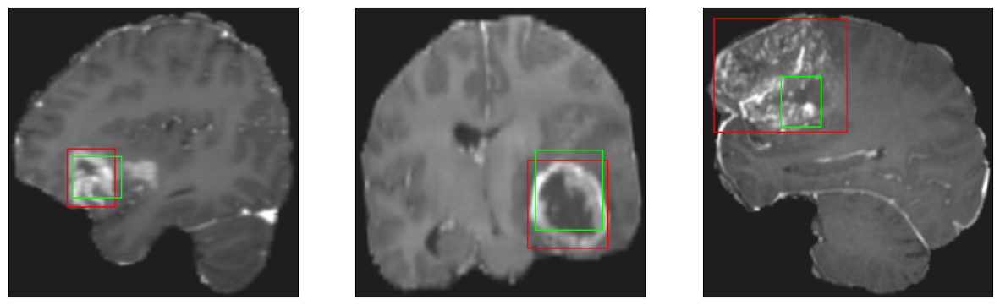

26/26 [==============================] - 7s 286ms/step - loss: 5.9973 - IoU: 0.5560 - val_loss: 15.5625 - val_IoU: 0.2770
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 5.9641 - IoU: 0.5662
Epoch 130: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


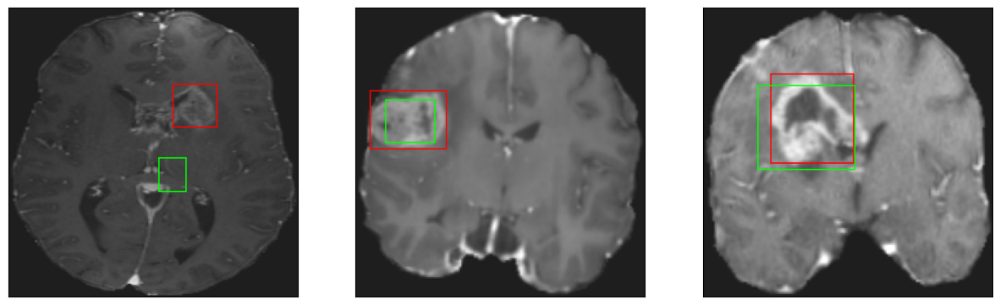

26/26 [==============================] - 8s 312ms/step - loss: 5.9641 - IoU: 0.5662 - val_loss: 9.7877 - val_IoU: 0.4385
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 6.1146 - IoU: 0.5502
Epoch 131: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


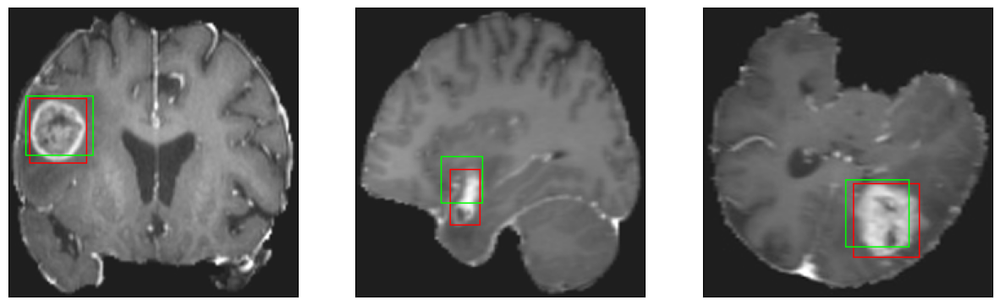

26/26 [==============================] - 8s 306ms/step - loss: 6.1146 - IoU: 0.5502 - val_loss: 9.5254 - val_IoU: 0.4780
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 5.8359 - IoU: 0.5600
Epoch 132: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


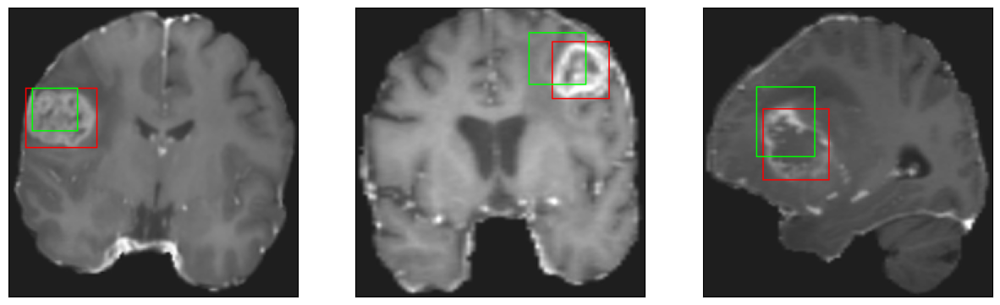

26/26 [==============================] - 8s 306ms/step - loss: 5.8359 - IoU: 0.5600 - val_loss: 9.1363 - val_IoU: 0.4492
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 5.9079 - IoU: 0.5741
Epoch 133: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4


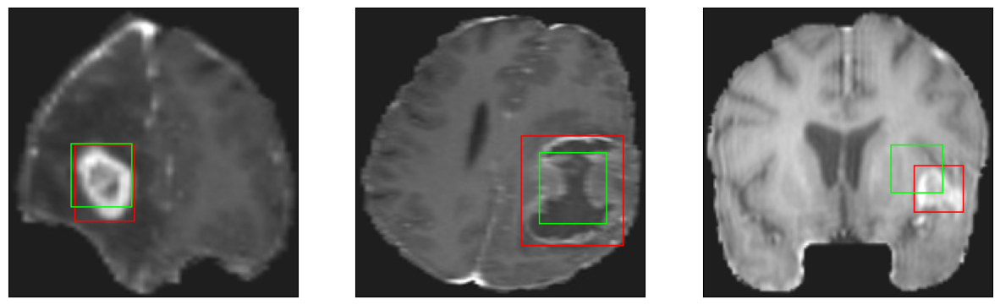

26/26 [==============================] - 8s 319ms/step - loss: 5.9079 - IoU: 0.5741 - val_loss: 8.4922 - val_IoU: 0.5046
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 5.8591 - IoU: 0.5640
Epoch 134: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


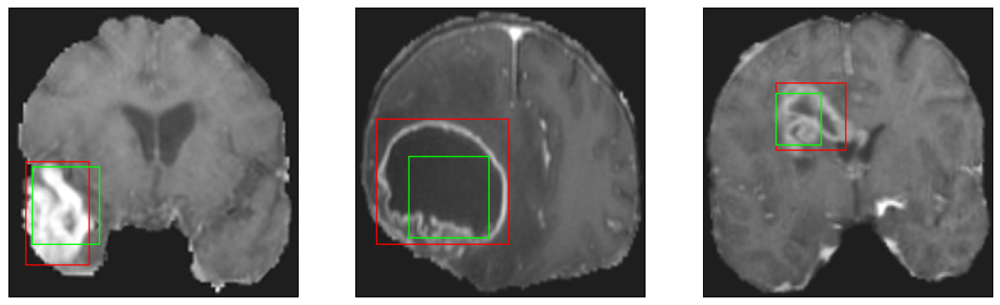

26/26 [==============================] - 8s 317ms/step - loss: 5.8591 - IoU: 0.5640 - val_loss: 7.8304 - val_IoU: 0.5337
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 5.4898 - IoU: 0.5844
Epoch 135: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


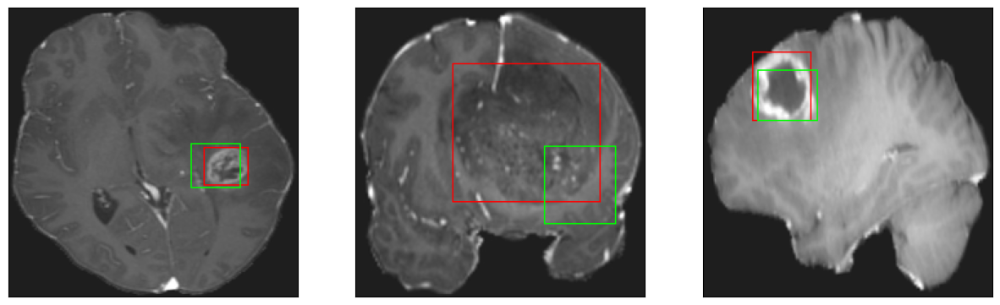

26/26 [==============================] - 8s 304ms/step - loss: 5.4898 - IoU: 0.5844 - val_loss: 8.3148 - val_IoU: 0.5163
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 5.7582 - IoU: 0.5656
Epoch 136: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


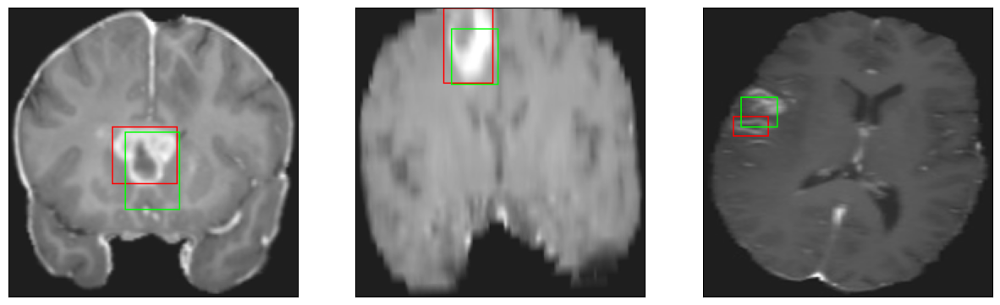

26/26 [==============================] - 8s 308ms/step - loss: 5.7582 - IoU: 0.5656 - val_loss: 8.2829 - val_IoU: 0.5343
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 5.7862 - IoU: 0.5687
Epoch 137: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


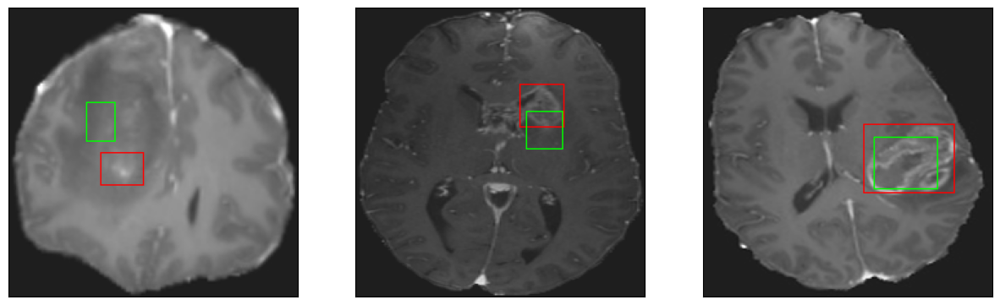

26/26 [==============================] - 7s 280ms/step - loss: 5.7862 - IoU: 0.5687 - val_loss: 8.1601 - val_IoU: 0.5259
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 5.4161 - IoU: 0.5916
Epoch 138: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


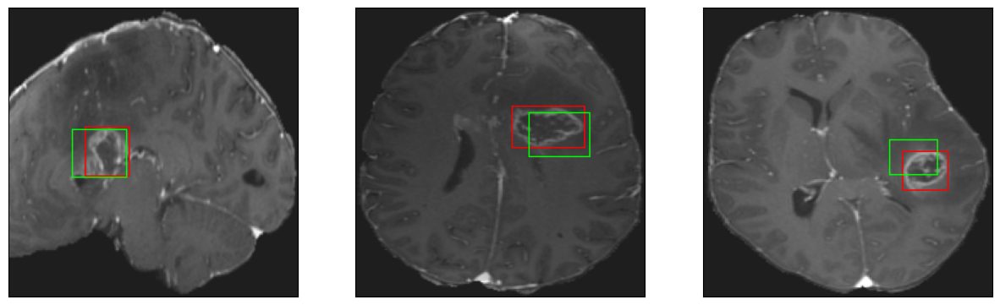

26/26 [==============================] - 7s 281ms/step - loss: 5.4161 - IoU: 0.5916 - val_loss: 8.3370 - val_IoU: 0.5101
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 5.5399 - IoU: 0.5741
Epoch 139: val_IoU did not improve from 0.54205
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


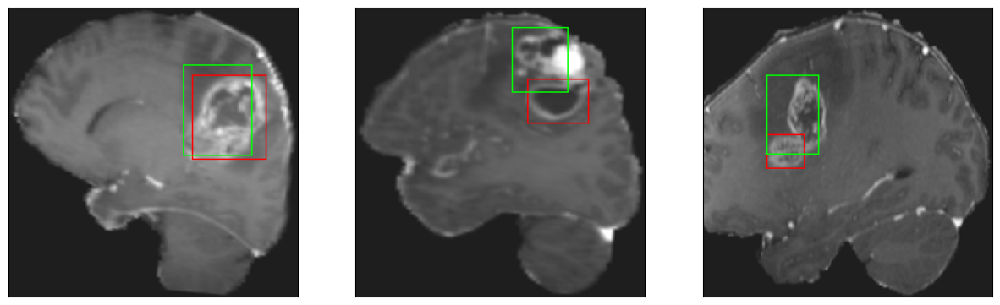

26/26 [==============================] - 8s 293ms/step - loss: 5.5399 - IoU: 0.5741 - val_loss: 9.3116 - val_IoU: 0.5048
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 5.7719 - IoU: 0.5679
Epoch 140: val_IoU improved from 0.54205 to 0.54753, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


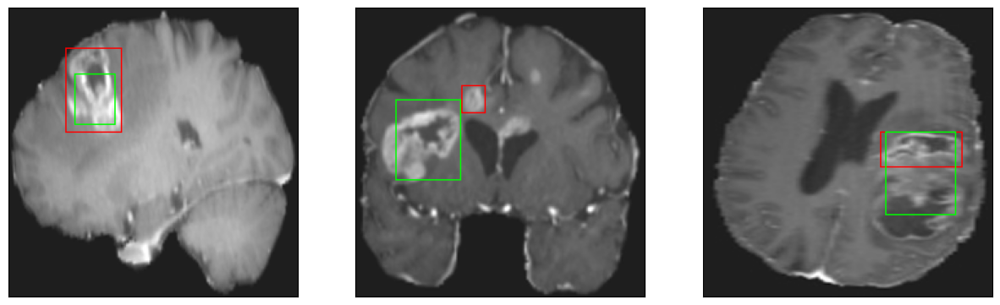

26/26 [==============================] - 44s 2s/step - loss: 5.7719 - IoU: 0.5679 - val_loss: 7.6188 - val_IoU: 0.5475
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 5.4597 - IoU: 0.5881
Epoch 141: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


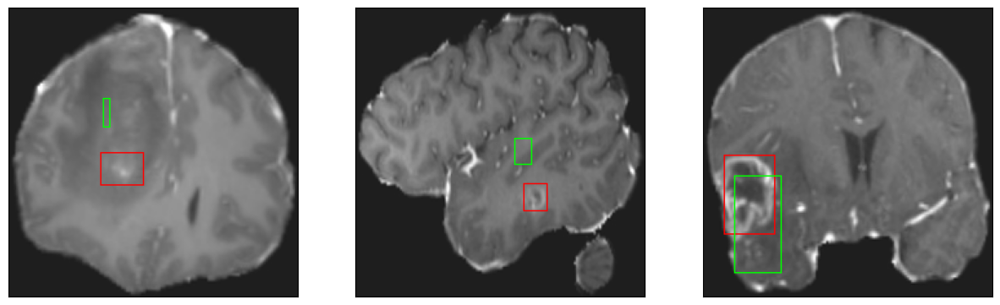

26/26 [==============================] - 8s 328ms/step - loss: 5.4597 - IoU: 0.5881 - val_loss: 9.6707 - val_IoU: 0.4634
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 5.8722 - IoU: 0.5561
Epoch 142: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


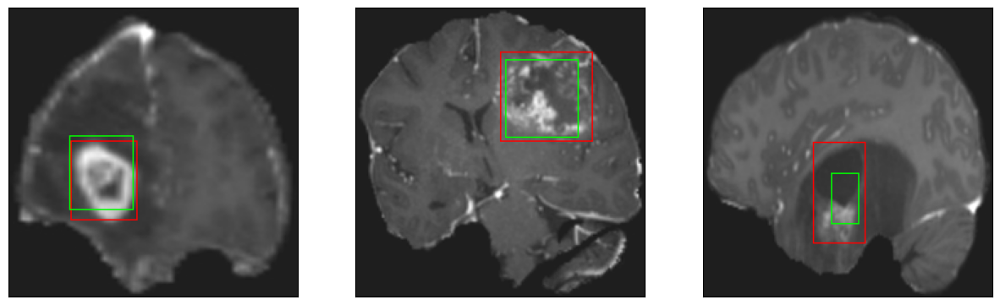

26/26 [==============================] - 8s 312ms/step - loss: 5.8722 - IoU: 0.5561 - val_loss: 8.8149 - val_IoU: 0.4829
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 5.8047 - IoU: 0.5566
Epoch 143: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


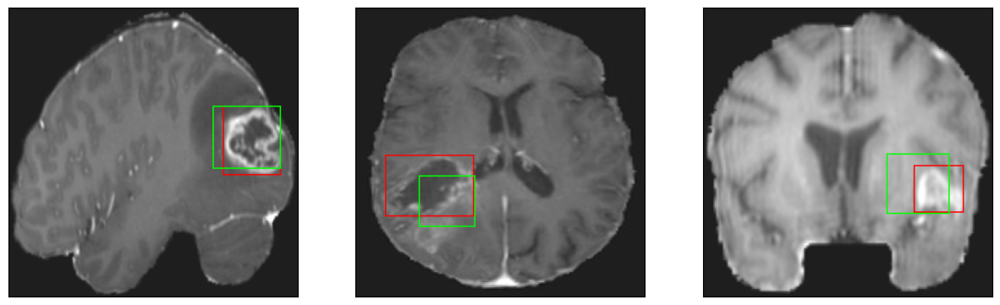

26/26 [==============================] - 8s 290ms/step - loss: 5.8047 - IoU: 0.5566 - val_loss: 9.3107 - val_IoU: 0.4598
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 5.9956 - IoU: 0.5534
Epoch 144: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


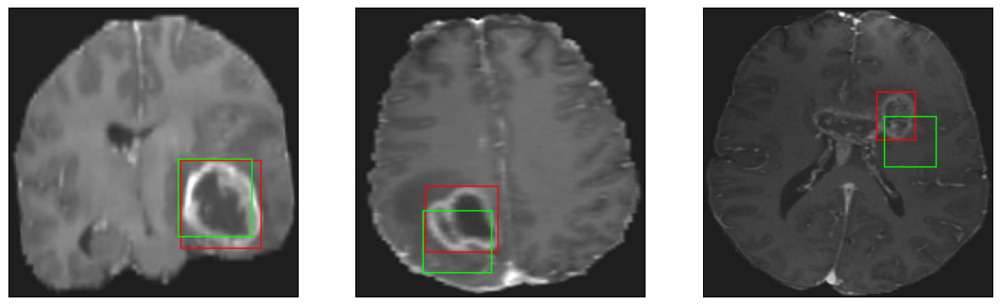

26/26 [==============================] - 7s 278ms/step - loss: 5.9956 - IoU: 0.5534 - val_loss: 8.5416 - val_IoU: 0.4804
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 5.7603 - IoU: 0.5706
Epoch 145: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


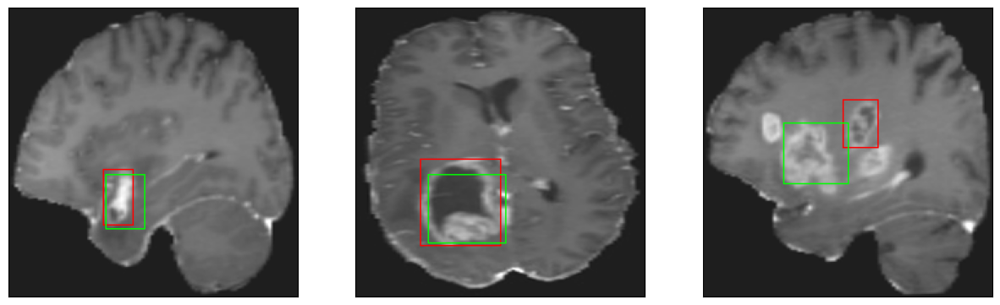

26/26 [==============================] - 8s 315ms/step - loss: 5.7603 - IoU: 0.5706 - val_loss: 8.2545 - val_IoU: 0.5116
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 5.8029 - IoU: 0.5701
Epoch 146: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


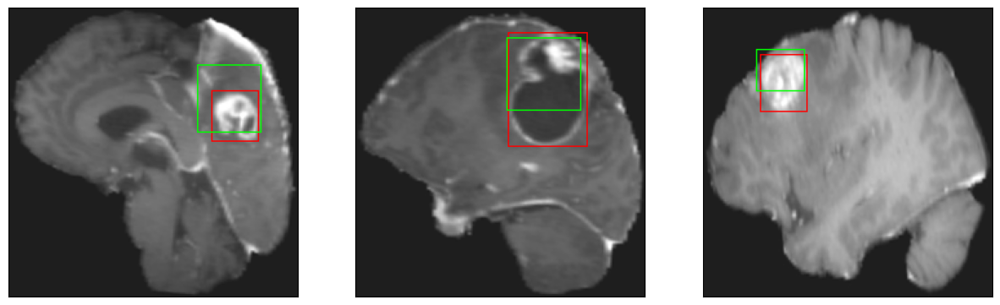

26/26 [==============================] - 8s 291ms/step - loss: 5.8029 - IoU: 0.5701 - val_loss: 8.2174 - val_IoU: 0.5039
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 5.6401 - IoU: 0.5738
Epoch 147: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


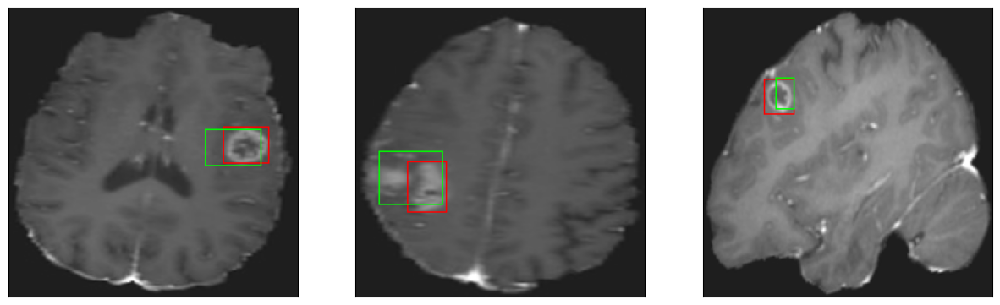

26/26 [==============================] - 7s 284ms/step - loss: 5.6401 - IoU: 0.5738 - val_loss: 8.0200 - val_IoU: 0.5406
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 5.4718 - IoU: 0.5756
Epoch 148: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


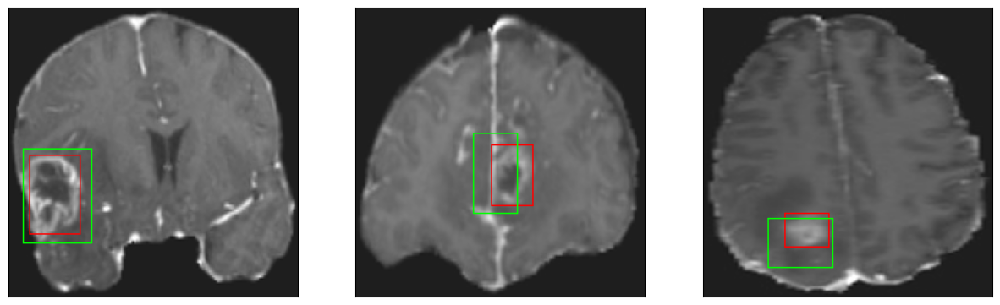

26/26 [==============================] - 7s 279ms/step - loss: 5.4718 - IoU: 0.5756 - val_loss: 8.1825 - val_IoU: 0.5184
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 5.6363 - IoU: 0.5742
Epoch 149: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


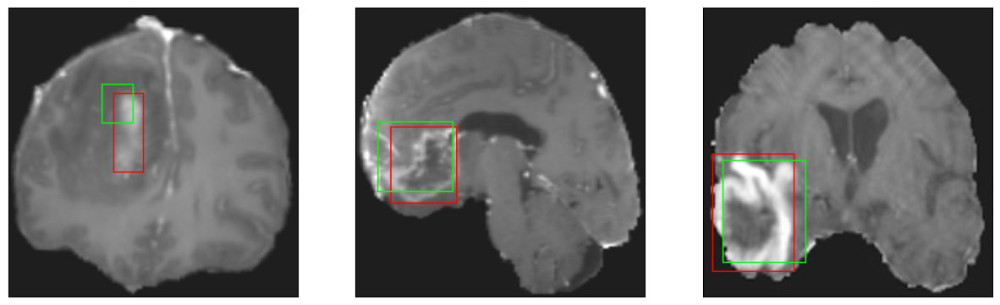

26/26 [==============================] - 8s 306ms/step - loss: 5.6363 - IoU: 0.5742 - val_loss: 8.5535 - val_IoU: 0.4960
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 5.9942 - IoU: 0.5515
Epoch 150: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


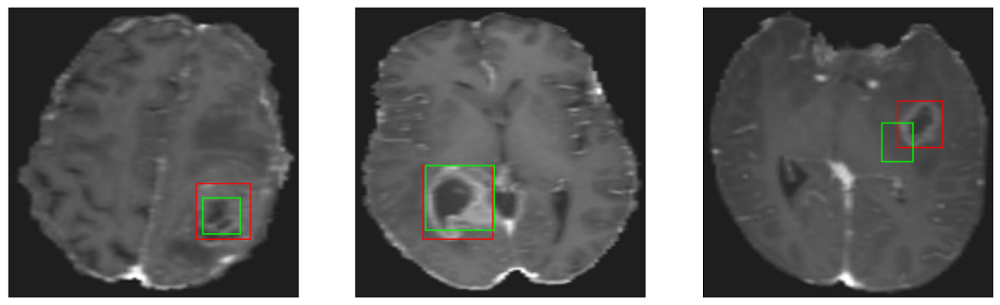

26/26 [==============================] - 7s 276ms/step - loss: 5.9942 - IoU: 0.5515 - val_loss: 8.2829 - val_IoU: 0.5188
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 5.3294 - IoU: 0.5955
Epoch 151: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4


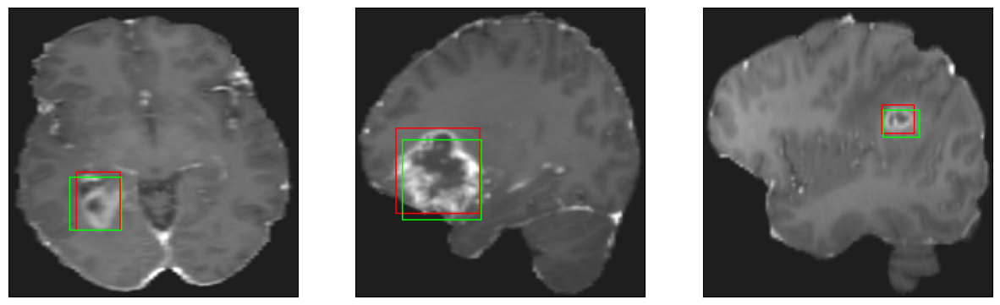

26/26 [==============================] - 8s 293ms/step - loss: 5.3294 - IoU: 0.5955 - val_loss: 7.9409 - val_IoU: 0.5311
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 5.3470 - IoU: 0.6008
Epoch 152: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


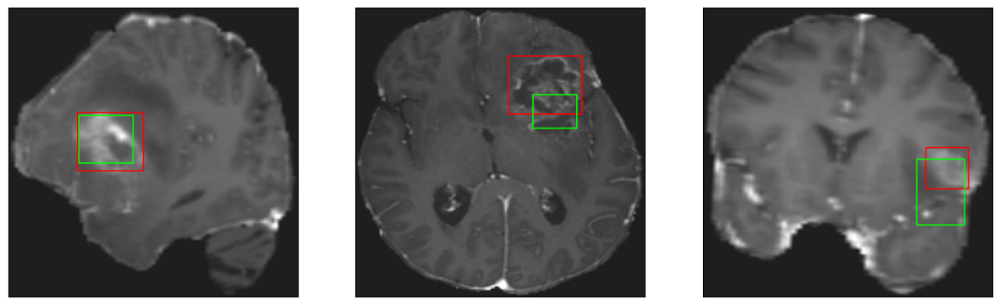

26/26 [==============================] - 8s 314ms/step - loss: 5.3470 - IoU: 0.6008 - val_loss: 8.5796 - val_IoU: 0.5124
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 5.7746 - IoU: 0.5766
Epoch 153: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


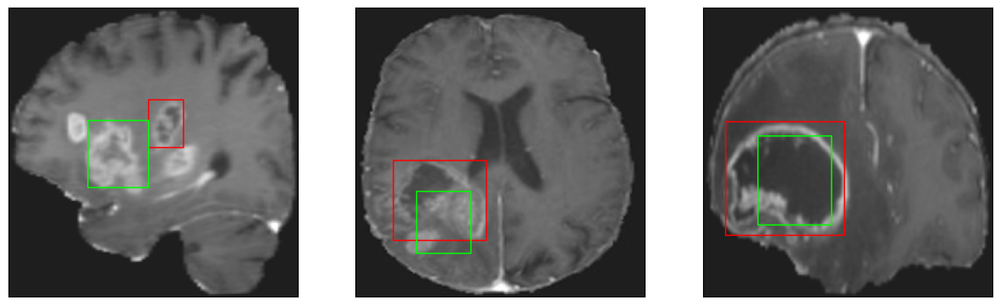

26/26 [==============================] - 8s 300ms/step - loss: 5.7746 - IoU: 0.5766 - val_loss: 7.9160 - val_IoU: 0.5467
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 5.3837 - IoU: 0.5746
Epoch 154: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4


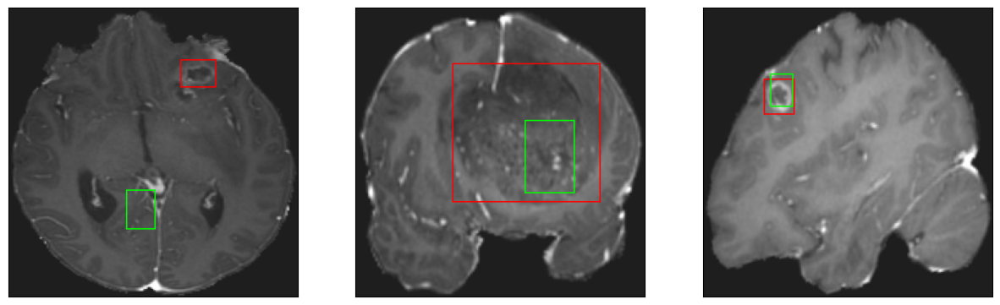

26/26 [==============================] - 8s 302ms/step - loss: 5.3837 - IoU: 0.5746 - val_loss: 8.6253 - val_IoU: 0.5141
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 5.5702 - IoU: 0.5824
Epoch 155: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


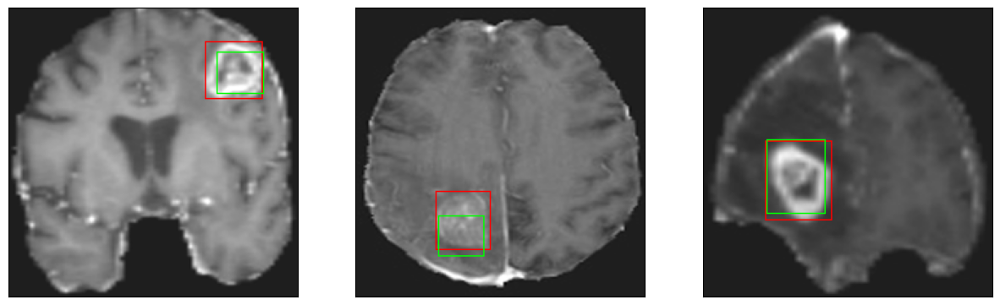

26/26 [==============================] - 8s 307ms/step - loss: 5.5702 - IoU: 0.5824 - val_loss: 8.5651 - val_IoU: 0.4986
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 5.4881 - IoU: 0.5857
Epoch 156: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


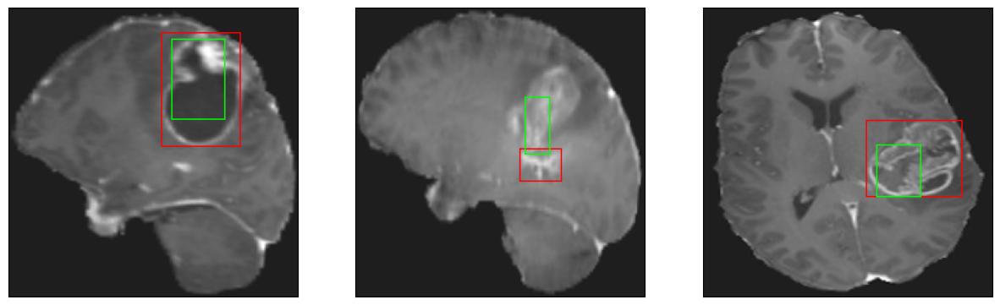

26/26 [==============================] - 8s 321ms/step - loss: 5.4881 - IoU: 0.5857 - val_loss: 9.3599 - val_IoU: 0.4763
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 5.7000 - IoU: 0.5741
Epoch 157: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


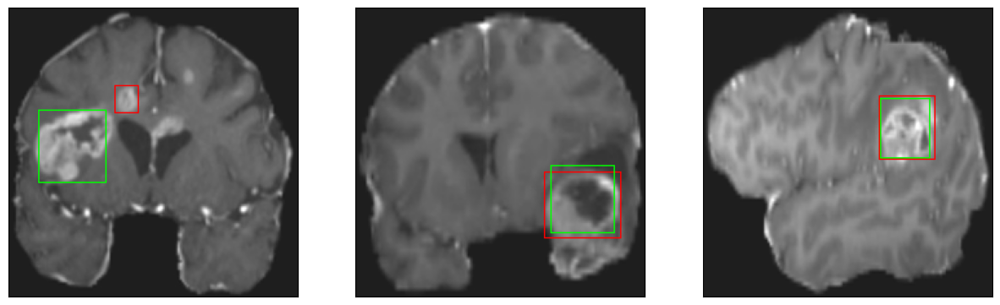

26/26 [==============================] - 8s 311ms/step - loss: 5.7000 - IoU: 0.5741 - val_loss: 8.3402 - val_IoU: 0.5010
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 5.2614 - IoU: 0.5906
Epoch 158: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


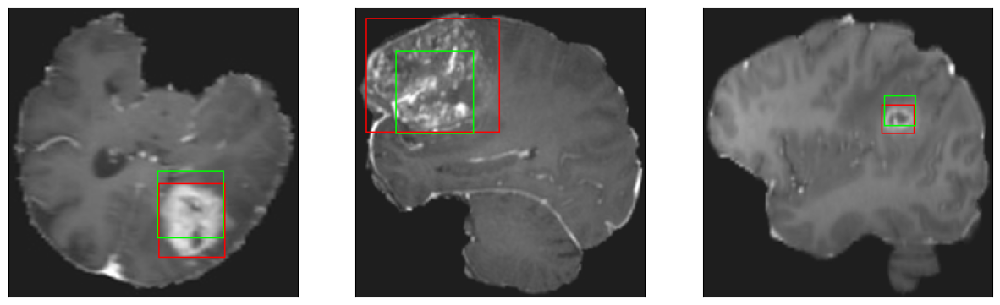

26/26 [==============================] - 8s 316ms/step - loss: 5.2614 - IoU: 0.5906 - val_loss: 8.3926 - val_IoU: 0.5114
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 5.6103 - IoU: 0.5703
Epoch 159: val_IoU did not improve from 0.54753
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


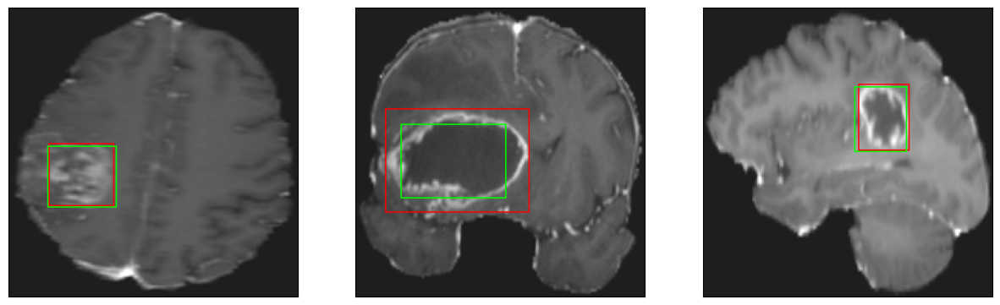

26/26 [==============================] - 8s 316ms/step - loss: 5.6103 - IoU: 0.5703 - val_loss: 9.2809 - val_IoU: 0.4680
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 5.4082 - IoU: 0.5897
Epoch 160: val_IoU improved from 0.54753 to 0.54999, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4


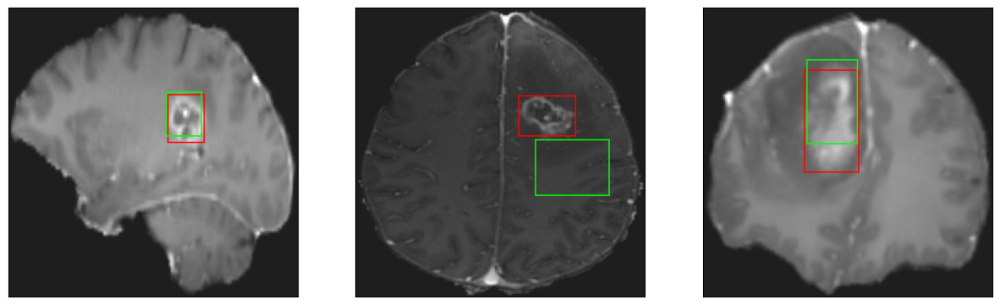

26/26 [==============================] - 29s 1s/step - loss: 5.4082 - IoU: 0.5897 - val_loss: 7.5934 - val_IoU: 0.5500
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 5.5008 - IoU: 0.5845
Epoch 161: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


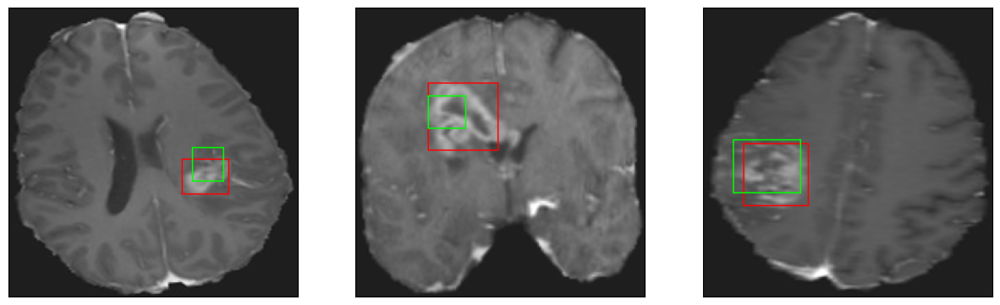

26/26 [==============================] - 9s 334ms/step - loss: 5.5008 - IoU: 0.5845 - val_loss: 9.0647 - val_IoU: 0.4816
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 5.3608 - IoU: 0.5881
Epoch 162: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4


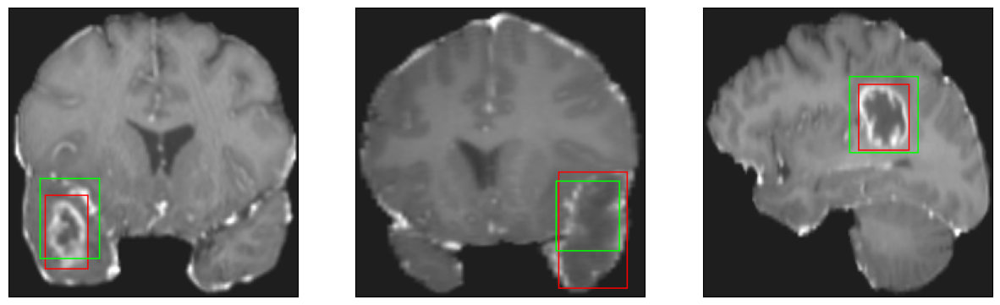

26/26 [==============================] - 8s 319ms/step - loss: 5.3608 - IoU: 0.5881 - val_loss: 8.4796 - val_IoU: 0.5081
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 5.4029 - IoU: 0.5903
Epoch 163: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


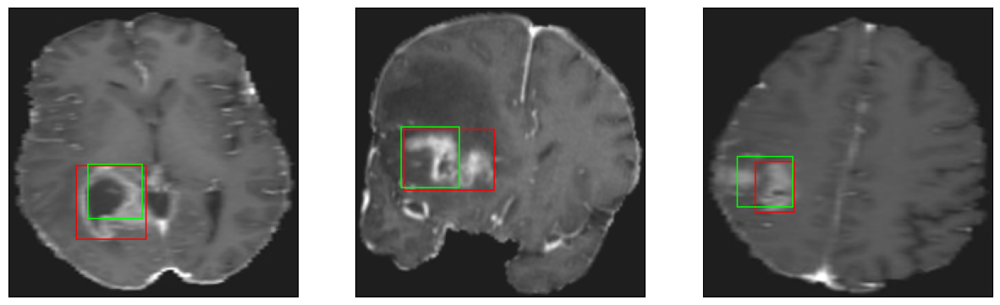

26/26 [==============================] - 8s 306ms/step - loss: 5.4029 - IoU: 0.5903 - val_loss: 8.9735 - val_IoU: 0.4828
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 5.4945 - IoU: 0.5772
Epoch 164: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


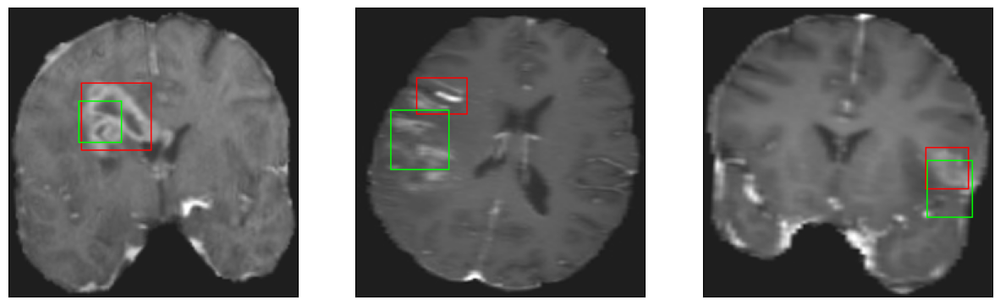

26/26 [==============================] - 8s 307ms/step - loss: 5.4945 - IoU: 0.5772 - val_loss: 8.4925 - val_IoU: 0.4985
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 5.5261 - IoU: 0.5713
Epoch 165: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


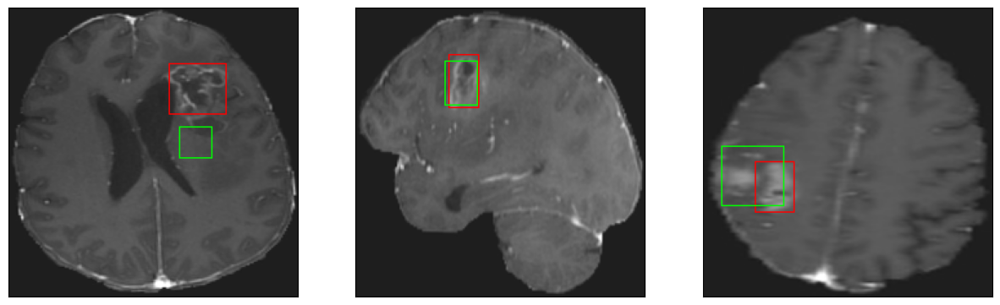

26/26 [==============================] - 8s 308ms/step - loss: 5.5261 - IoU: 0.5713 - val_loss: 8.3967 - val_IoU: 0.5117
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 5.3809 - IoU: 0.5974
Epoch 166: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


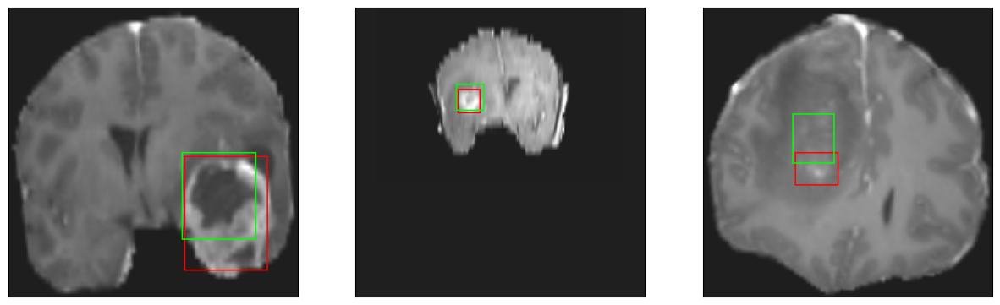

26/26 [==============================] - 8s 306ms/step - loss: 5.3809 - IoU: 0.5974 - val_loss: 8.0209 - val_IoU: 0.5325
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 5.6276 - IoU: 0.5761
Epoch 167: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


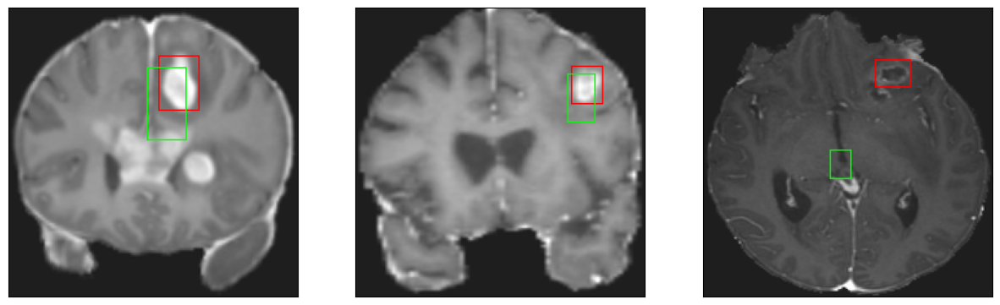

26/26 [==============================] - 7s 285ms/step - loss: 5.6276 - IoU: 0.5761 - val_loss: 8.1922 - val_IoU: 0.5354
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 5.7067 - IoU: 0.5627
Epoch 168: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


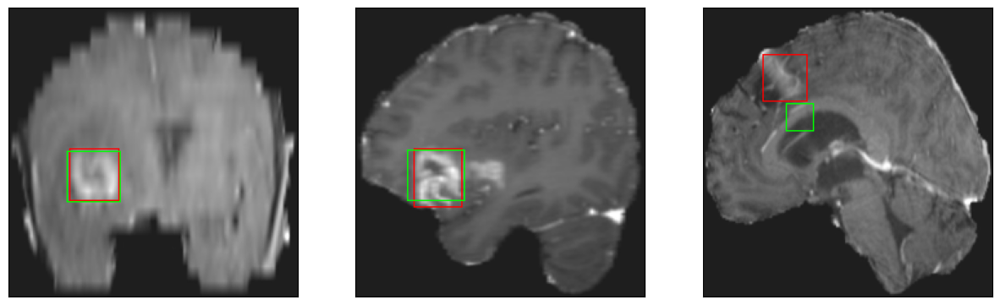

26/26 [==============================] - 8s 303ms/step - loss: 5.7067 - IoU: 0.5627 - val_loss: 8.8804 - val_IoU: 0.4858
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 5.4318 - IoU: 0.5847
Epoch 169: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


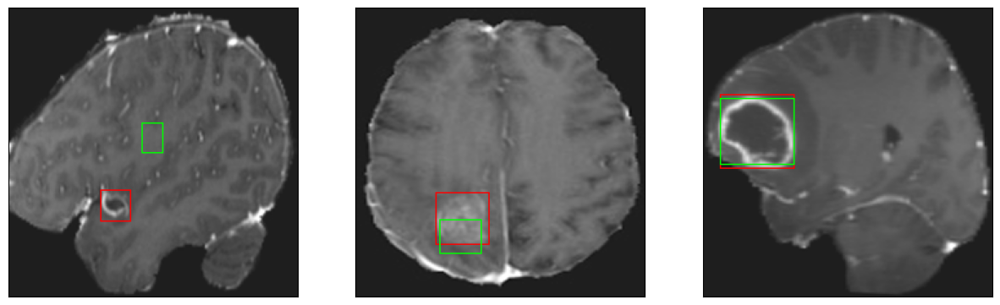

26/26 [==============================] - 8s 305ms/step - loss: 5.4318 - IoU: 0.5847 - val_loss: 9.0849 - val_IoU: 0.4768
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 5.1900 - IoU: 0.5921
Epoch 170: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


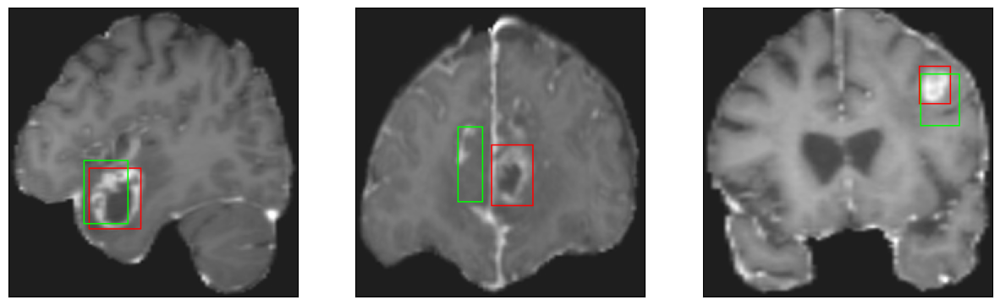

26/26 [==============================] - 8s 296ms/step - loss: 5.1900 - IoU: 0.5921 - val_loss: 8.4013 - val_IoU: 0.5116
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 5.5165 - IoU: 0.5790
Epoch 171: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


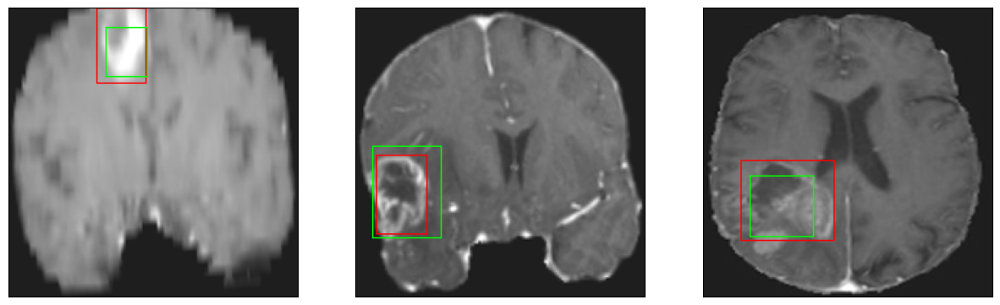

26/26 [==============================] - 8s 303ms/step - loss: 5.5165 - IoU: 0.5790 - val_loss: 7.9825 - val_IoU: 0.5321
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 5.0355 - IoU: 0.6100
Epoch 172: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


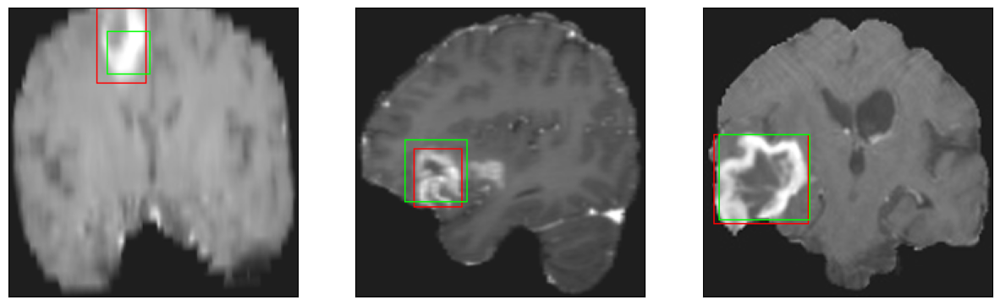

26/26 [==============================] - 7s 279ms/step - loss: 5.0355 - IoU: 0.6100 - val_loss: 8.2272 - val_IoU: 0.5268
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 5.4179 - IoU: 0.5841
Epoch 173: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


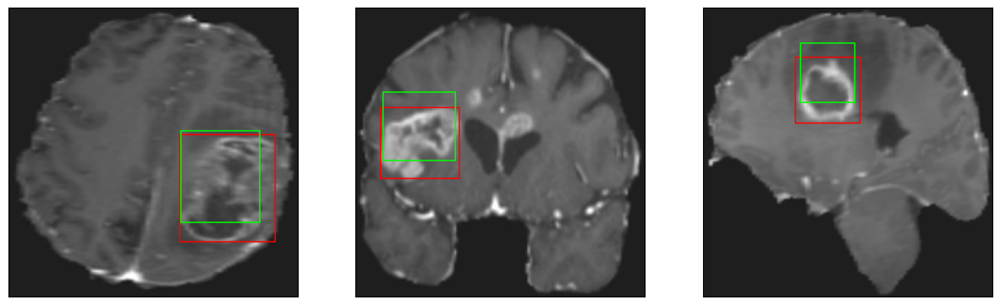

26/26 [==============================] - 8s 328ms/step - loss: 5.4179 - IoU: 0.5841 - val_loss: 8.3592 - val_IoU: 0.4928
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 5.1527 - IoU: 0.6043
Epoch 174: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


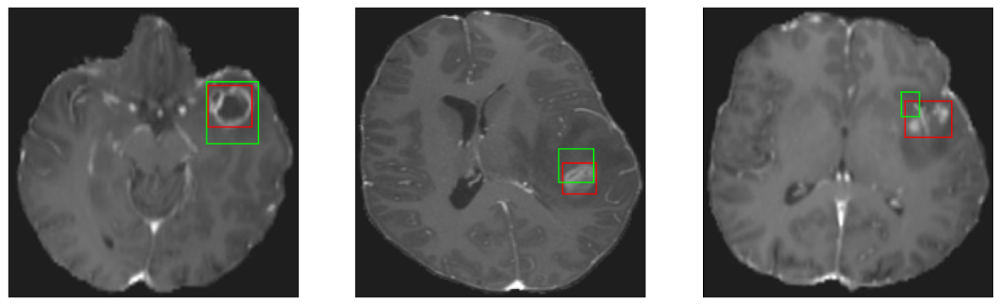

26/26 [==============================] - 7s 280ms/step - loss: 5.1527 - IoU: 0.6043 - val_loss: 9.0249 - val_IoU: 0.4798
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 5.3224 - IoU: 0.5979
Epoch 175: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


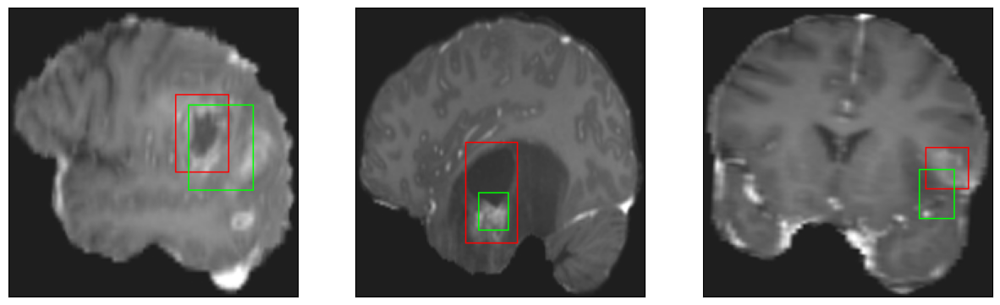

26/26 [==============================] - 8s 307ms/step - loss: 5.3224 - IoU: 0.5979 - val_loss: 9.0836 - val_IoU: 0.4838
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 5.3729 - IoU: 0.5978
Epoch 176: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


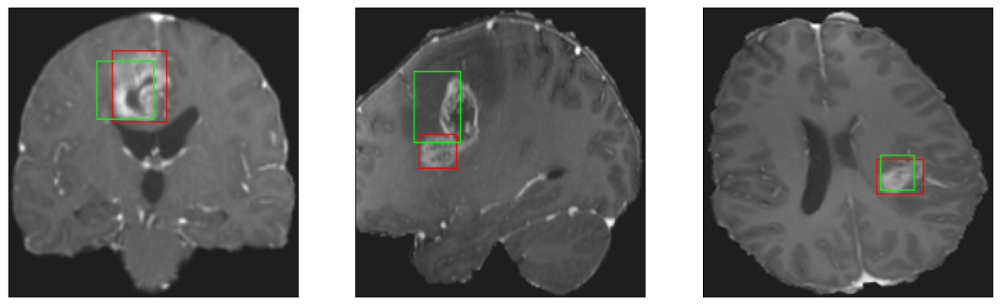

26/26 [==============================] - 8s 313ms/step - loss: 5.3729 - IoU: 0.5978 - val_loss: 8.5567 - val_IoU: 0.4944
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 5.3163 - IoU: 0.5950
Epoch 177: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


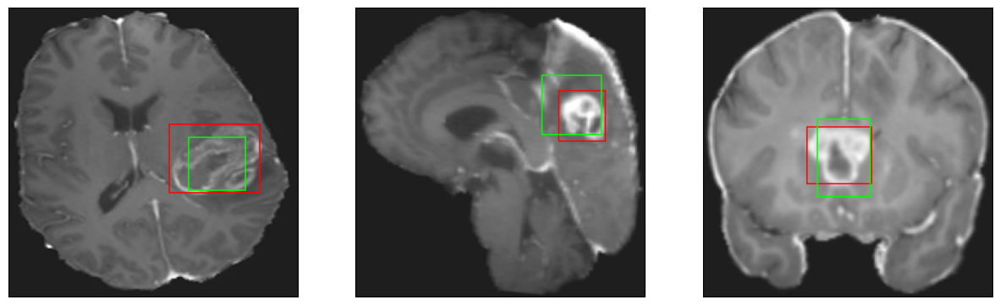

26/26 [==============================] - 8s 318ms/step - loss: 5.3163 - IoU: 0.5950 - val_loss: 8.2269 - val_IoU: 0.5280
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 5.4104 - IoU: 0.5921
Epoch 178: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


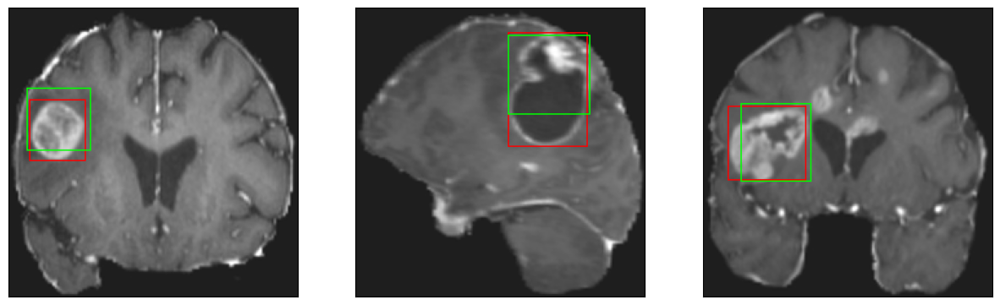

26/26 [==============================] - 8s 304ms/step - loss: 5.4104 - IoU: 0.5921 - val_loss: 8.4304 - val_IoU: 0.5041
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 5.3427 - IoU: 0.5948
Epoch 179: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


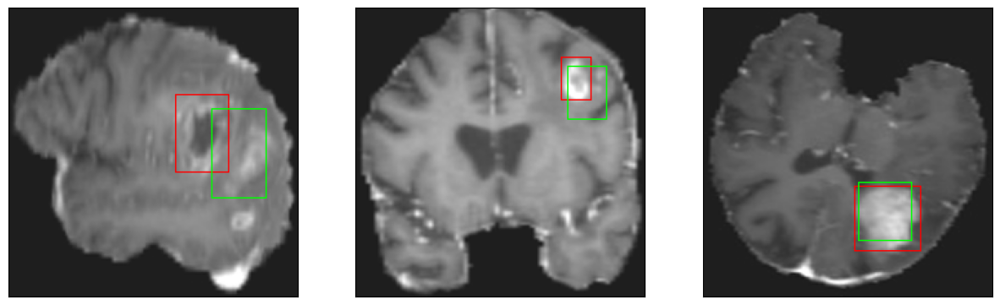

26/26 [==============================] - 8s 306ms/step - loss: 5.3427 - IoU: 0.5948 - val_loss: 8.2269 - val_IoU: 0.5309
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 5.0193 - IoU: 0.6075
Epoch 180: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


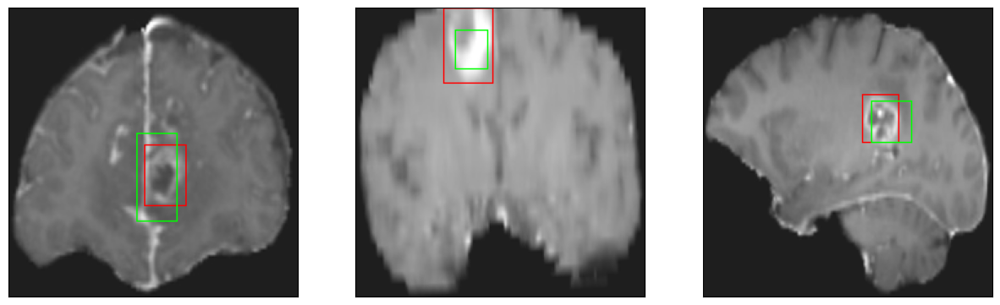

26/26 [==============================] - 7s 282ms/step - loss: 5.0193 - IoU: 0.6075 - val_loss: 8.3383 - val_IoU: 0.5217
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 5.0447 - IoU: 0.6093
Epoch 181: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


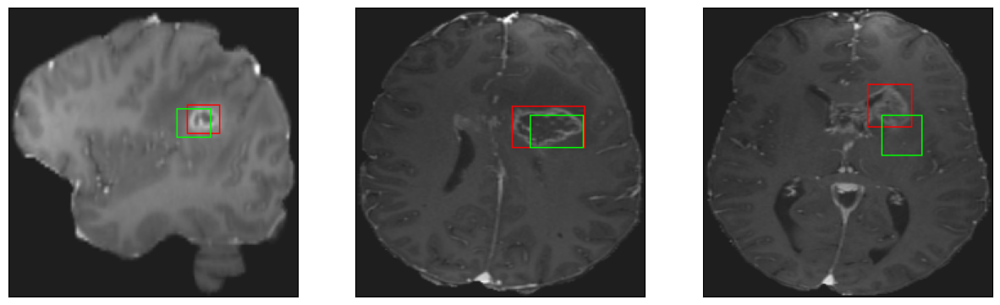

26/26 [==============================] - 8s 317ms/step - loss: 5.0447 - IoU: 0.6093 - val_loss: 8.2827 - val_IoU: 0.5295
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 5.4493 - IoU: 0.5837
Epoch 182: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


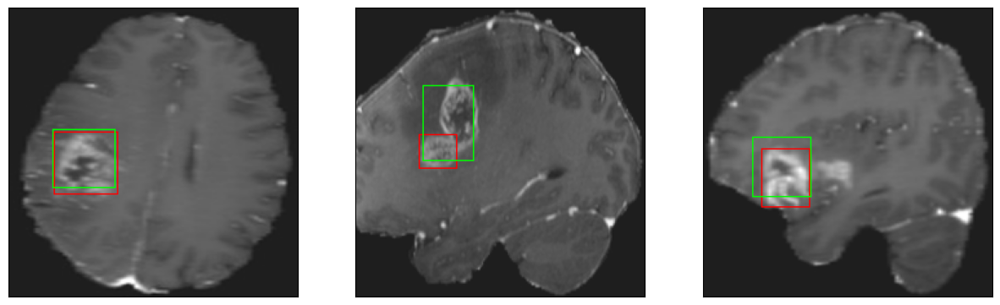

26/26 [==============================] - 8s 326ms/step - loss: 5.4493 - IoU: 0.5837 - val_loss: 8.1646 - val_IoU: 0.5238
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 5.2445 - IoU: 0.6006
Epoch 183: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


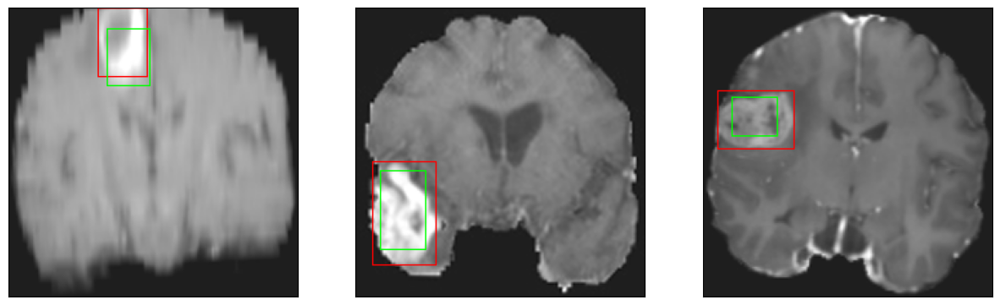

26/26 [==============================] - 8s 305ms/step - loss: 5.2445 - IoU: 0.6006 - val_loss: 8.6905 - val_IoU: 0.5039
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 5.1216 - IoU: 0.6019
Epoch 184: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


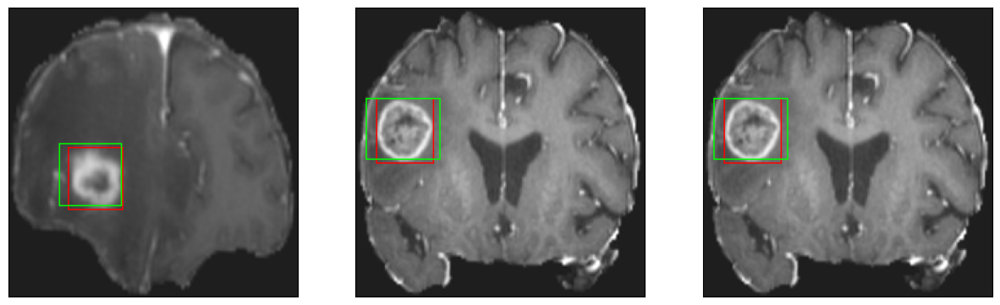

26/26 [==============================] - 8s 292ms/step - loss: 5.1216 - IoU: 0.6019 - val_loss: 9.0562 - val_IoU: 0.5016
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 5.1417 - IoU: 0.6008
Epoch 185: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


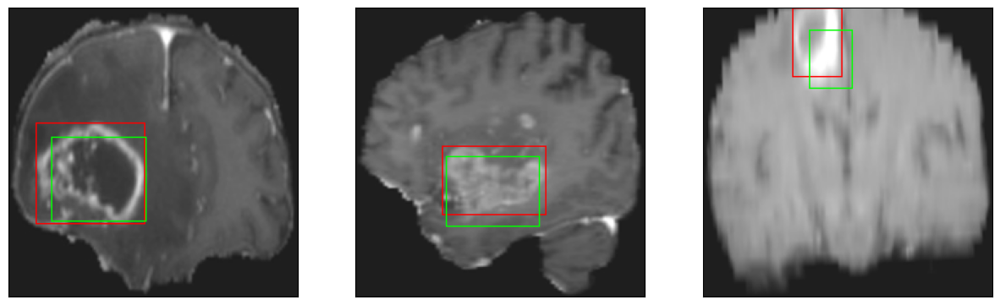

26/26 [==============================] - 7s 283ms/step - loss: 5.1417 - IoU: 0.6008 - val_loss: 8.3449 - val_IoU: 0.5132
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 5.2484 - IoU: 0.5929
Epoch 186: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4


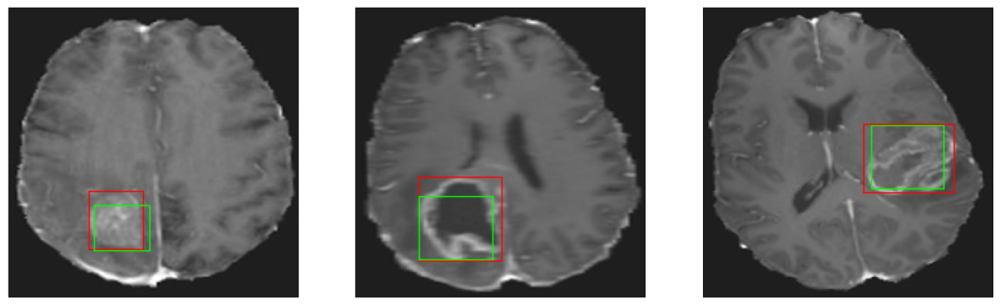

26/26 [==============================] - 8s 317ms/step - loss: 5.2484 - IoU: 0.5929 - val_loss: 8.2840 - val_IoU: 0.4993
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 5.4034 - IoU: 0.5825
Epoch 187: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


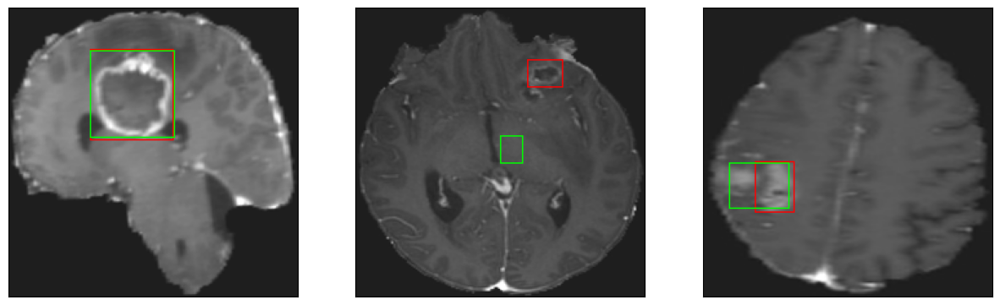

26/26 [==============================] - 8s 317ms/step - loss: 5.4034 - IoU: 0.5825 - val_loss: 7.9860 - val_IoU: 0.5314
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 5.3486 - IoU: 0.5917
Epoch 188: val_IoU did not improve from 0.54999
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


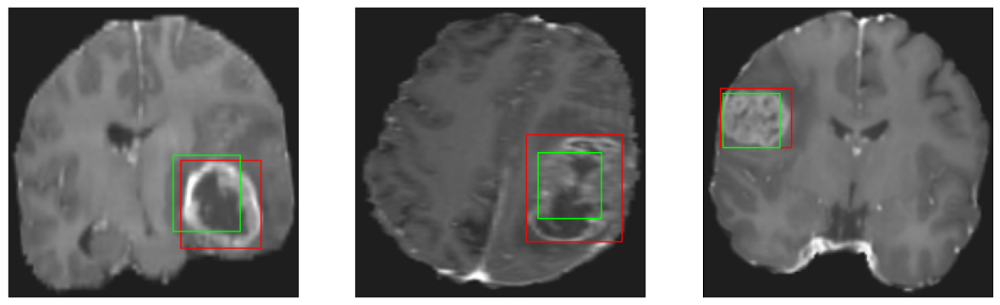

26/26 [==============================] - 8s 298ms/step - loss: 5.3486 - IoU: 0.5917 - val_loss: 9.6928 - val_IoU: 0.4322
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 5.3244 - IoU: 0.5900
Epoch 189: val_IoU improved from 0.54999 to 0.56870, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4


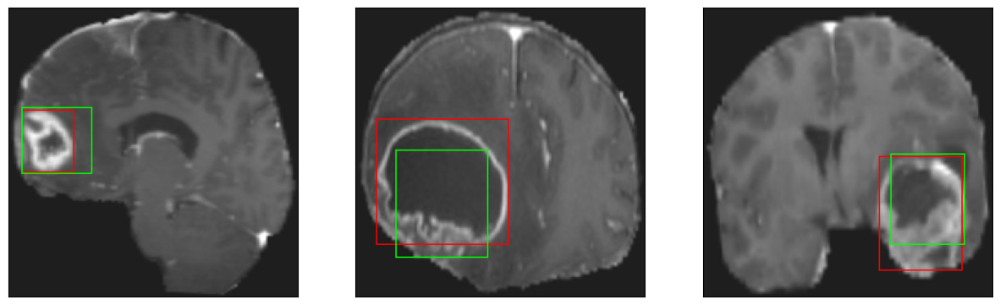

26/26 [==============================] - 24s 967ms/step - loss: 5.3244 - IoU: 0.5900 - val_loss: 7.3951 - val_IoU: 0.5687
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 5.4379 - IoU: 0.5813
Epoch 190: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4


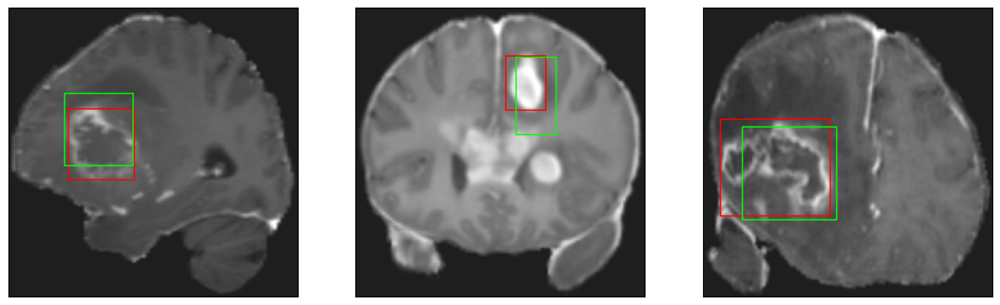

26/26 [==============================] - 8s 317ms/step - loss: 5.4379 - IoU: 0.5813 - val_loss: 8.4455 - val_IoU: 0.5052
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 5.3669 - IoU: 0.5956
Epoch 191: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


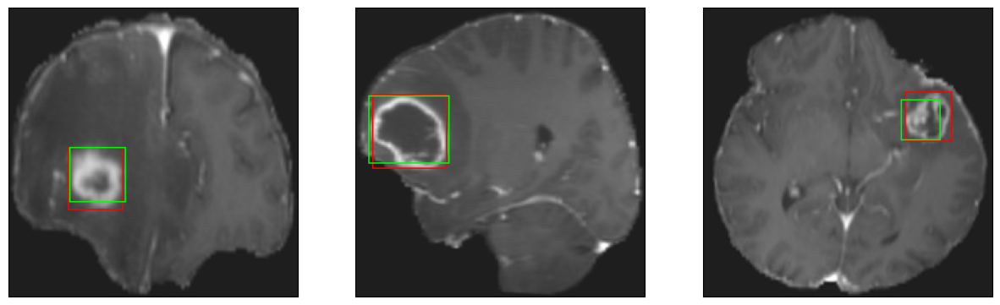

26/26 [==============================] - 8s 303ms/step - loss: 5.3669 - IoU: 0.5956 - val_loss: 7.7048 - val_IoU: 0.5487
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 5.1247 - IoU: 0.6072
Epoch 192: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


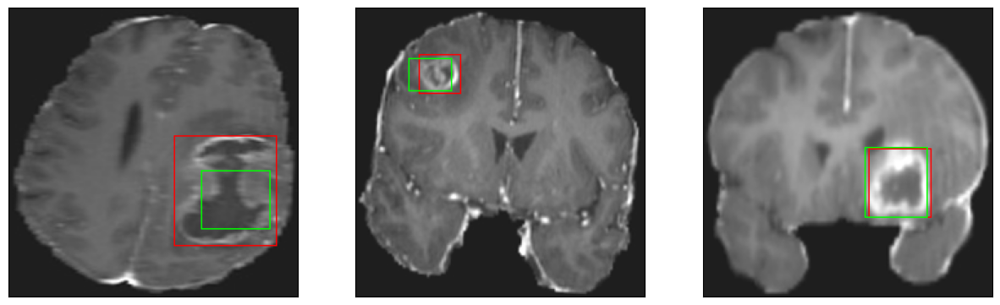

26/26 [==============================] - 7s 279ms/step - loss: 5.1247 - IoU: 0.6072 - val_loss: 8.4374 - val_IoU: 0.5154
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 5.1782 - IoU: 0.5929
Epoch 193: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


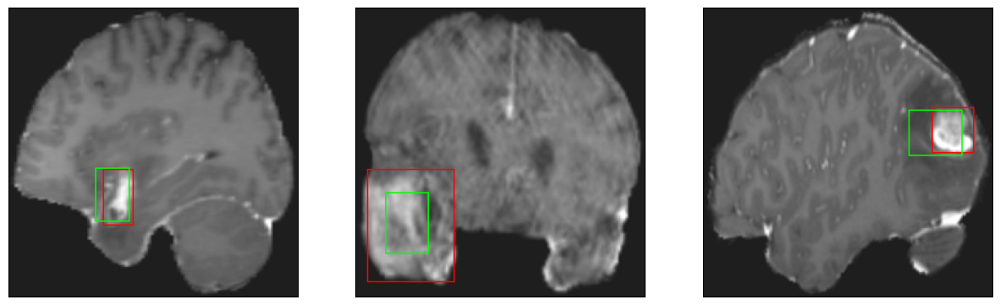

26/26 [==============================] - 8s 307ms/step - loss: 5.1782 - IoU: 0.5929 - val_loss: 8.4825 - val_IoU: 0.5049
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 5.3385 - IoU: 0.5848
Epoch 194: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


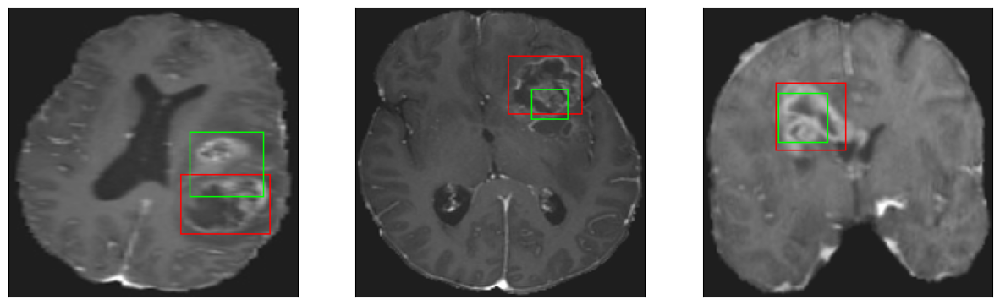

26/26 [==============================] - 8s 310ms/step - loss: 5.3385 - IoU: 0.5848 - val_loss: 8.8366 - val_IoU: 0.4738
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 5.1895 - IoU: 0.6095
Epoch 195: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


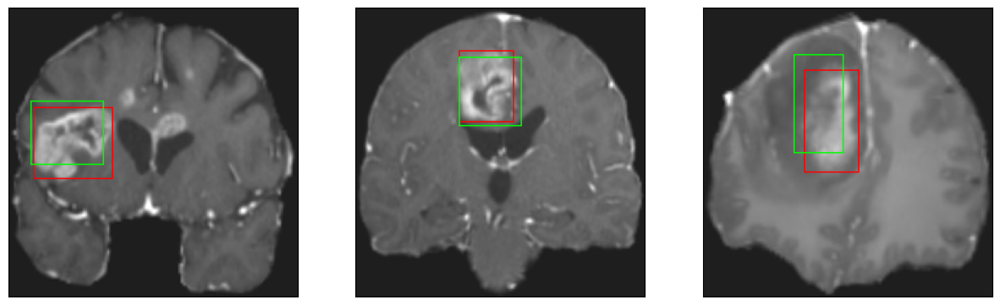

26/26 [==============================] - 8s 307ms/step - loss: 5.1895 - IoU: 0.6095 - val_loss: 7.9159 - val_IoU: 0.5273
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 5.0090 - IoU: 0.6122
Epoch 196: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


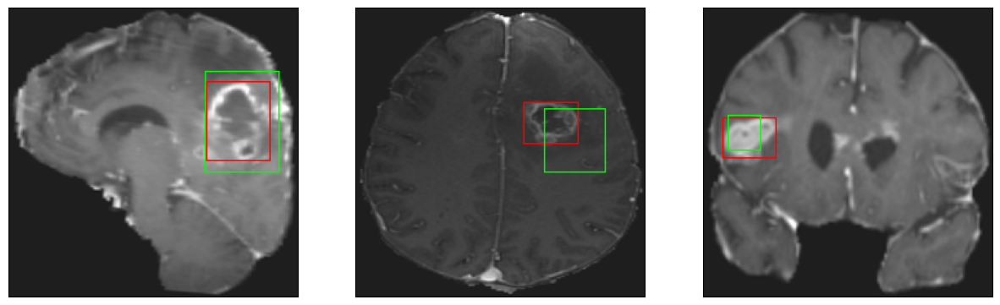

26/26 [==============================] - 8s 298ms/step - loss: 5.0090 - IoU: 0.6122 - val_loss: 7.6571 - val_IoU: 0.5563
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 5.1629 - IoU: 0.6072
Epoch 197: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


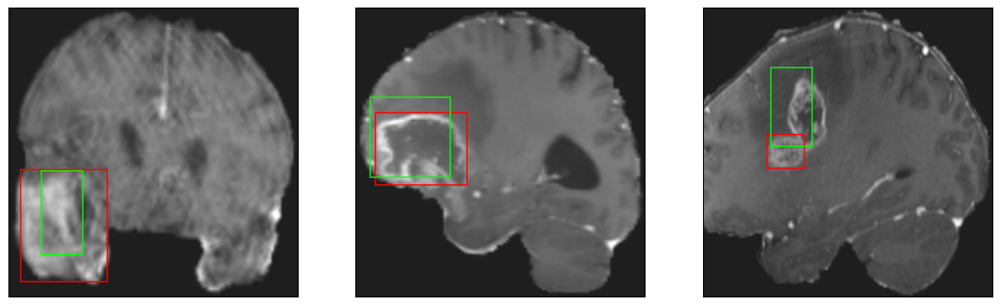

26/26 [==============================] - 7s 281ms/step - loss: 5.1629 - IoU: 0.6072 - val_loss: 8.5070 - val_IoU: 0.5182
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 5.0147 - IoU: 0.6082
Epoch 198: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


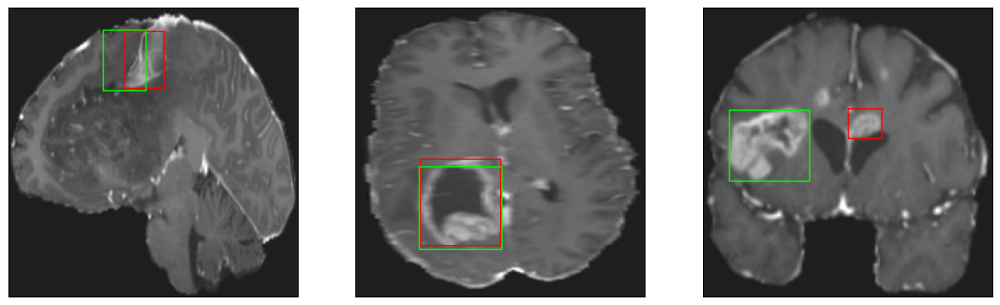

26/26 [==============================] - 7s 280ms/step - loss: 5.0147 - IoU: 0.6082 - val_loss: 7.8540 - val_IoU: 0.5430
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 5.2150 - IoU: 0.5950
Epoch 199: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


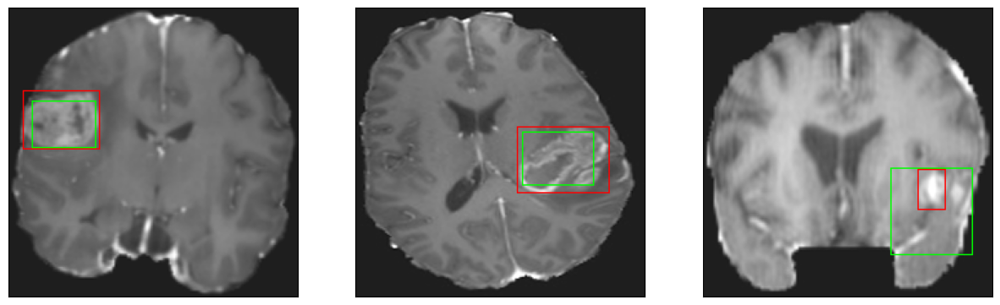

26/26 [==============================] - 8s 309ms/step - loss: 5.2150 - IoU: 0.5950 - val_loss: 8.4671 - val_IoU: 0.5002
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 4.9756 - IoU: 0.6148
Epoch 200: val_IoU did not improve from 0.56870
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


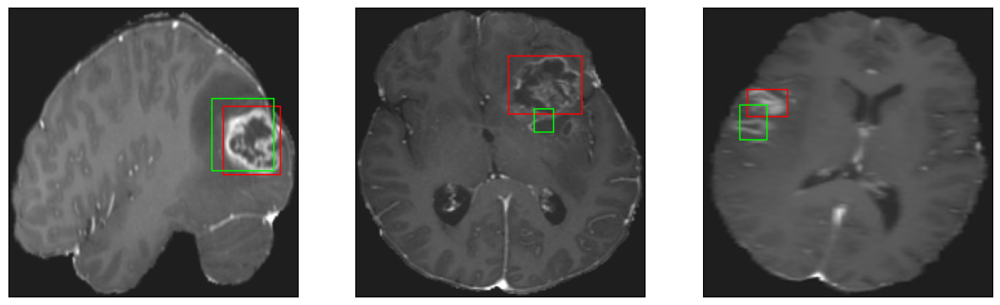

26/26 [==============================] - 8s 304ms/step - loss: 4.9756 - IoU: 0.6148 - val_loss: 8.3870 - val_IoU: 0.5198


In [25]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

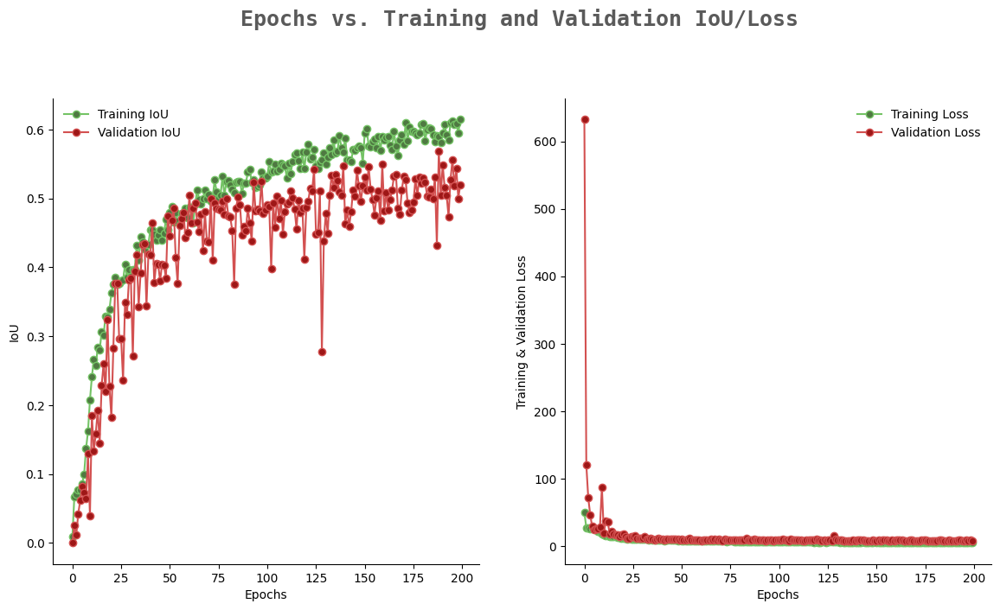

In [26]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [27]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [28]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [29]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 61ms/step - loss: 9.1412 - IoU: 0.4921


[9.141216278076172, 0.49208444356918335]